# Libraries, figure parameters and custom functions

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import anndata as ann
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib import rcParams
#from gprofiler import gprofiler
import os
#import custom_functions as cf 
from sklearn.linear_model import LinearRegression

Add date.

In [2]:
from datetime import date

In [3]:
today = date.today().strftime("%y%m%d")

Add my color scheme.

In [4]:
colors2 = plt.cm.RdYlBu_r(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(0.7)
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

Set parameters for plots in scanpy

In [5]:
sc.settings.set_figure_params(dpi=80)

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=True, vector_friendly=True,
                     color_map='viridis', format='pdf', transparent=False,
                     ipython_format='png2x')

In [6]:
def cell_compo_table(adata, cluster, condition, xlabel='cell cluster',
                        ylabel='cell count', title=None, save=False):
    """
    """
    

    contingency_table = pd.crosstab(
        adata.obs[condition],
        adata.obs[cluster],
        margins = True
    )
    return(contingency_table)

def top_marker_as_xlsx(adata, key_rank_genes, key_groups, output_file):
    
    print(adata.uns[key_rank_genes].keys())
    dict_genes = adata.uns[key_rank_genes].copy()
    print(dict_genes['params'])
    del dict_genes['params']
    clusters = sorted(list(set(adata.obs[key_groups])))*len(dict_genes['scores'])
    for key, value in dict_genes.items():
        tmp_list = []
        for n in value:
            tmp_list = tmp_list + list(n)
        dict_genes[key] = tmp_list
    
    dict_genes['cluster'] = clusters

    dataframe = pd.DataFrame(dict_genes)
    dataframe.to_excel(output_file)
    return(dataframe)

# Load data

In [7]:
project_dir = '/storage/groups/ml01/workspace/maren.buettner/Martinez_Liver_HPC/'

In [21]:
data_dir = project_dir + 'data/'
table_dir = project_dir + 'tables/'

In [9]:
adata_wt_young = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_cells_filtered_TPM_jul21_annotated.h5ad')
adata_wt_old = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_cells_filtered_TPM_jul21_annotated.h5ad')

In [10]:
adata_young_HNF4 = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_HNF4-KO_filtered_TPM_jul21_annotated.h5ad')
adata_old_HNF4 = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_HNF4-KO_filtered_TPM_jul21_annotated.h5ad')
adata_young_CTCF = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_CTCF-KO_filtered_TPM_jul21_annotated.h5ad')
adata_old_CTCF = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_CTCF-KO_filtered_TPM_jul21_annotated.h5ad' )
adata_young_CEBPA = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_CEBPA-KO_filtered_TPM_jul21_annotated.h5ad')
adata_old_CEBPA = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_CEBPA-KO_filtered_TPM_jul21_annotated.h5ad')

We merge `adata_young` and `adata_old` in order to use the separately created cell type annotation.

In [11]:
adata_all = ann.concat([adata_wt_young, adata_wt_old, 
                        adata_young_HNF4, adata_old_HNF4,
                        adata_young_CTCF, adata_old_CTCF,
                        adata_young_CEBPA, adata_old_CEBPA,
                       ], index_unique=None)

In [12]:
adata_all.uns = adata_wt_young.uns
adata_all.varm = adata_wt_young.varm
adata_all.var['gene_name'] = adata_wt_young.var['gene_name']

Add covariate combining age and ploidy.

In [13]:
age_ploidy = [adata_all.obs['age_grouped'][idx] + ' ' + adata_all.obs['ploidy'][idx] for idx in range(adata_all.n_obs)]

In [14]:
adata_all.obs['age_ploidy'] = pd.Categorical(age_ploidy, categories=['young 2n', 'young 4n', 'old 2n', 'old 4n'])

Add strain information to the age and ploidy covariate.

In [15]:
strain_age_ploidy = [adata_all.obs['strain'][idx] + ' ' + 
                     adata_all.obs['age_grouped'][idx] + ' ' + 
                     adata_all.obs['ploidy'][idx] for idx in range(adata_all.n_obs)]

In [16]:
adata_all.obs['strain_age_ploidy'] = pd.Categorical(strain_age_ploidy, 
                                categories=['C57Bl6/J young 2n', 'C57Bl6/J young 4n', 
                                            'C57Bl6/J old 2n', 'C57Bl6/J old 4n',
                                            'HNF4 KO young 2n', 'HNF4 KO young 4n', 
                                            'HNF4 KO old 2n', 'HNF4 KO old 4n',
                                            'CEBPA KO young 2n', 'CEBPA KO young 4n', 
                                            'CEBPA KO old 2n', 'CEBPA KO old 4n',
                                            'CTCF KO young 2n', 'CTCF KO young 4n', 
                                            'CTCF KO old 2n', 'CTCF KO old 4n'
                                           ])

Add strain and age info as covariate.

In [17]:
strain_age = [adata_all.obs['strain'][idx] + ' ' + 
              adata_all.obs['age_grouped'][idx] for idx in range(adata_all.n_obs)]

In [18]:
adata_all.obs['strain_age'] = pd.Categorical(strain_age, 
                                categories=['C57Bl6/J young', 
                                            'C57Bl6/J old', 
                                            'HNF4 KO young', 
                                            'HNF4 KO old',
                                            'CEBPA KO young',
                                            'CEBPA KO old',
                                            'CTCF KO young',
                                            'CTCF KO old', 
                                           ])

Edit the raw object to use the gene symbols for plotting (e.g. in `stacked_violin` plot).

In [19]:
adata_all.raw.var['gene_name'] = adata_wt_young.var['gene_name']

Read zonation marker gene list.

In [22]:
zonation_marker = pd.read_csv(table_dir + 'zonation_markers_new.txt')

In [23]:
zonation_marker.shape

(1239, 1)

Read important genes for differences in hepatocyte KO metabolism.

In [27]:
metab_marker = pd.read_table(table_dir + 'Gene_list_070521.csv', index_col=0, sep=';')

Convert table into a dictionary.

In [28]:
metab_marker['Annotation'] = metab_marker['Annotation'].astype('category')

Drop all unexpressed genes.

In [29]:
metab_marker.drop(index = metab_marker.index[~metab_marker.index.isin(adata_all.raw.var['gene_name'])], 
                  inplace=True)

In [30]:
metab_marker['Annotation'].cat.categories

Index(['Alcohol', 'CV', 'Controlled inflam', 'Endosome', 'Gluconeogenesis',
       'Glucose', 'Glycolysis', 'Immunsurv', 'Iron', 'Lipid', 'Middle', 'PV',
       'Urea', 'structure'],
      dtype='object')

In [31]:
metab_dict = {}
for metab_key in metab_marker['Annotation'].cat.categories:
    metab_dict[metab_key] = list(metab_marker[metab_marker['Annotation']==metab_key].index.values)

Read in gluconeogenesis and lipolysis gene list.

In [32]:
gluco_marker = pd.read_table(table_dir + "Glycolysis vs gluconeo.csv", index_col =0, sep=';')

Convert table into a dictionary.

In [33]:
gluco_marker['Annotation'] = gluco_marker['Annotation'].astype('category')

Drop all unexpressed genes.

In [34]:
gluco_marker.drop(index = gluco_marker.index[~gluco_marker.index.isin(adata_all.raw.var['gene_name'])], 
                  inplace=True)

In [35]:
gluco_marker['Annotation'].cat.categories

Index(['Gluconeogenesis', 'Glycolysis/lipolysis'], dtype='object')

In [36]:
gluco_dict = {}
for gluco_key in gluco_marker['Annotation'].cat.categories:
    gluco_dict[gluco_key] = list(gluco_marker[gluco_marker['Annotation']==gluco_key].index.values)

We use the list for gluconeogenesis and glycolysis/lipolysis to create gene scores for every hepatocyte subpopulation.

In [37]:
for gluco_key in gluco_marker['Annotation'].cat.categories:
    gene_names = adata_all.raw.var_names[adata_all.raw.var['gene_name'].isin(gluco_dict[gluco_key])]
    sc.tl.score_genes(adata_all, gene_list = gene_names,
                      score_name = 'score_' + gluco_key
                     )

Load gene sets for inflammatory GO terms.

In [38]:
files = os.listdir(table_dir)
file_GO = [fileID for fileID in files if fileID.startswith('210512_GO')]

In [48]:
GO_inflammation_dict = {}
for fileID in file_GO:
    tmp_name = fileID.split('.csv')[0].split('_')[1]
    GO_inflammation_dict[tmp_name] = list(pd.read_csv(table_dir + fileID, index_col=0).index.values)

Create inflammation score.

In [49]:
for infla_key in GO_inflammation_dict.keys():
    gene_names = adata_all.raw.var_names[adata_all.raw.var['gene_name'].isin(GO_inflammation_dict[infla_key])]
    sc.tl.score_genes(adata_all, gene_list = gene_names,
                      score_name = 'score_' + infla_key
                     )

Read list of hand-picked genes for visualising the subgroups of hepatocytes (date: 19th July 2021):

In [50]:
marker_genes_DE = pd.read_table(table_dir + 'Heatmap_all_strains.csv', sep = ';')

In [51]:
marker_genes_DE['Annotation'] = marker_genes_DE['Annotation'].astype('category')

In [52]:
marker_DE_dict = {}
for m_key in ['young', 'old']:
    marker_DE_dict[m_key] = list(marker_genes_DE[marker_genes_DE['Annotation']==m_key]['Genes'].values)

# Introduction

In this notebook, we perform a set of advanced analyses of the hepatocyte population.

0. Inpromptu request to visualise gene sets.
1. Visualise relevant gene sets for hepatocytes.
2. Visualise relevant and significantly different gene sets for hepatocytes.
3. Correlation analysis of the KO vs WT (separately by age)
4. Correlation analysis of the KO vs WT (separated by age and by 2n/4n)

The variability and zonation pattern analysis can be found in two separate notebooks.

Select hepatocytes.

In [56]:
adata_hep = adata_all[adata_all.obs['cell_type1']=='Hepatocytes'].copy()

In [57]:
adata_hep

AnnData object with n_obs × n_vars = 3969 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_Natural killer', 'score_Lymphocyte', 'score_Hepatoblast', 'score_Endothelial', 'score_Dendritic cell', 'score_B cells', 'score_Cholangiocyte', 'score_Kupffer and Macrophage', 'score_Hepatocyte', 'score_Neutrophil', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1', 'age_ploidy', 'strain_age_ploidy', 'strain_age', 'score_Gluconeogenesis', 'score_Glycolysis/lipolysis', 'score_GO0002544', 'score_GO0090594', 'sc

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


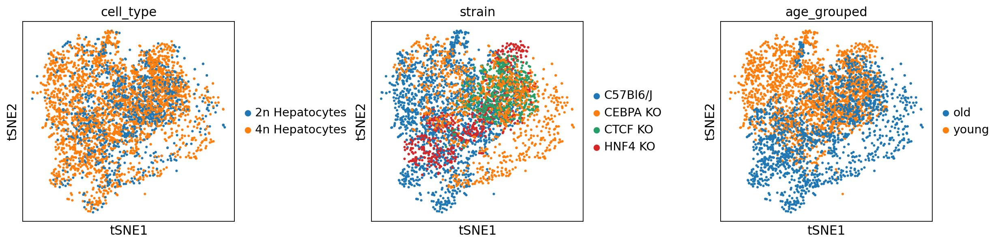

In [59]:
sc.pl.tsne(adata_hep, color=['cell_type', 'strain', 'age_grouped'], wspace=0.5)

# Inpromptu request
Plot some genes of young and old wild type B6 cells in a violin plot.

In [15]:
genes_oi = np.array(['Hmox1','Csf3','Csf2','Il1b','Il3','Il10','Csf1',
            'Thpo','Kit','Tgfb1','Tgfb2','Cxcl12',
            'Ifna1','Ifna2','Erfe','Trf'])

In [16]:
genes_present = genes_oi[np.in1d(genes_oi, adata_wt_young.var['gene_name'])] 

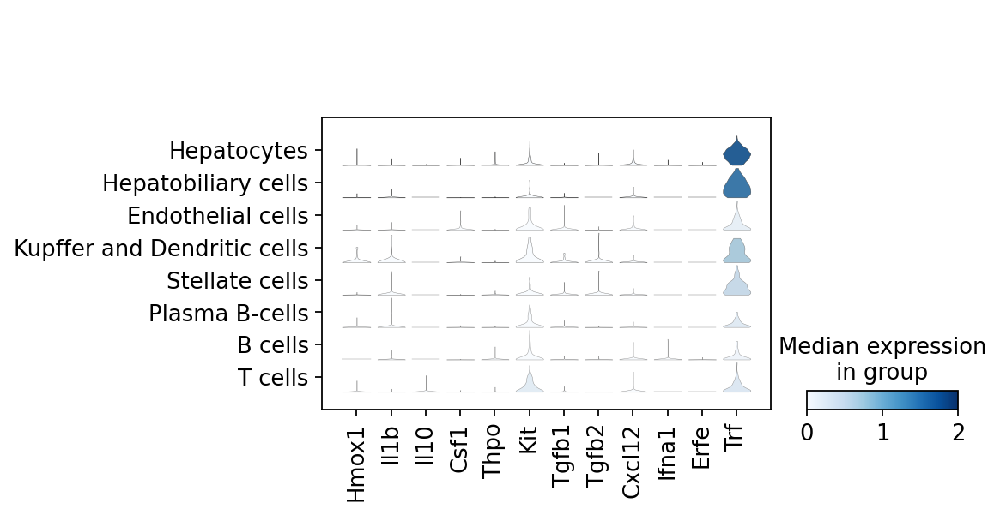

In [17]:
sc.pl.stacked_violin(adata_wt_young,gene_symbols='gene_name', vmax=2,
                     var_names=genes_present, groupby='cell_type1',
                     save=today + '_wt_young_cell-type.pdf'
                    )

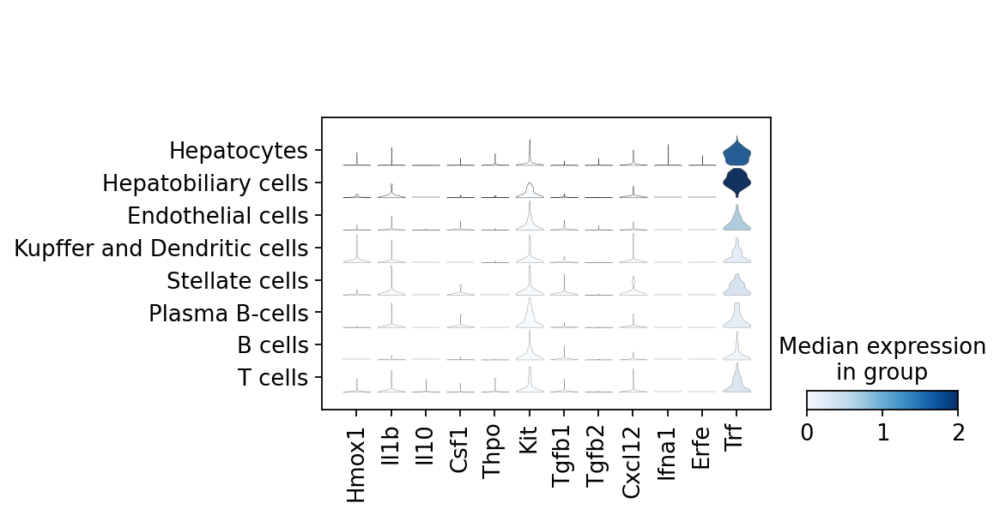

In [18]:
sc.pl.stacked_violin(adata_wt_old,gene_symbols='gene_name', vmax=2,
                     var_names=genes_present, groupby='cell_type1',
                     save=today + '_wt_old_cell-type.pdf'
                    )

## Plot metabolism genes for hepatocytes in all strains and ages

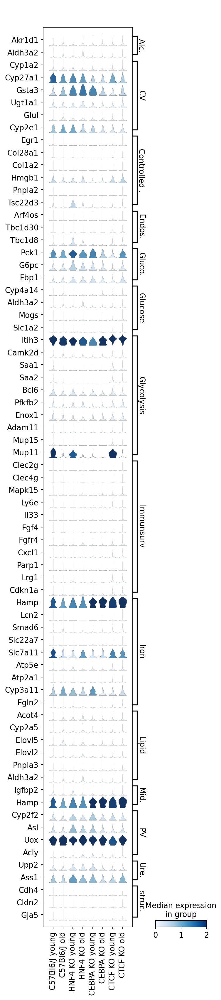

In [75]:
sc.pl.stacked_violin(adata_hep, gene_symbols='gene_name', vmax=2, use_raw=True,
                     var_names=metab_dict, groupby='strain_age', swap_axes=True,
                     save=today + '_metabolism_strain_age.pdf'
                    )

Plot all genes in separate violin plots (batch corrected data).

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


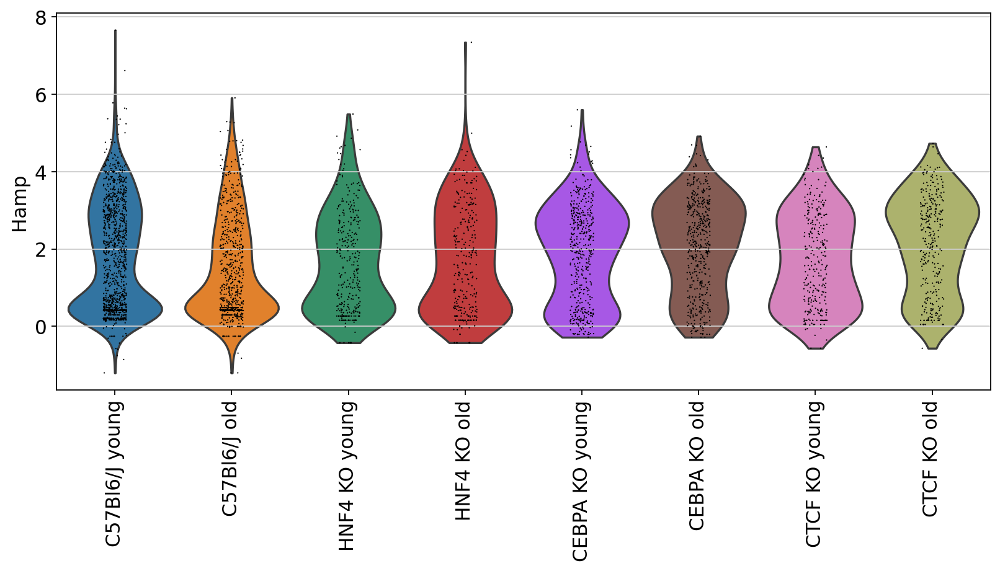

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


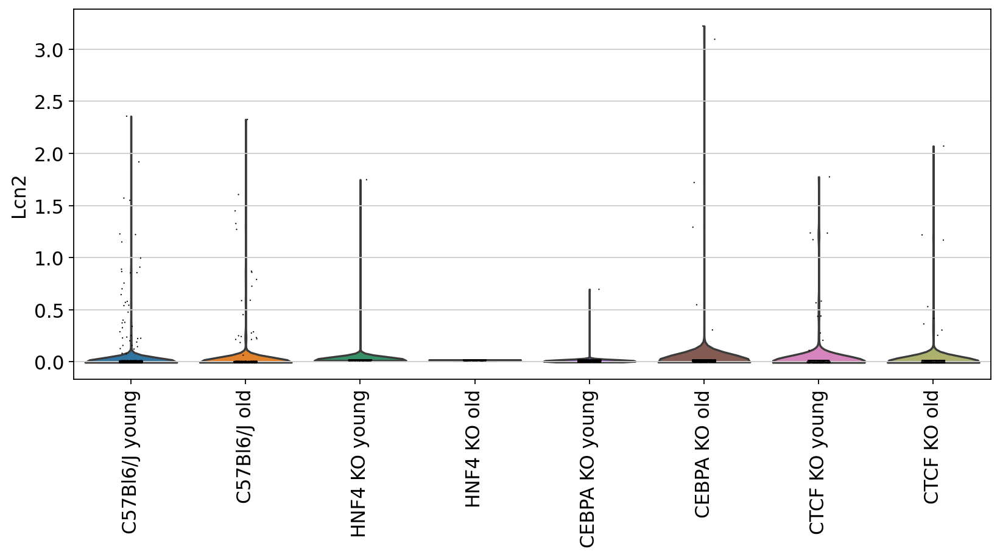

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


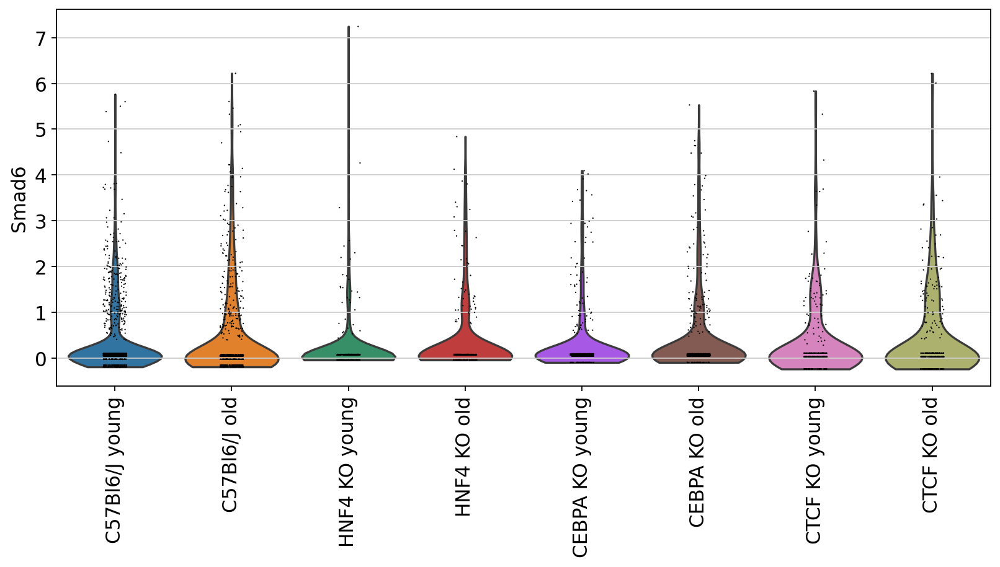

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


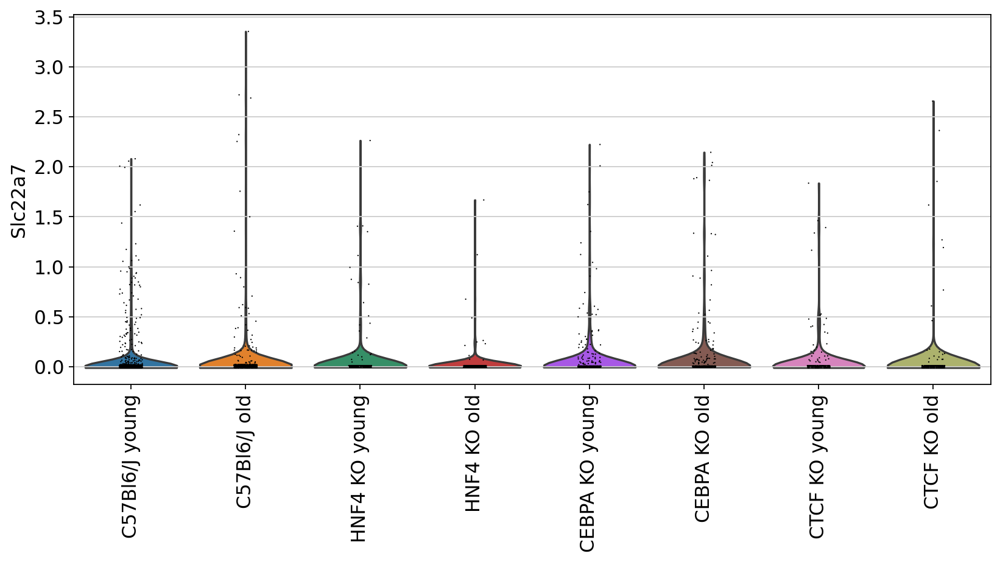

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


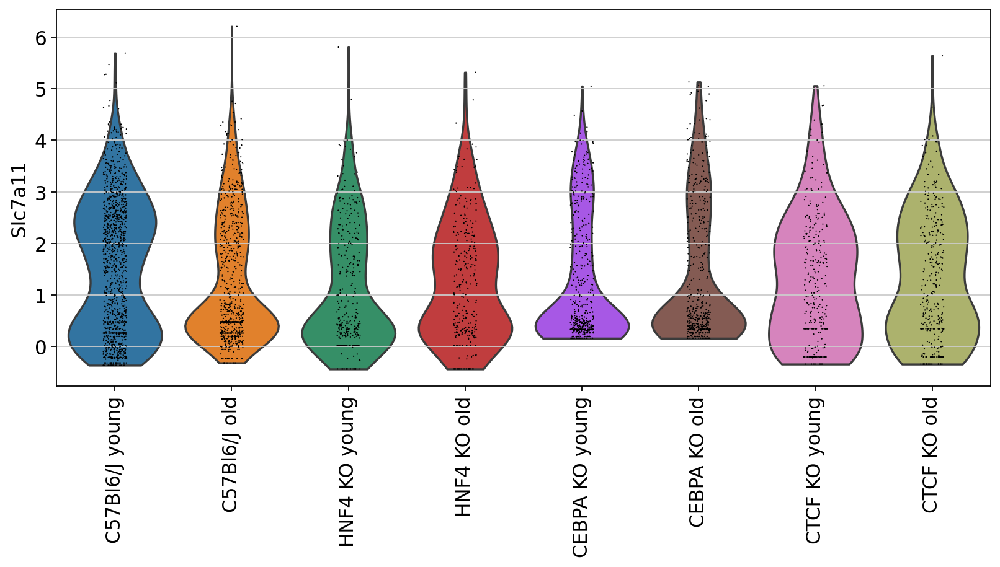

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


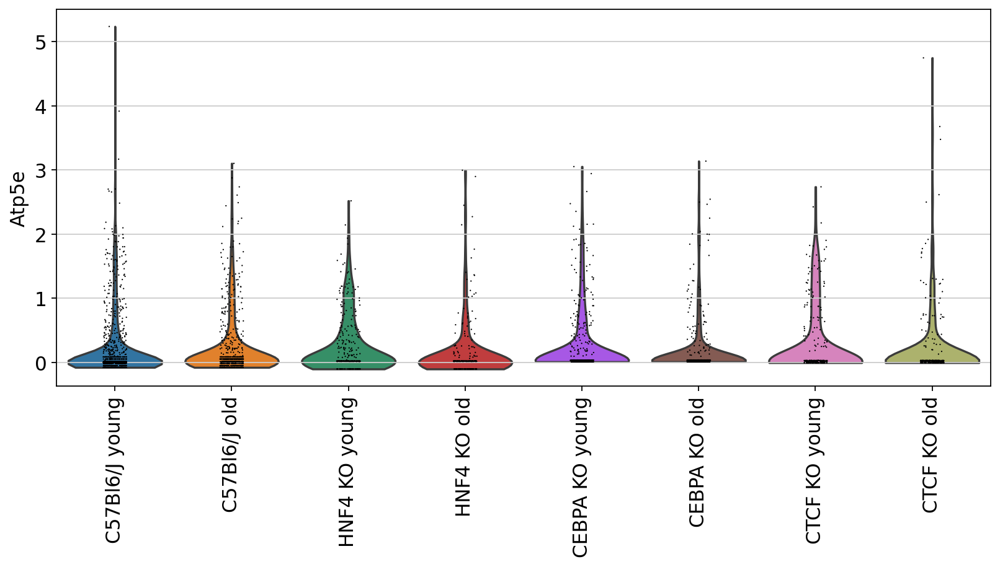

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


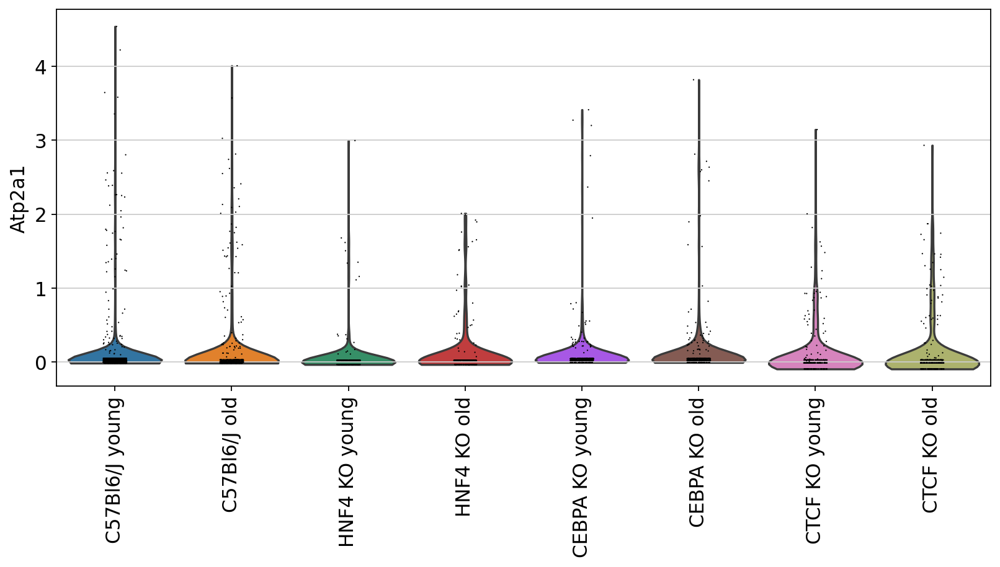

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


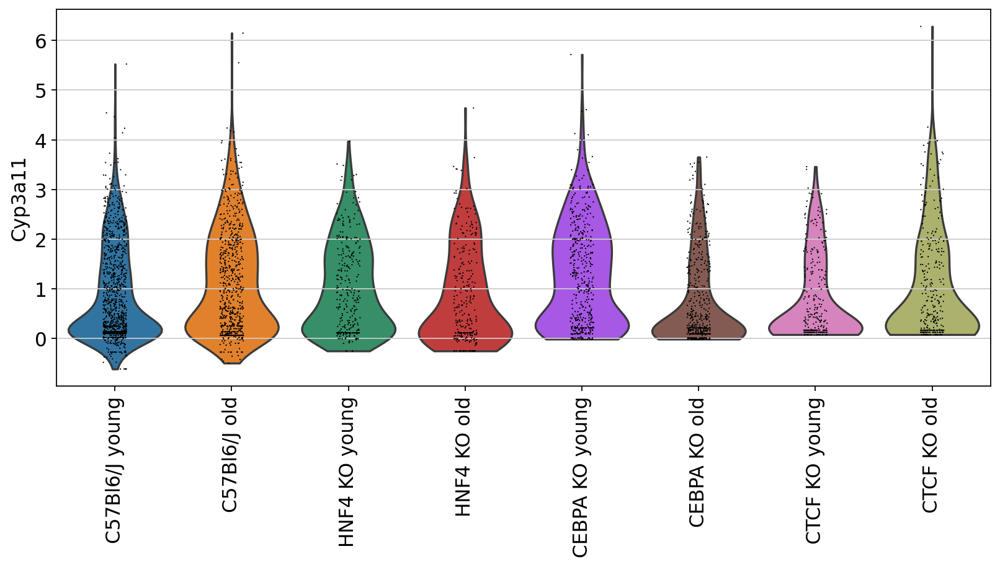

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


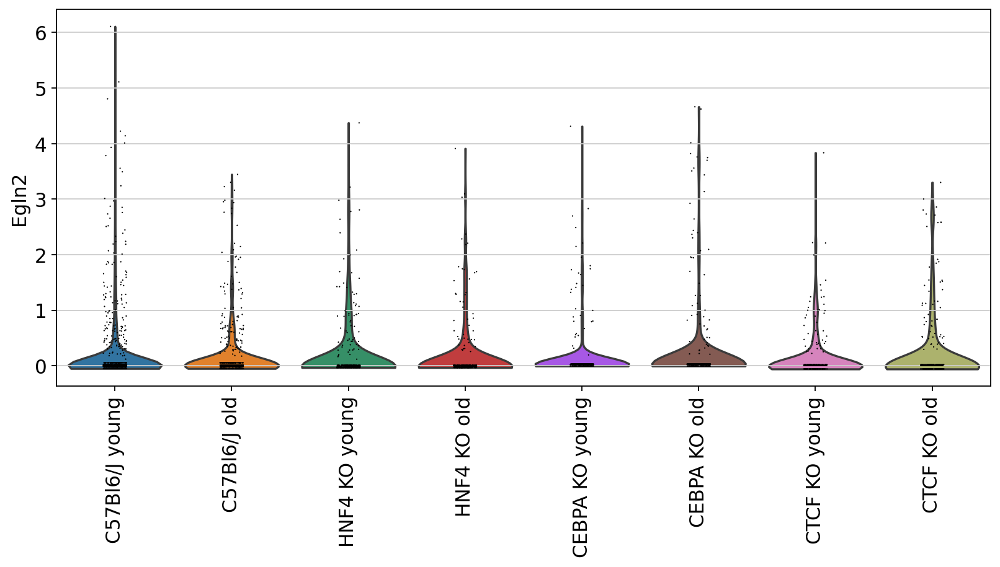

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


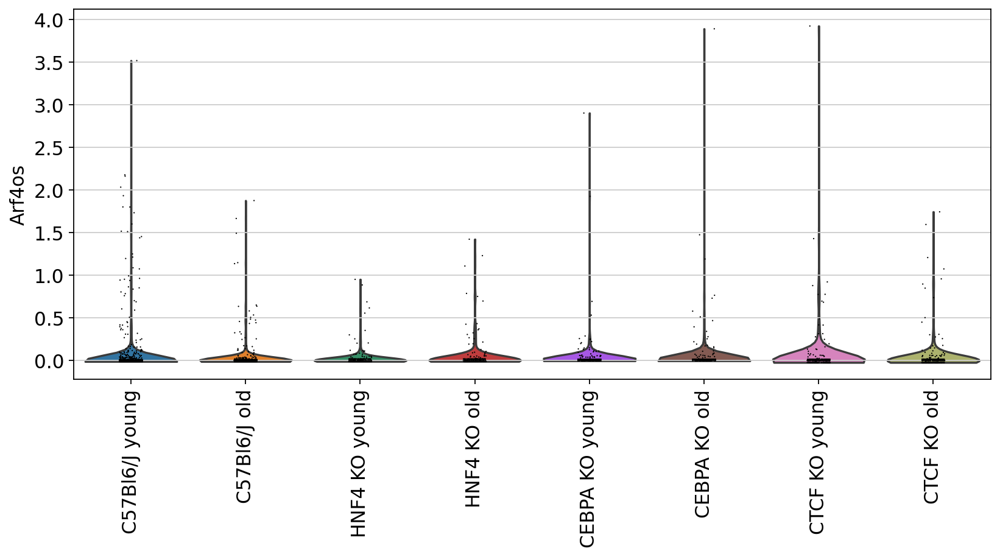

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


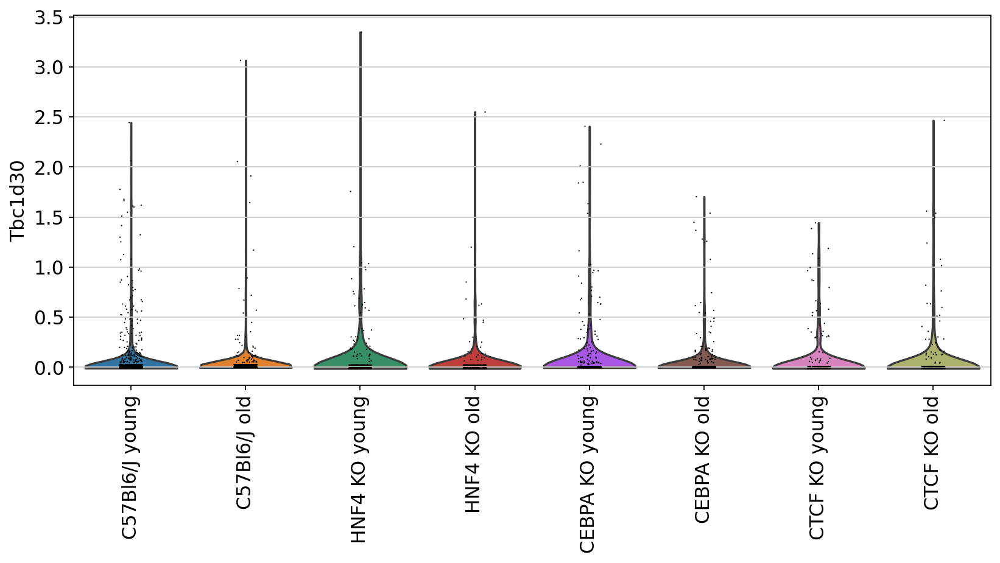

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


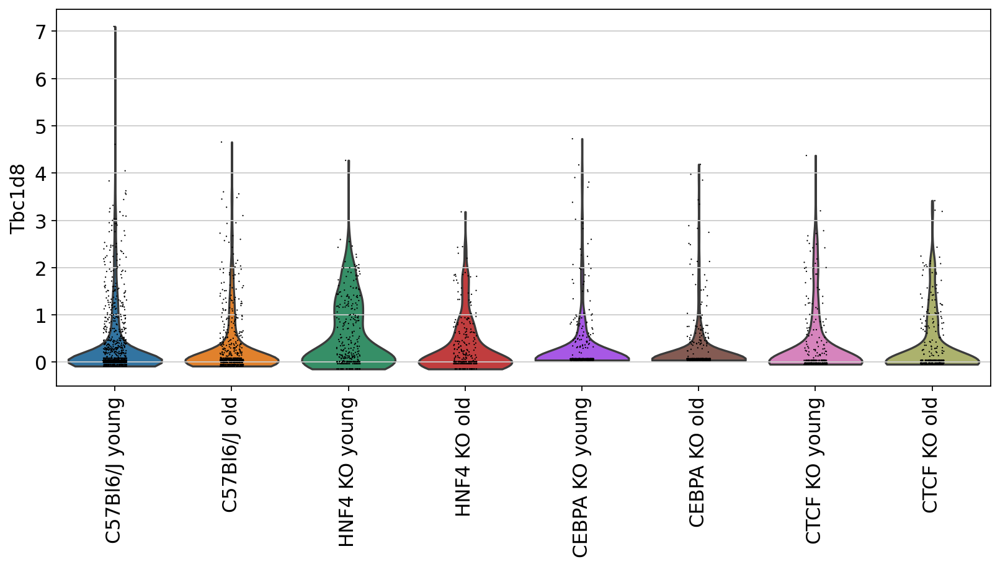

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


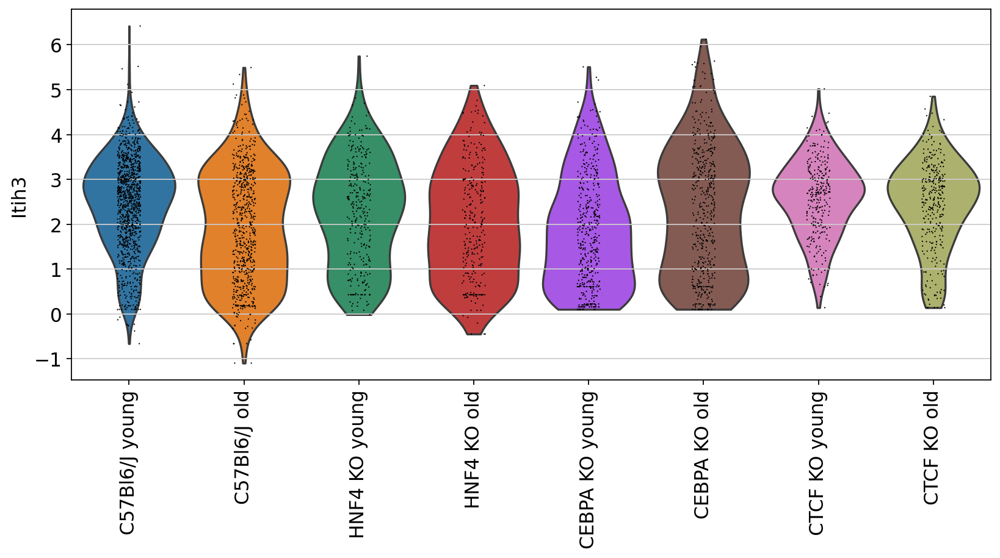

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


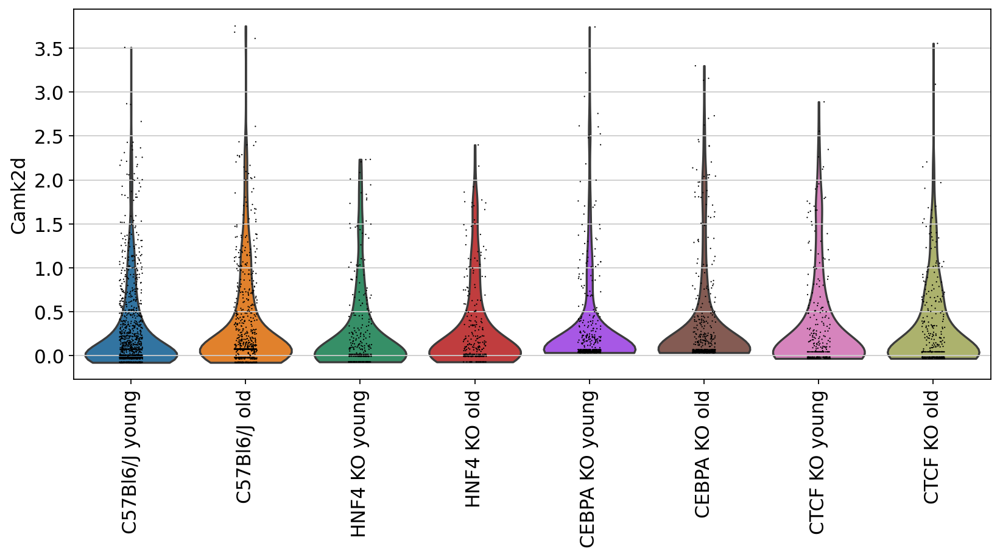

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


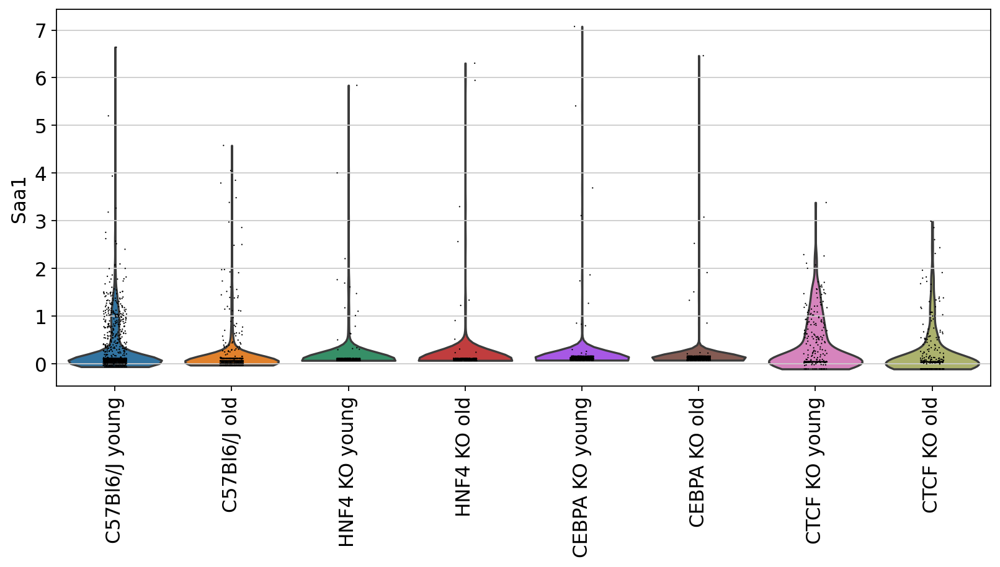

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


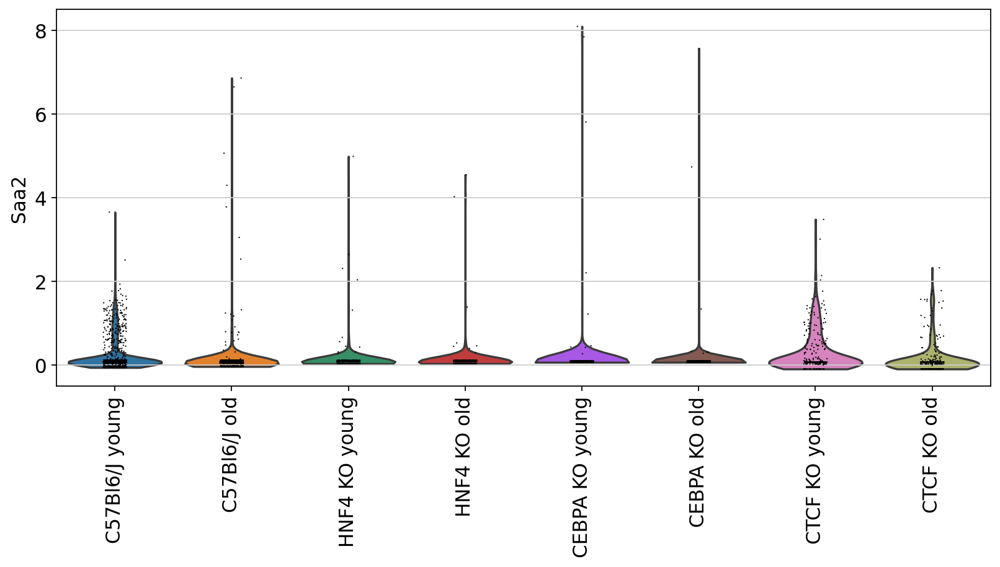

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


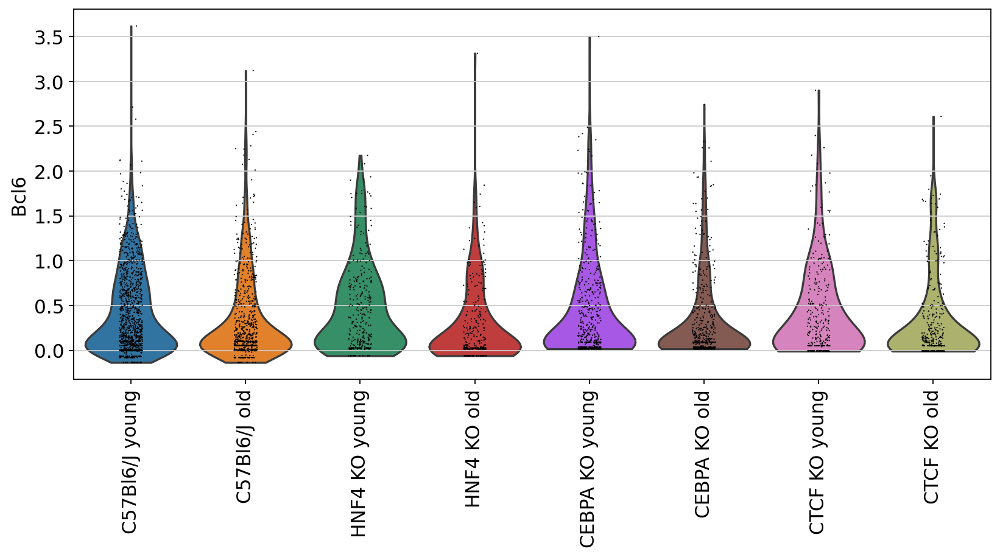

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


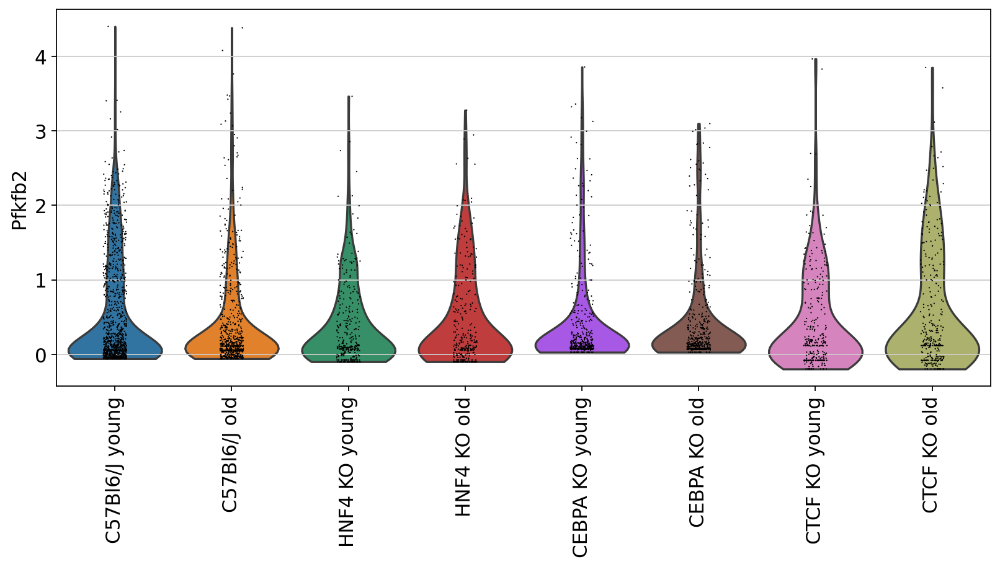

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


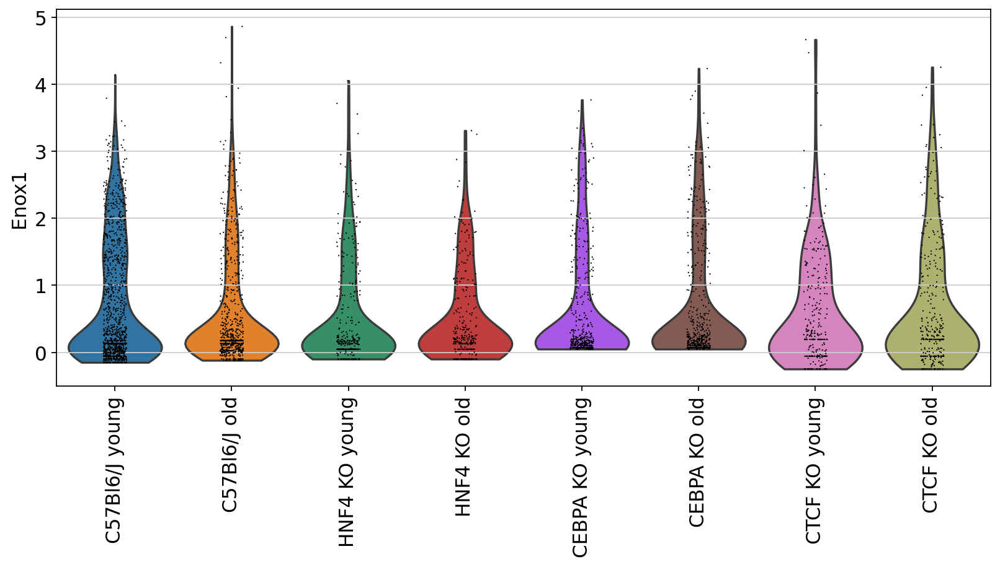

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


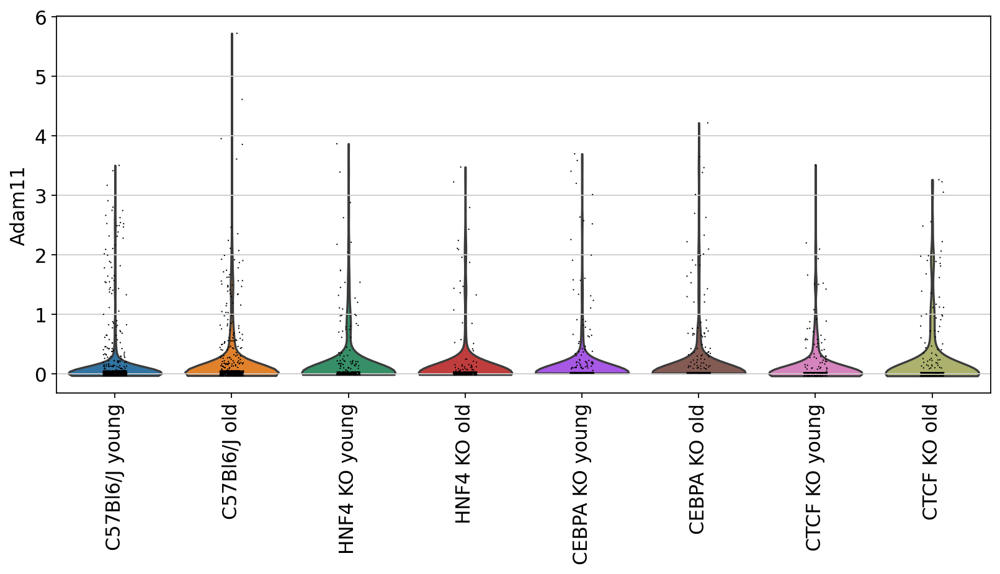

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


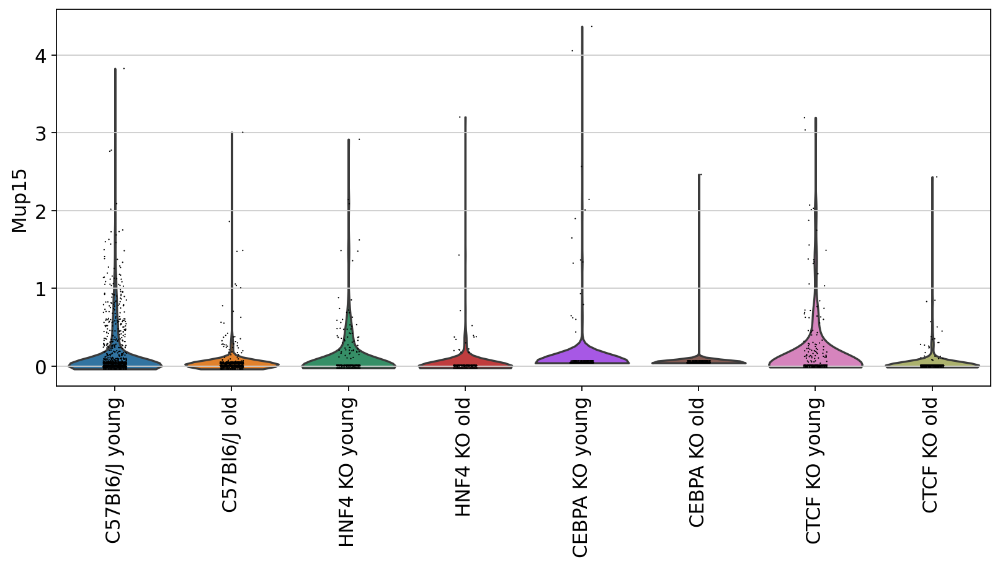

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


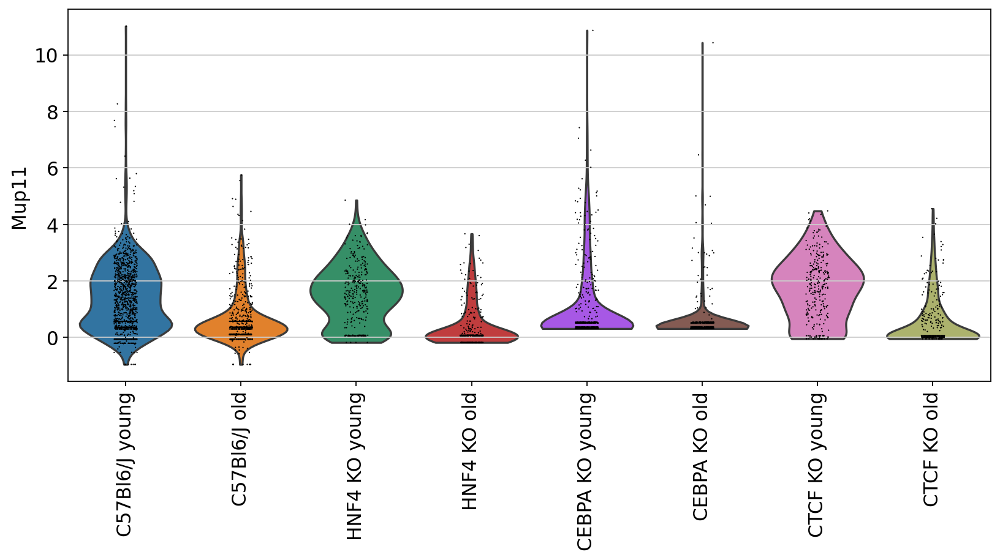

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


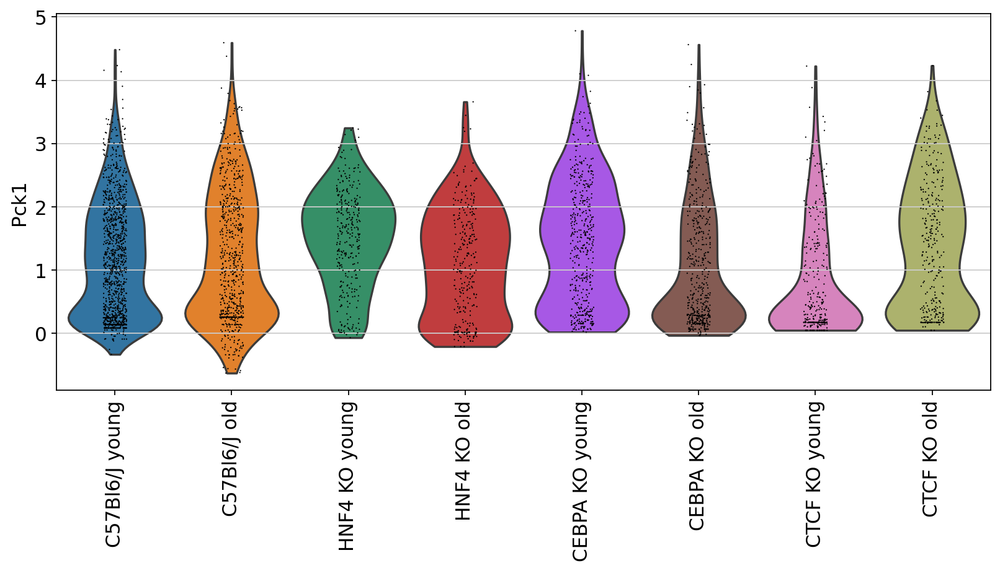

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


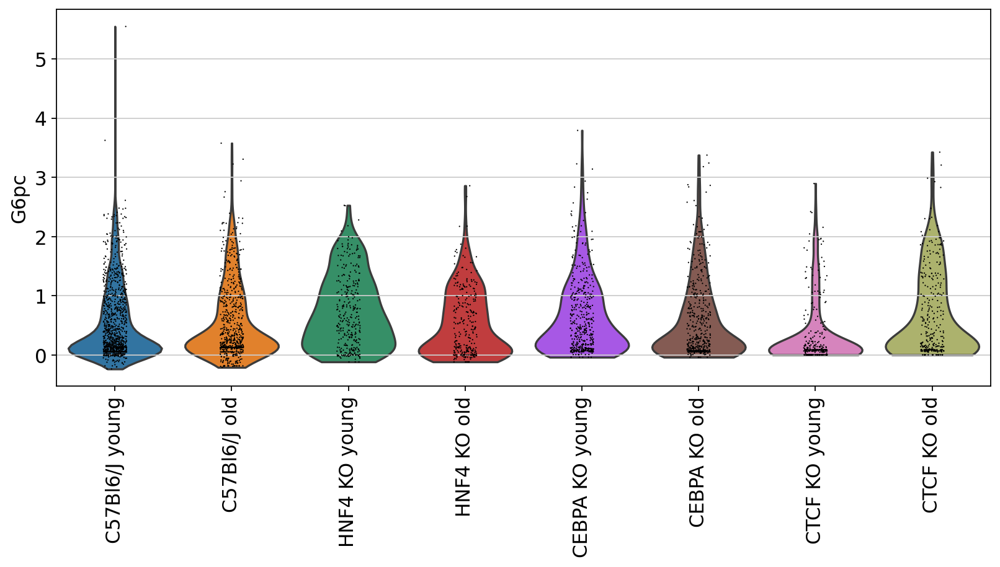

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


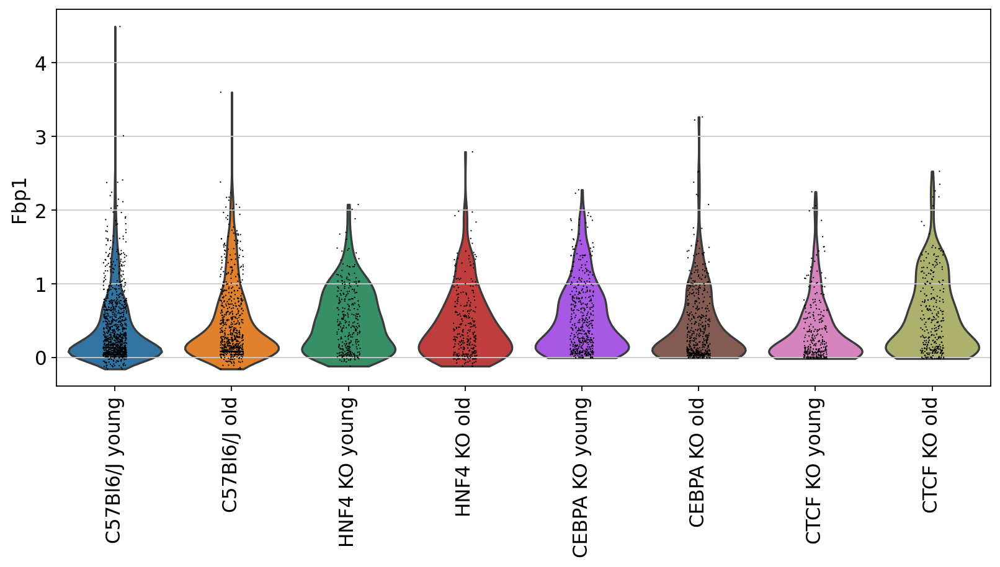

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


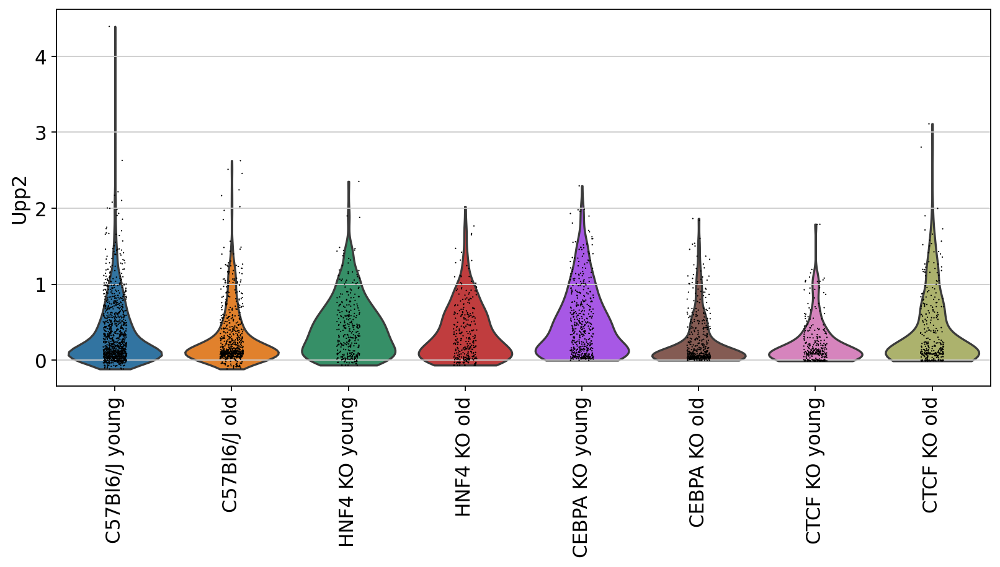

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


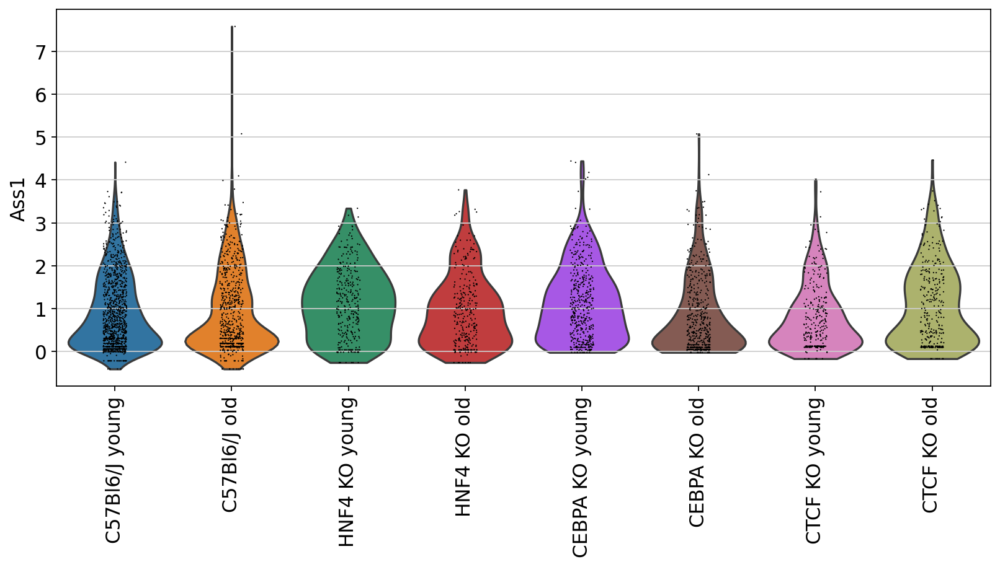

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


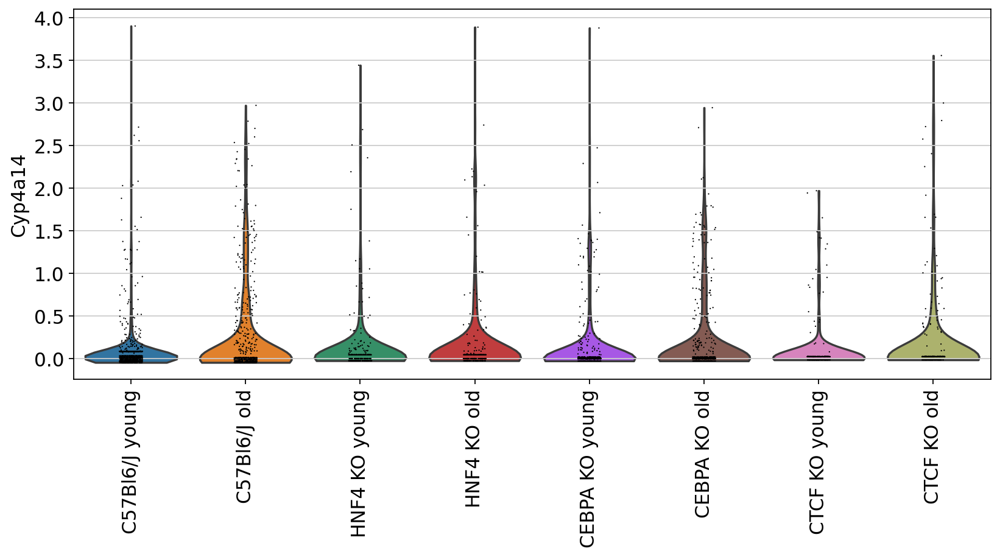

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


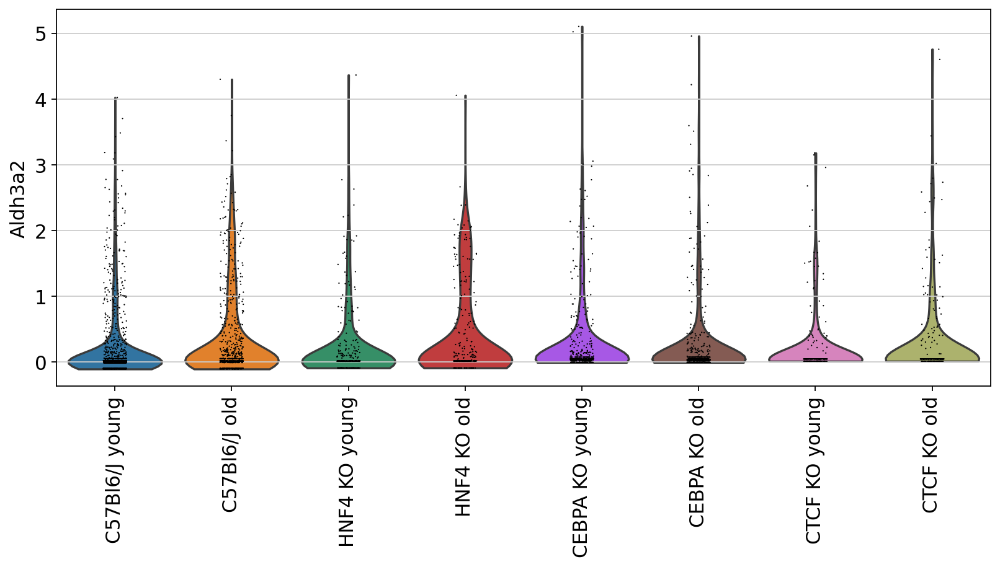

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


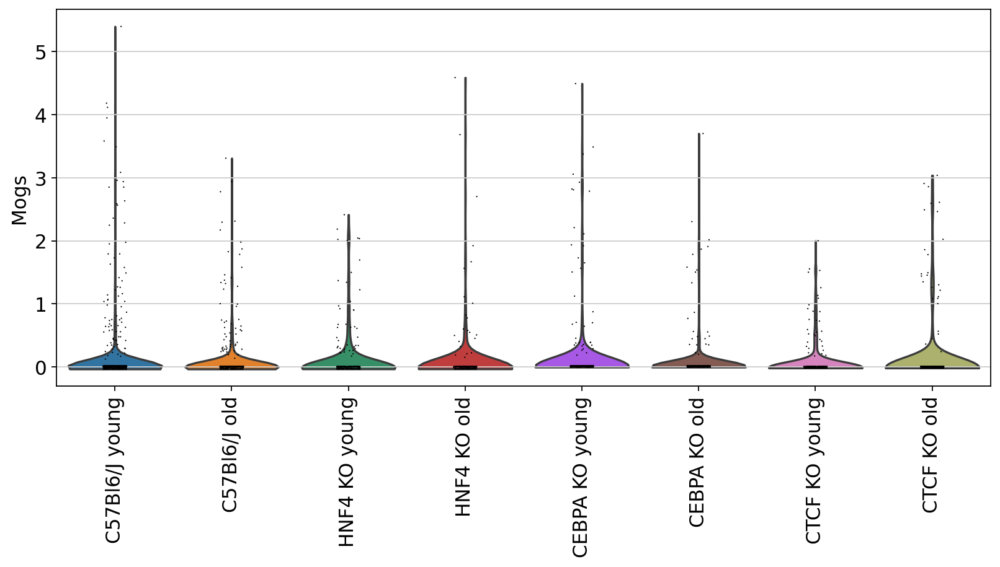

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


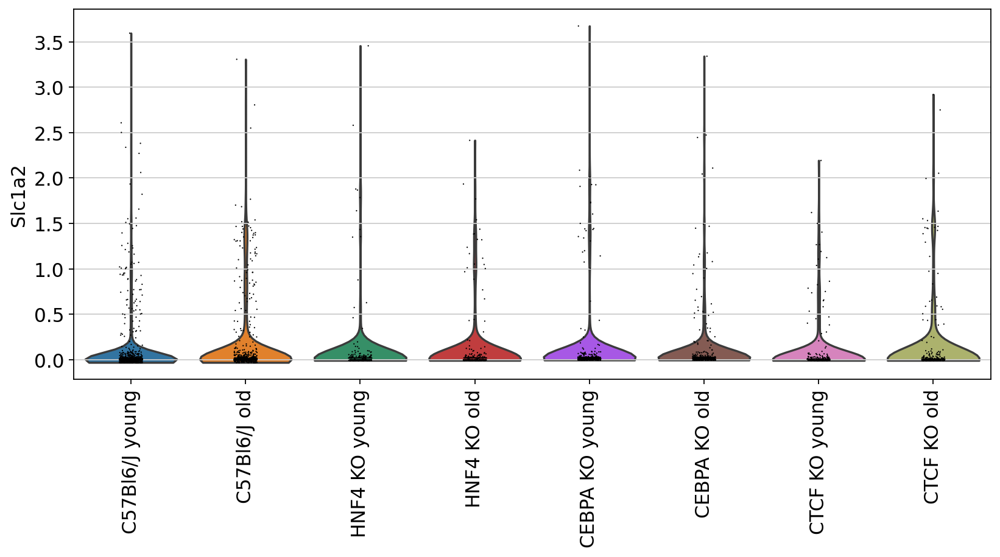

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


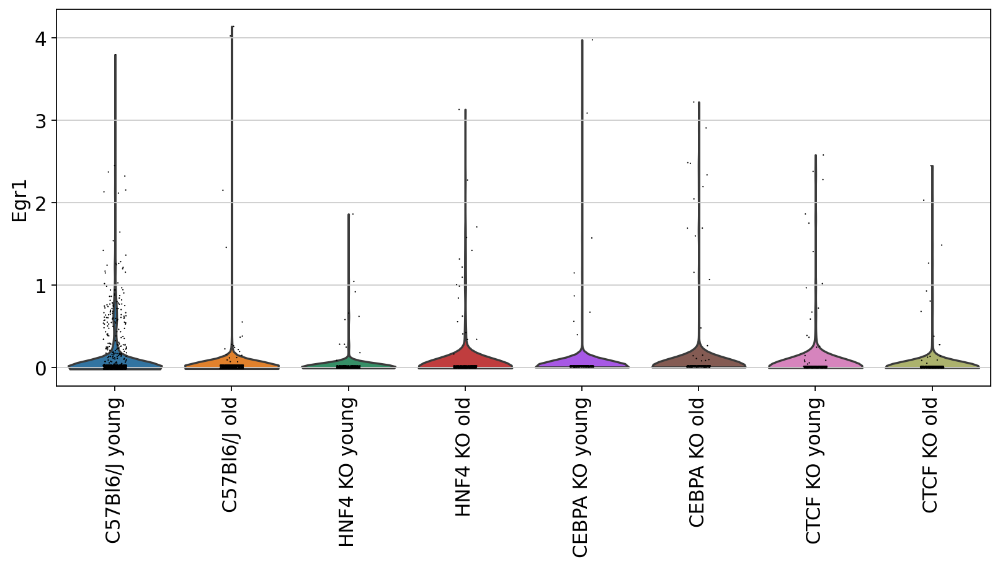

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


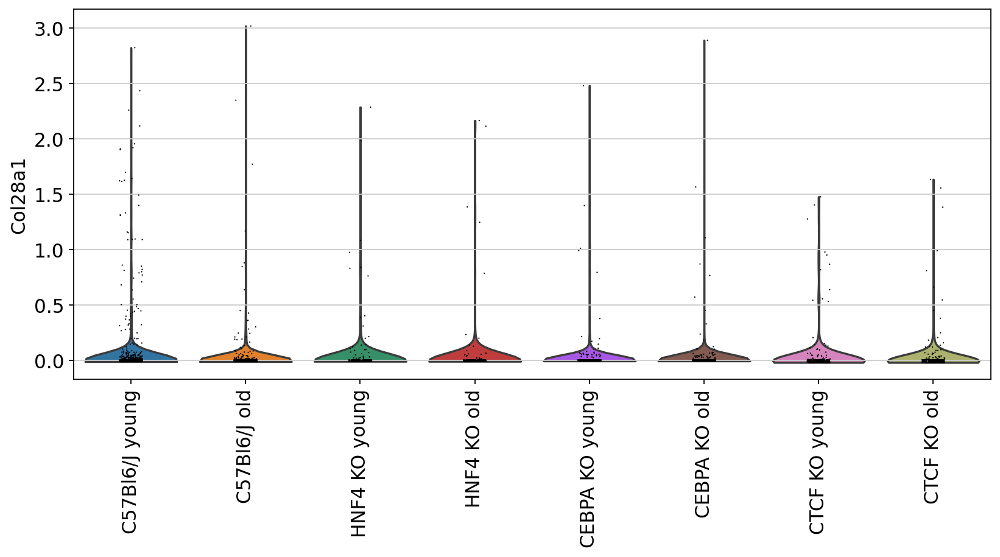

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


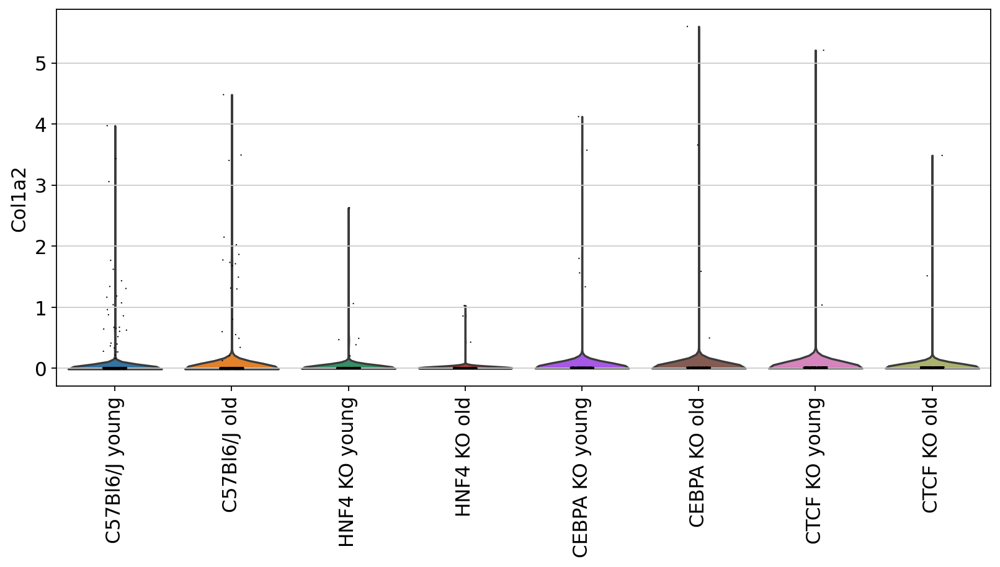

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


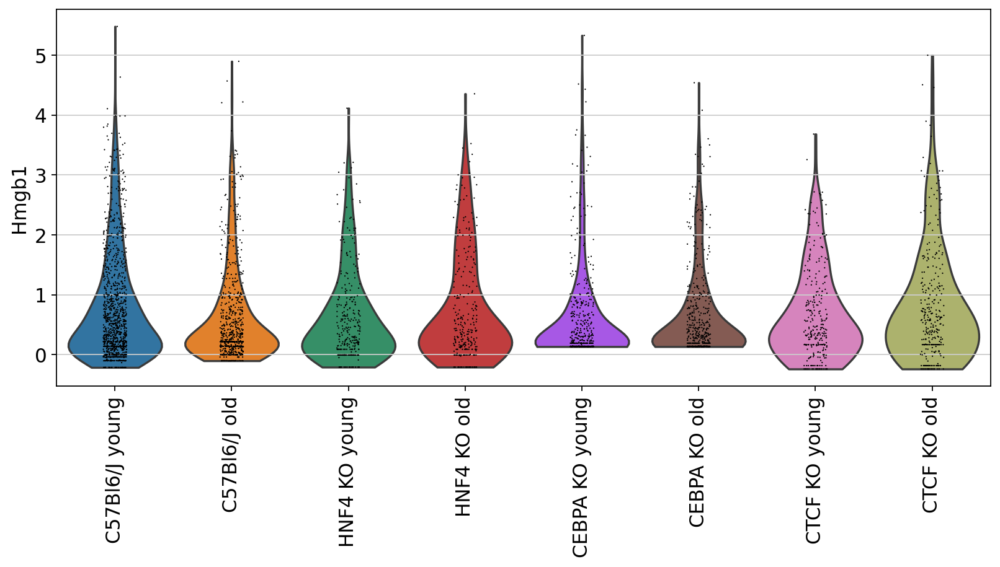

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


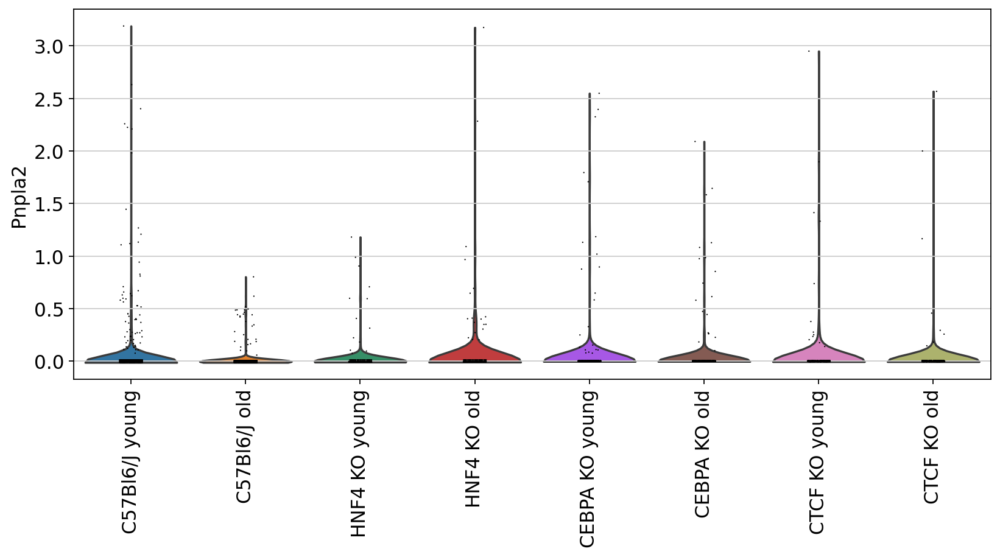

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


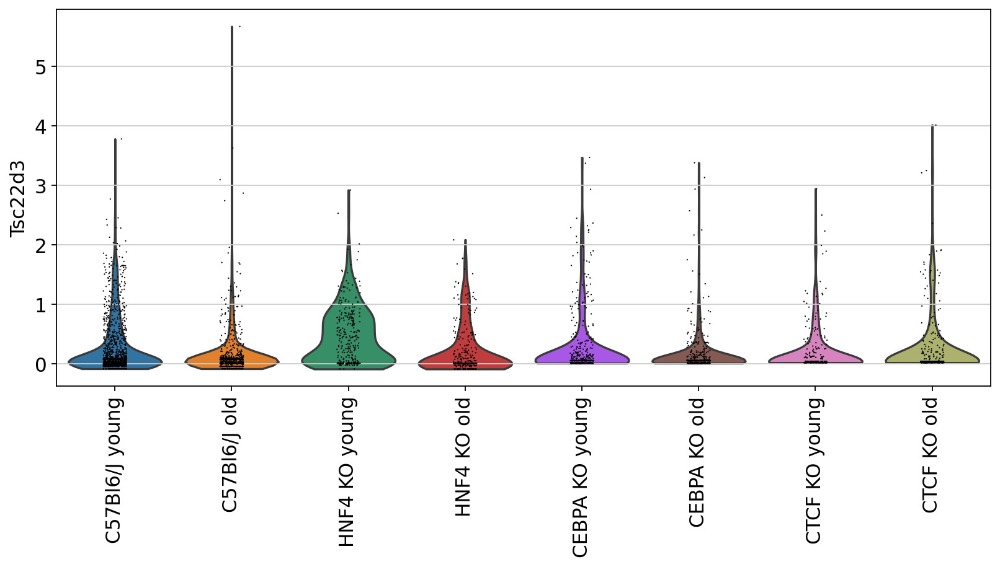

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


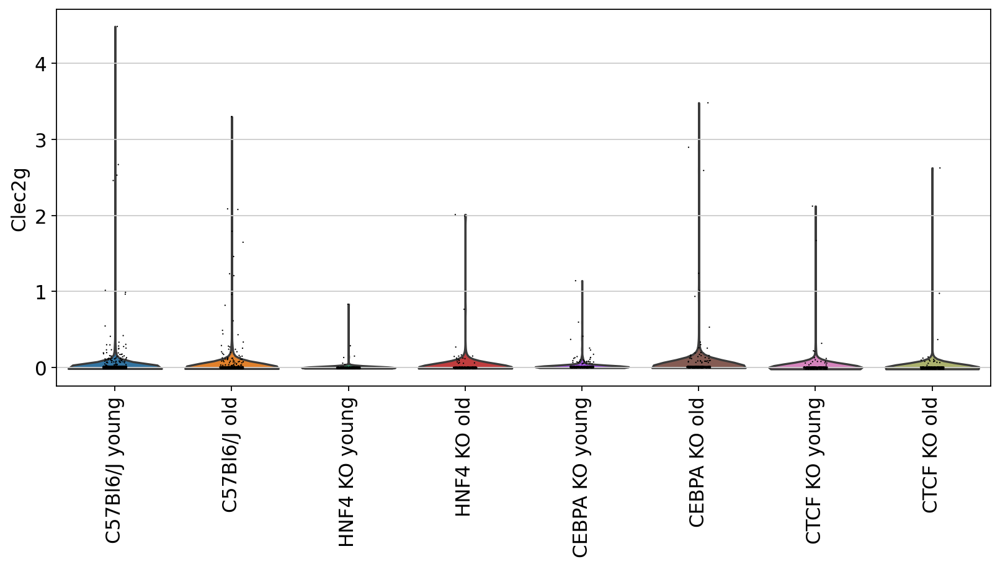

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


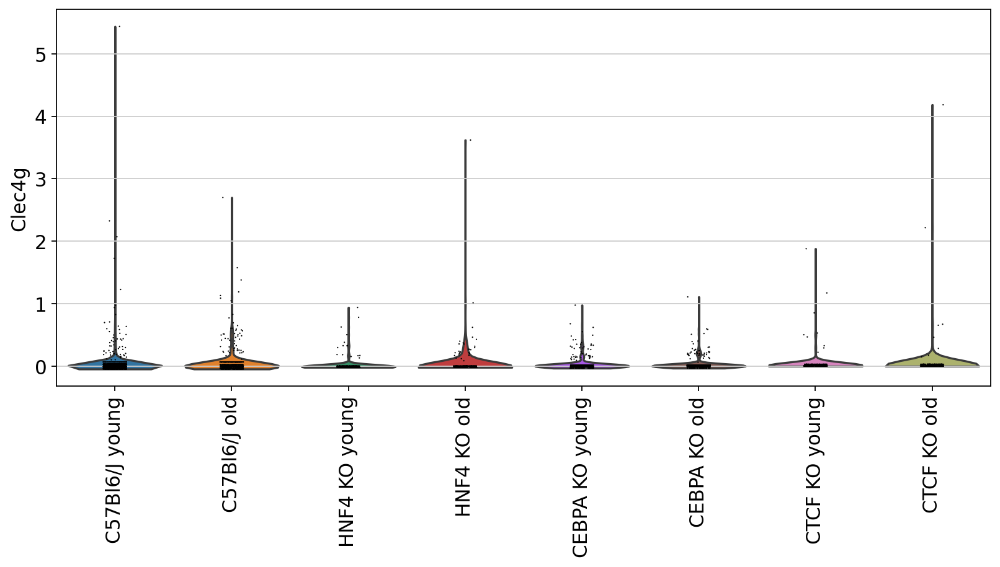

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


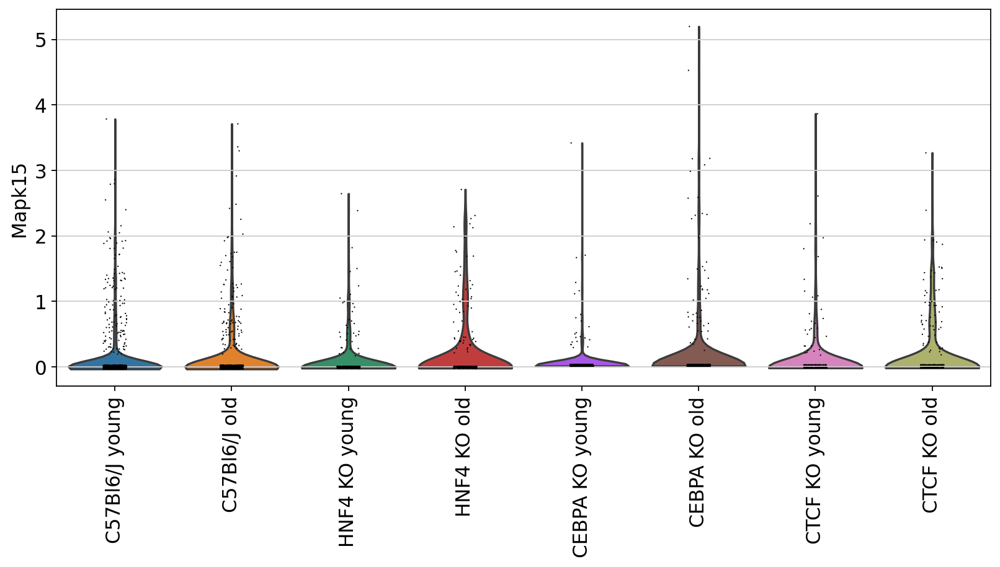

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


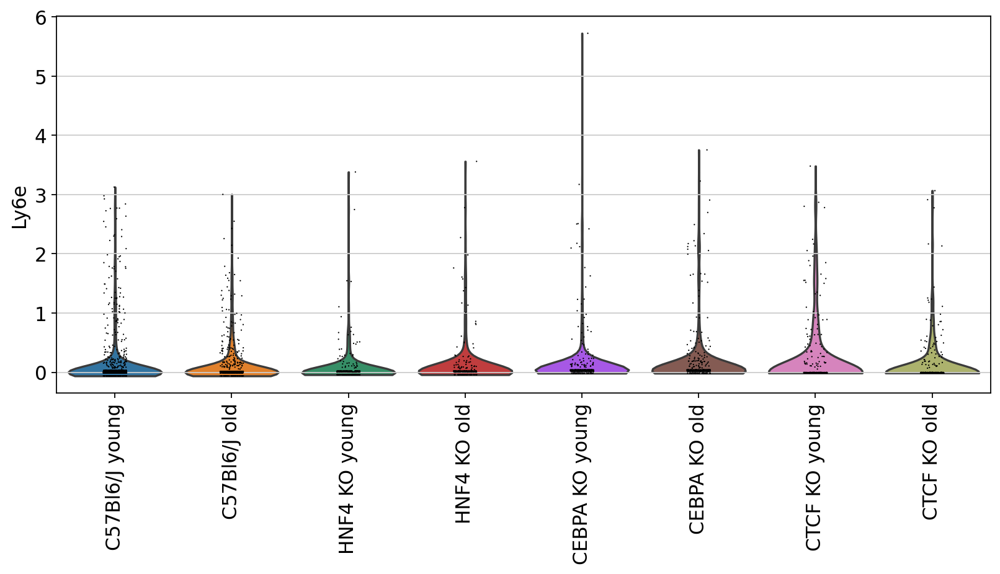

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


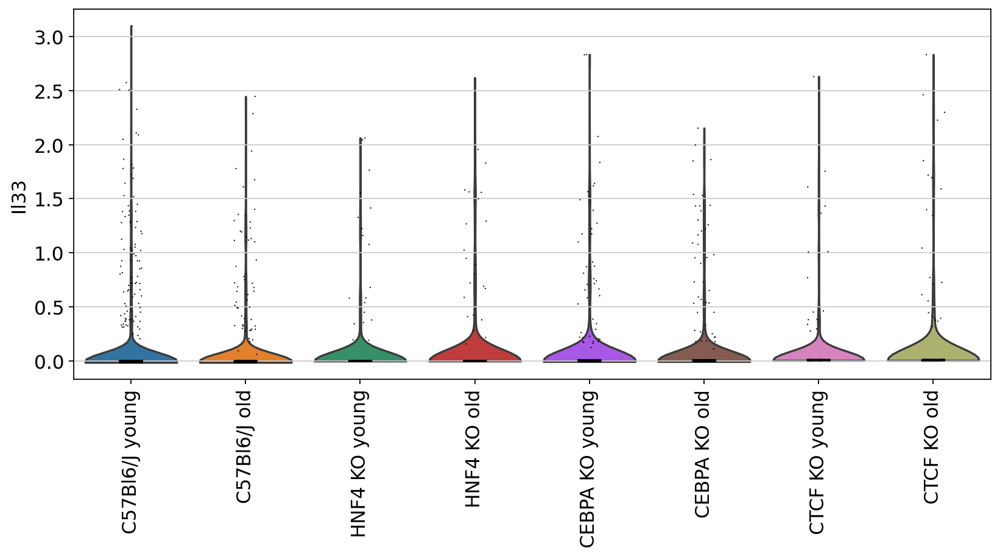

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


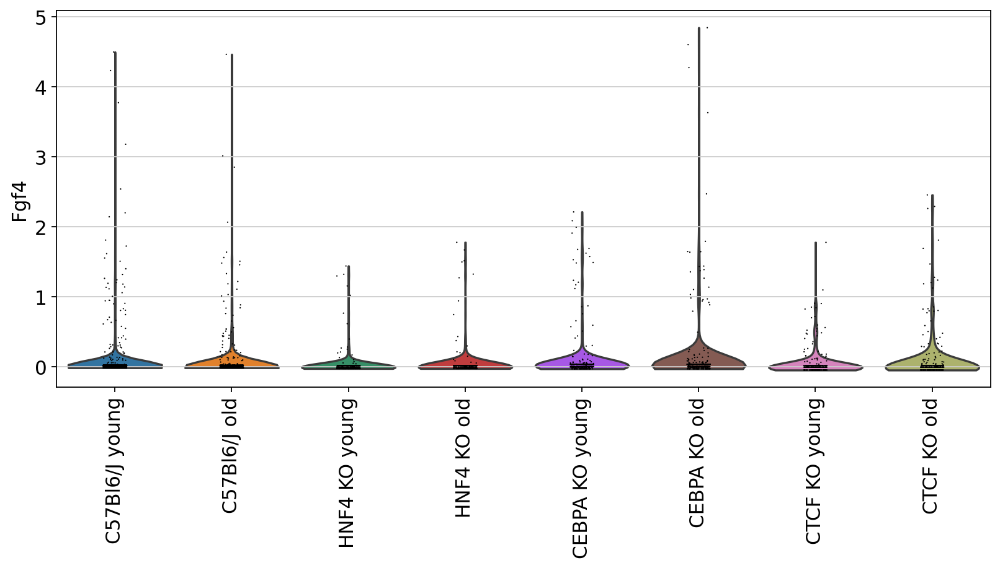

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


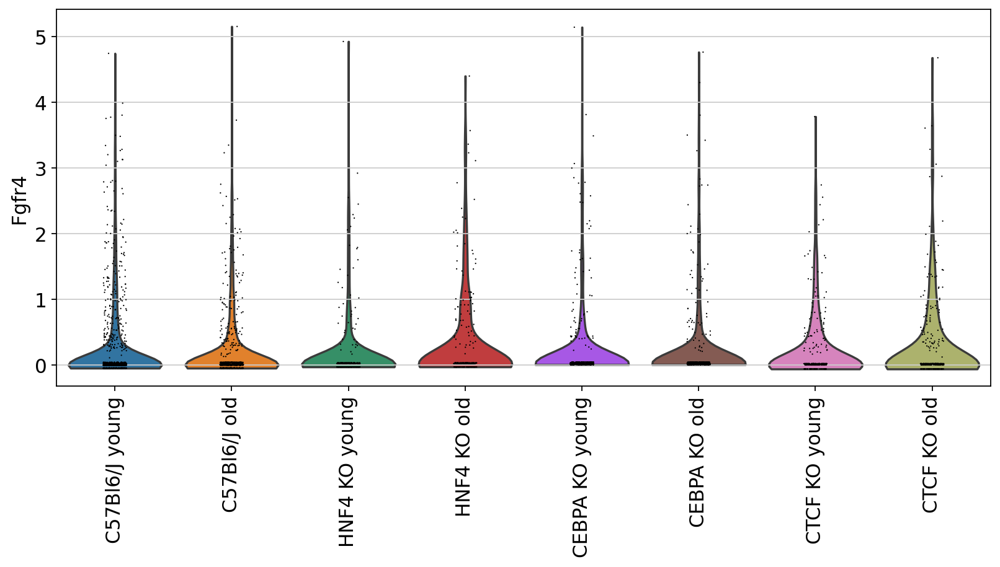

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


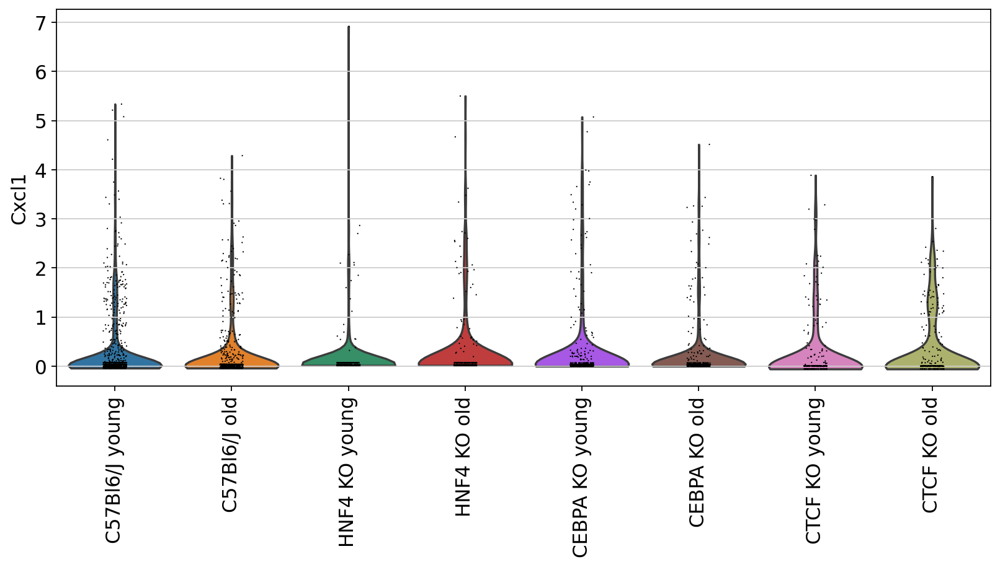

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


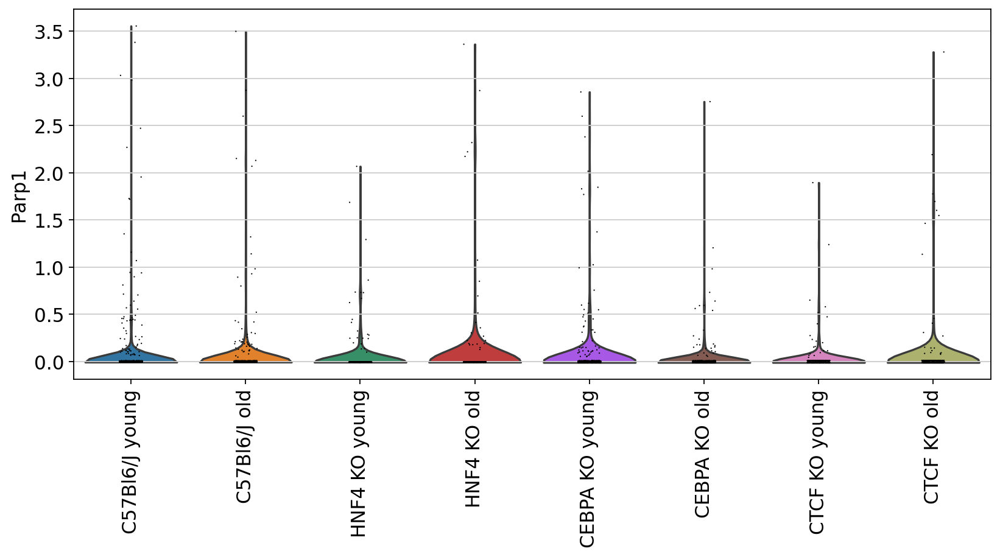

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


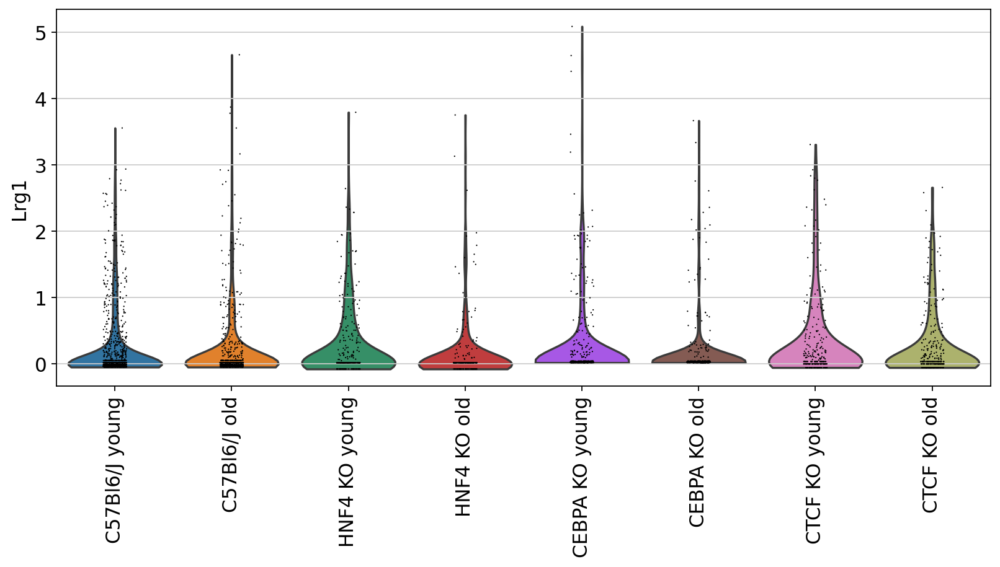

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


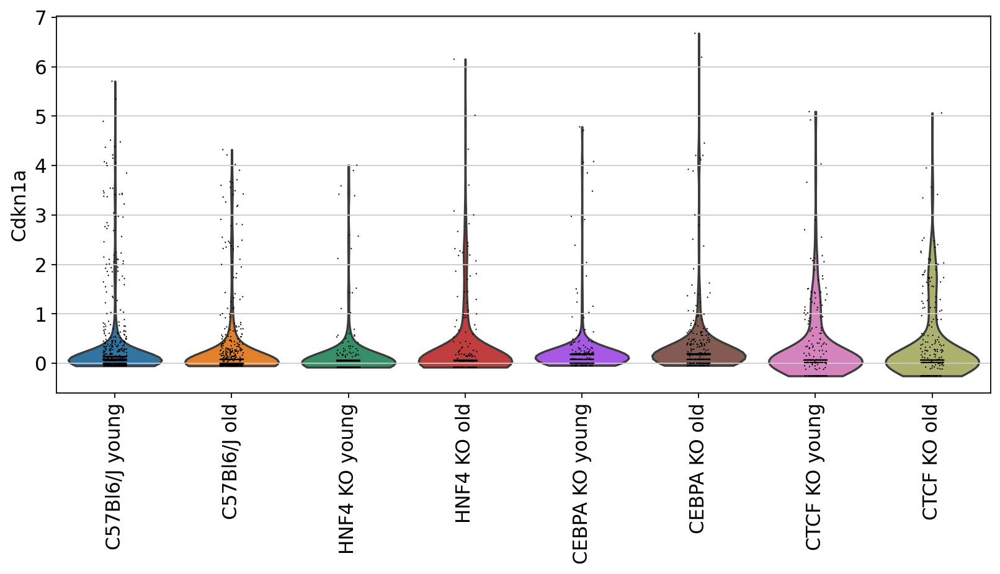

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


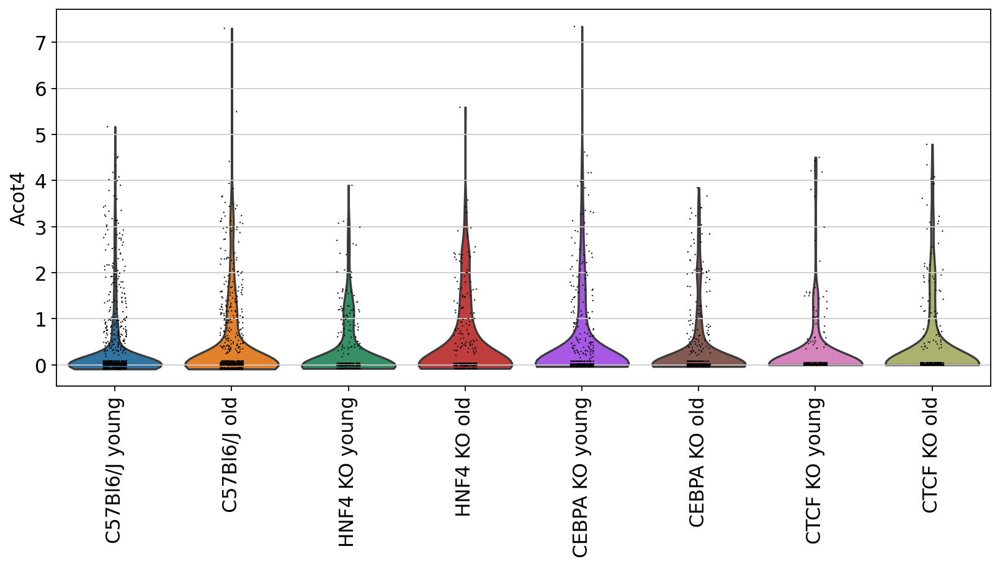

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


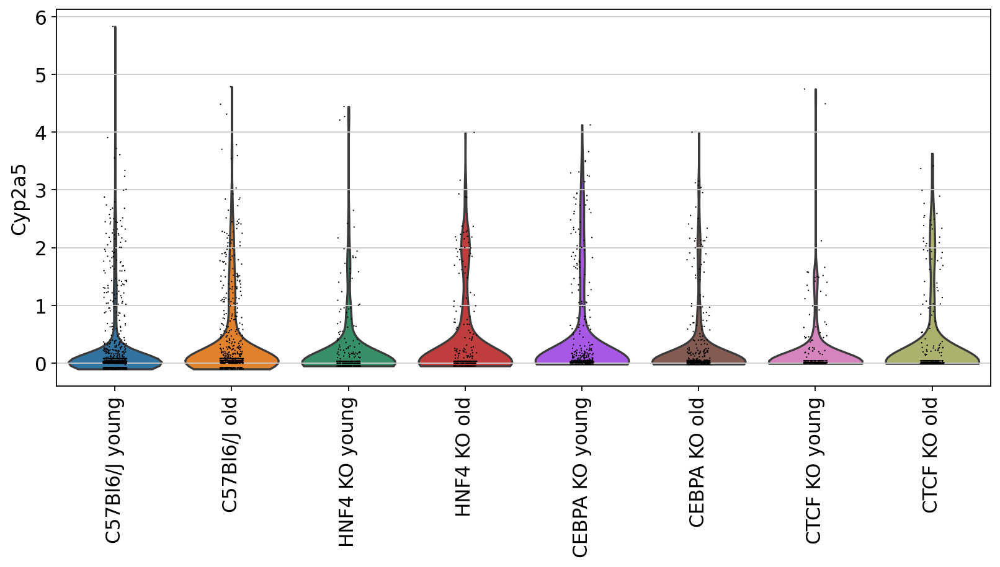

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


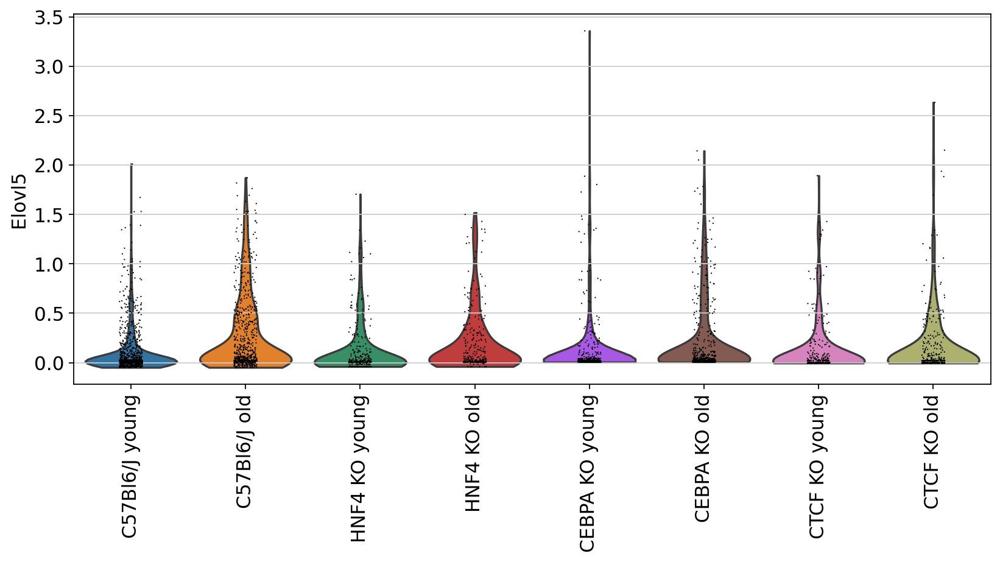

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


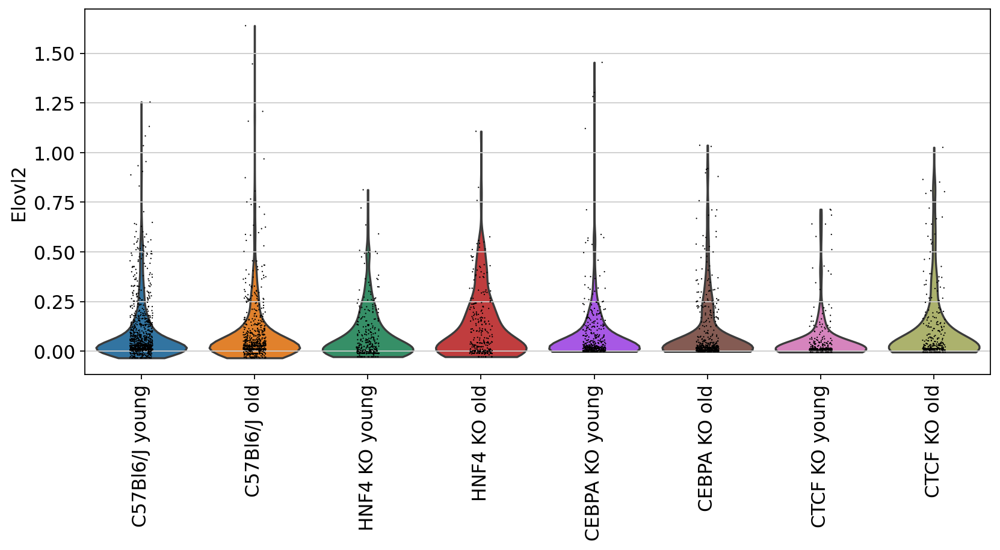

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


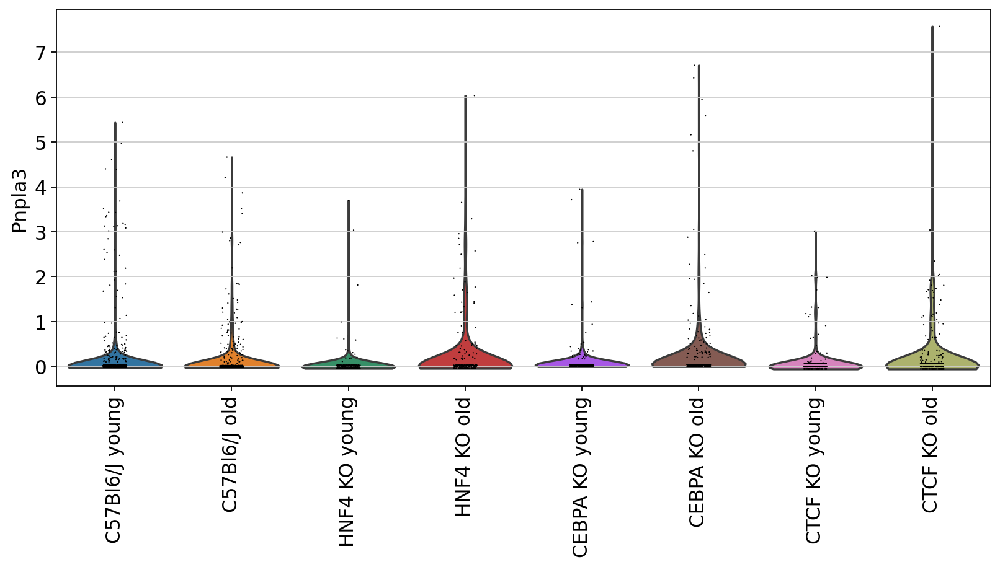

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


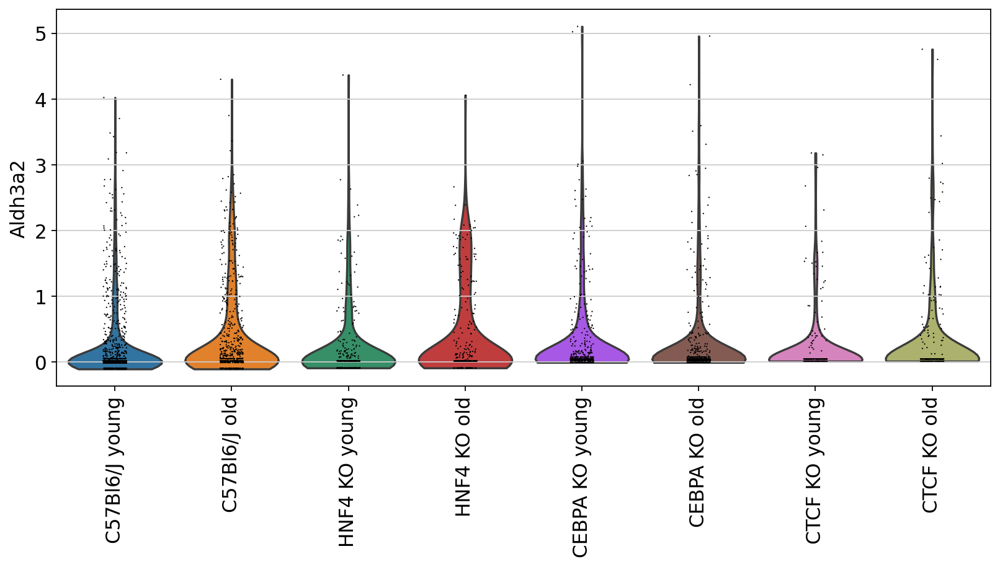

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


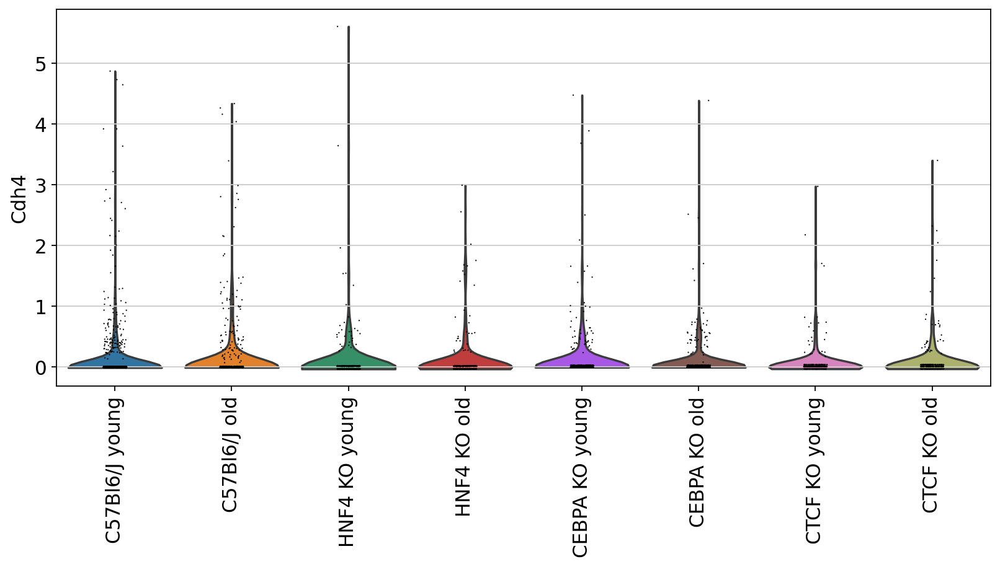

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


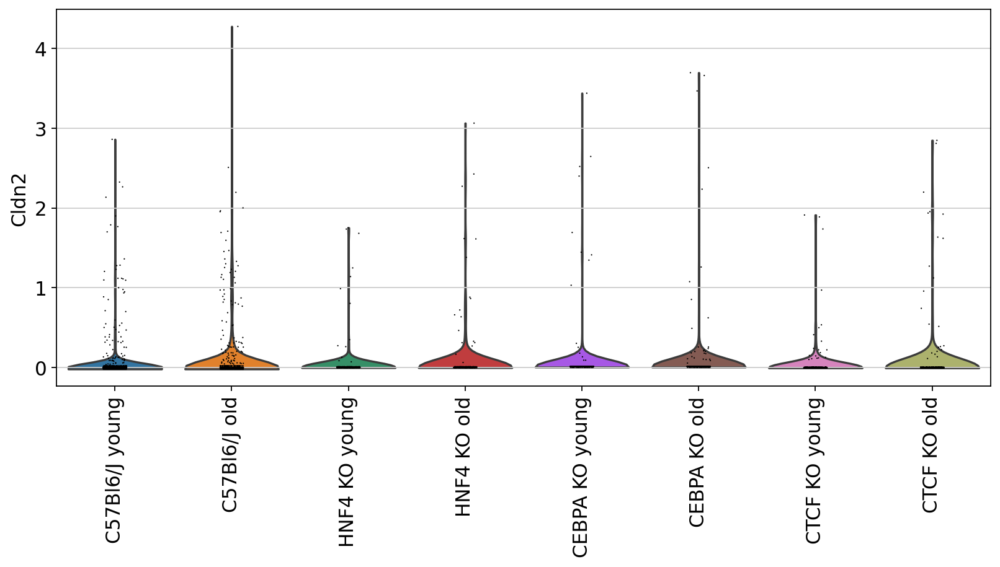

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


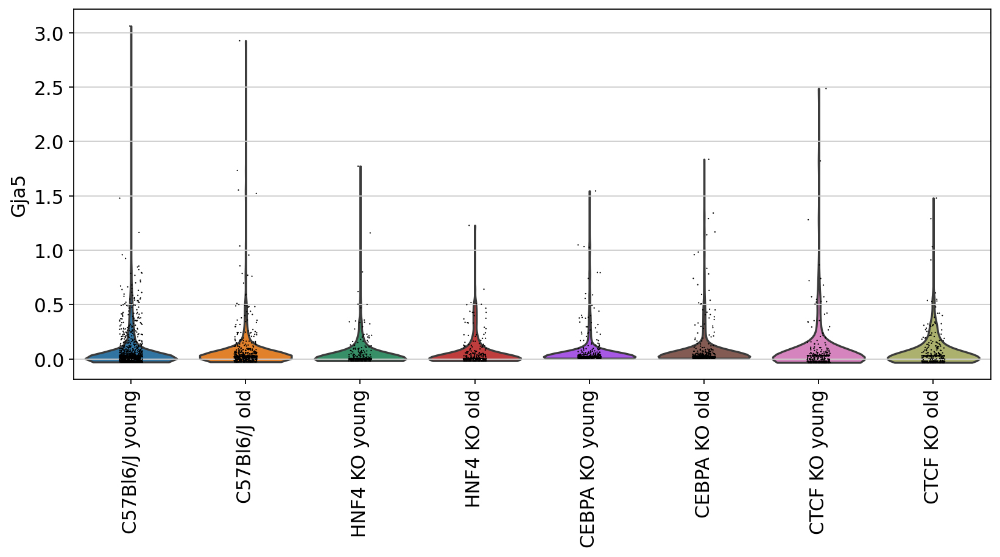

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


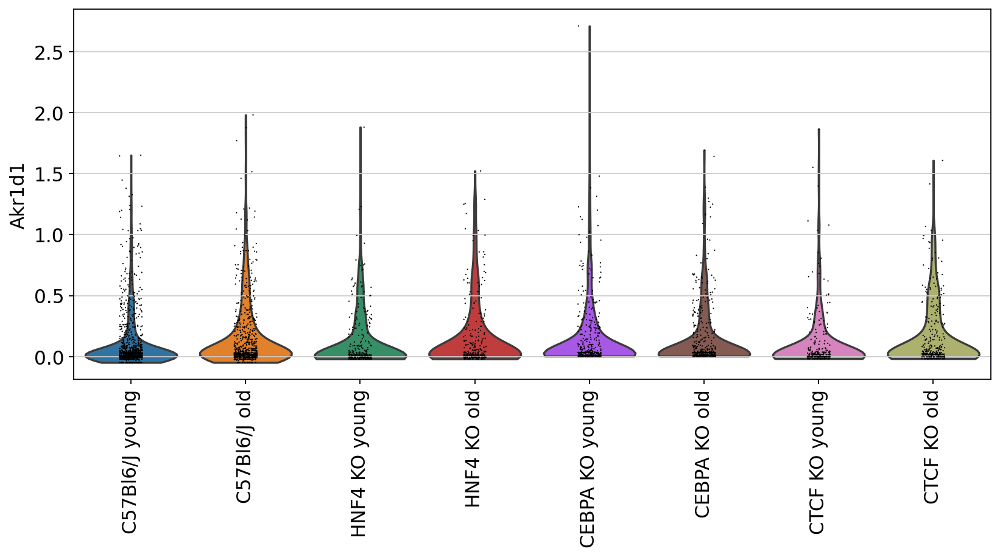

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


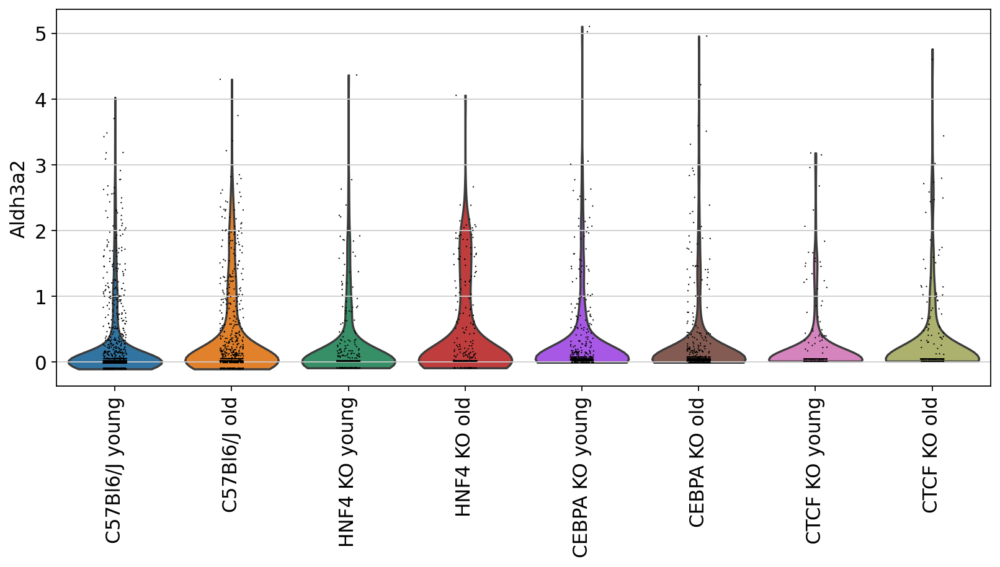

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


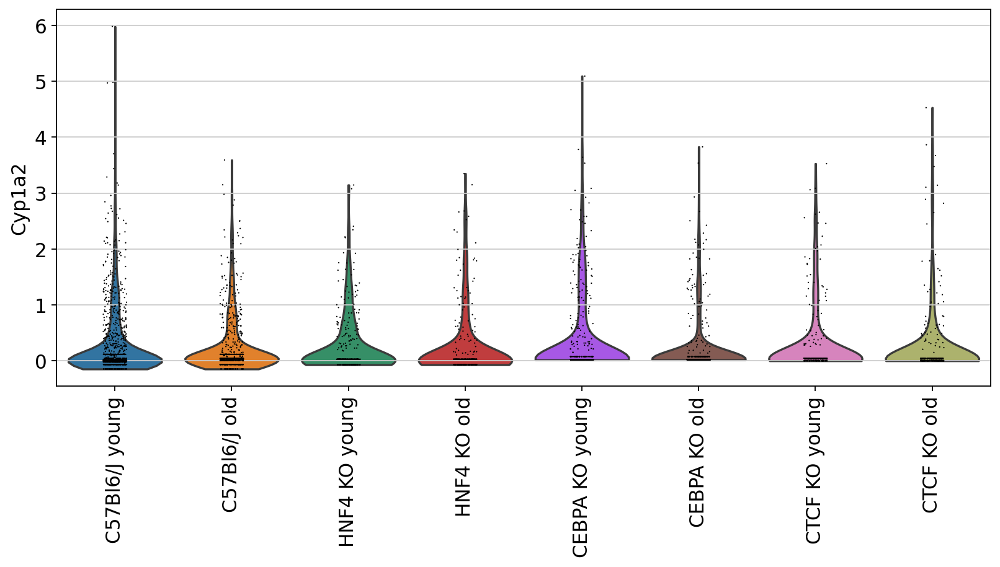

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


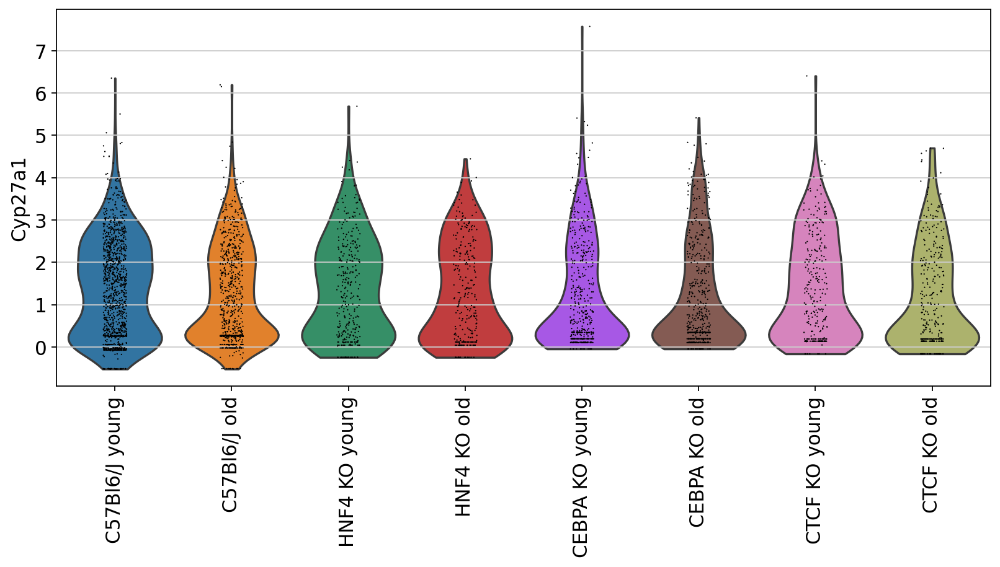

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


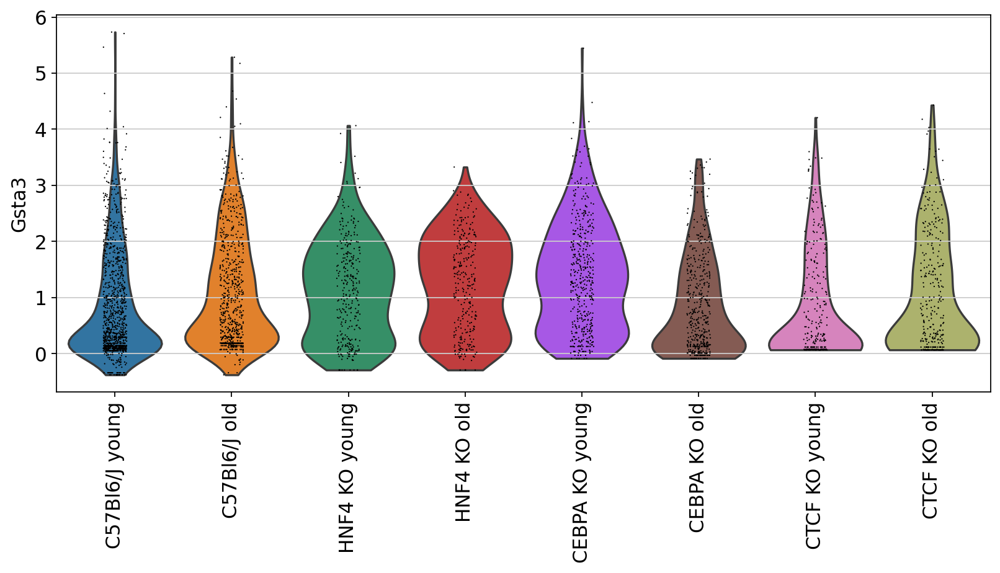

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


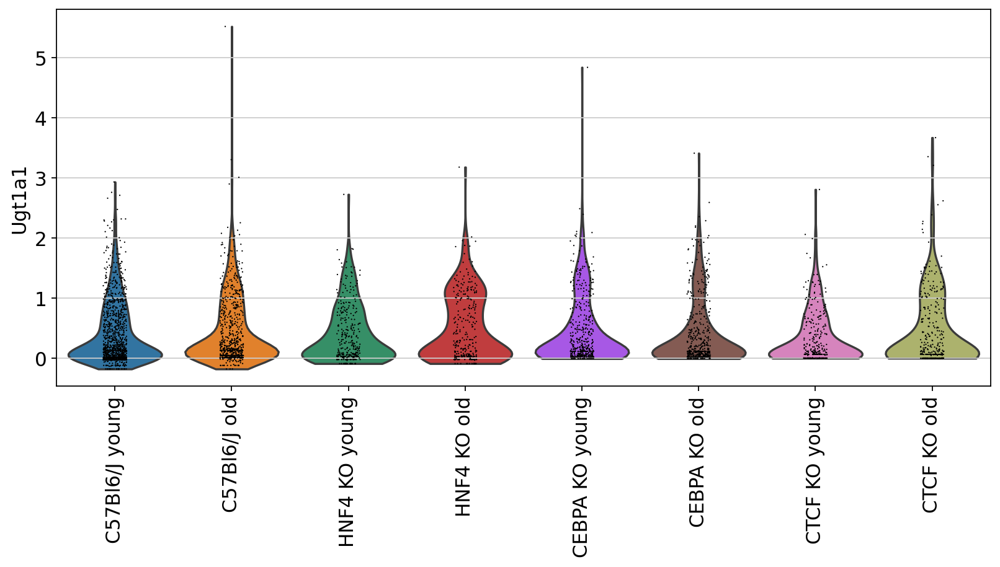

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


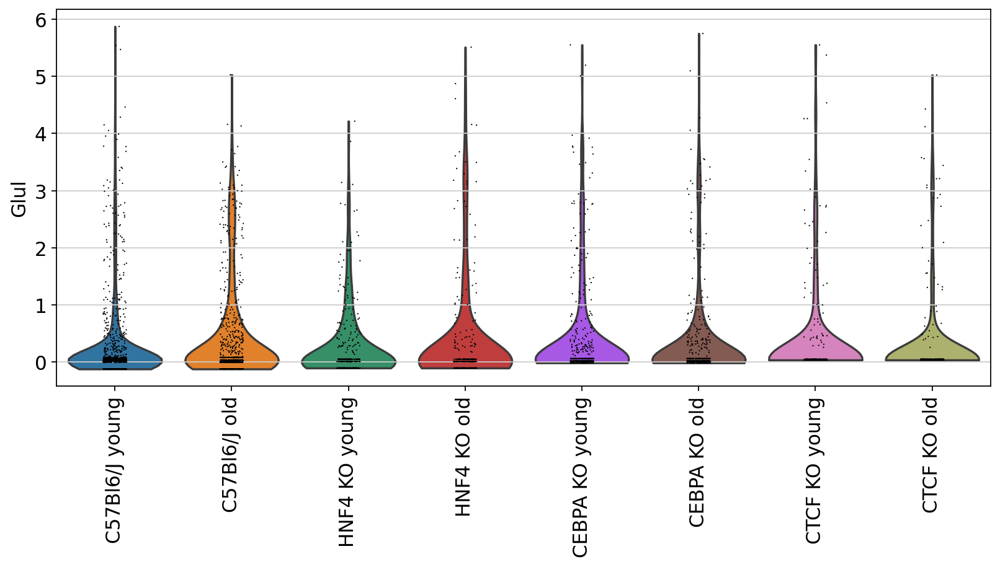

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


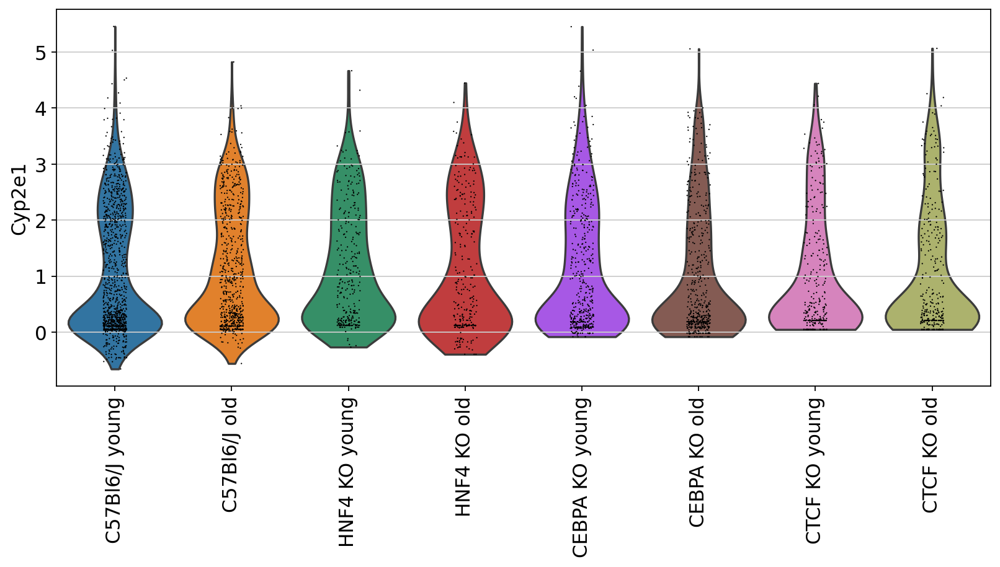

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


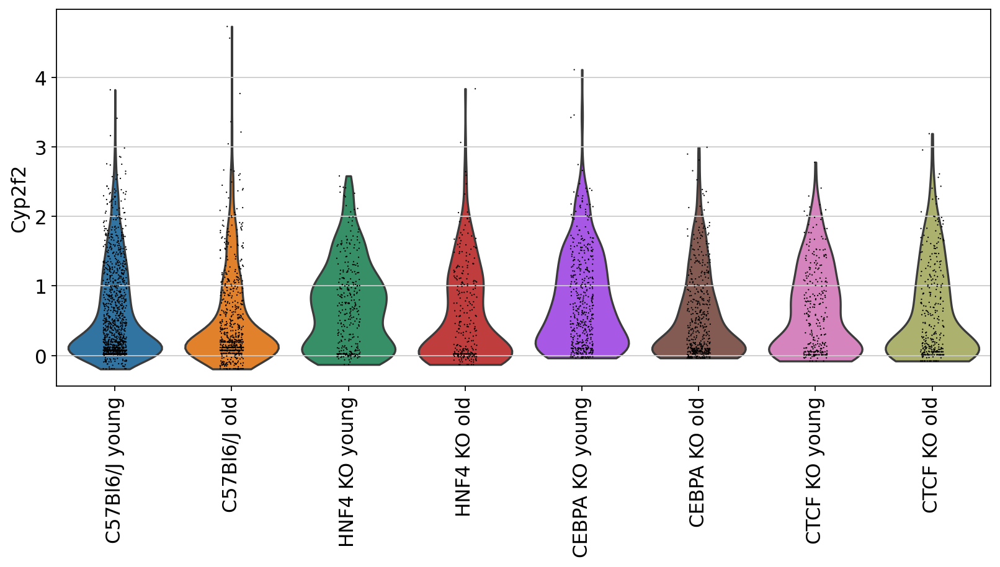

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


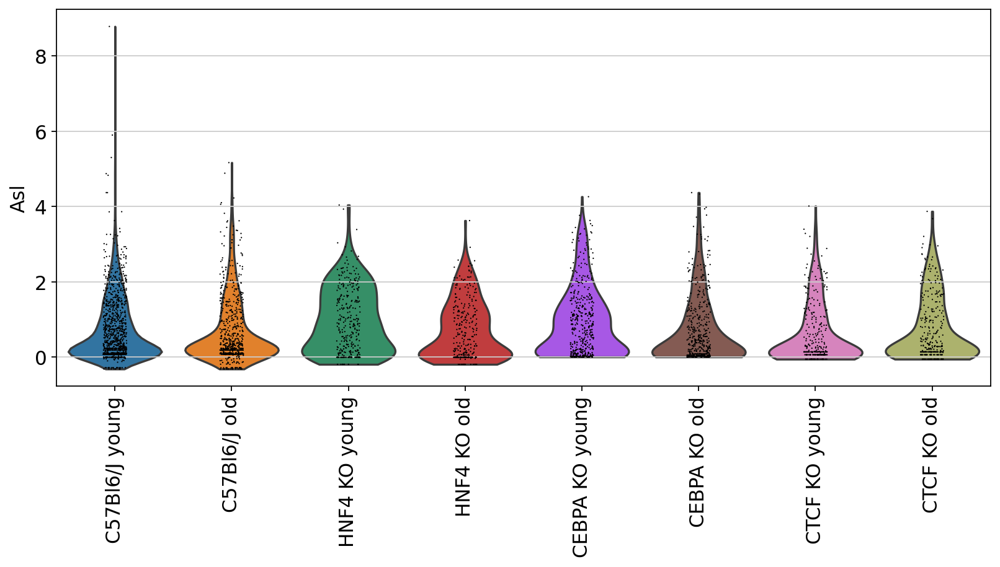

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


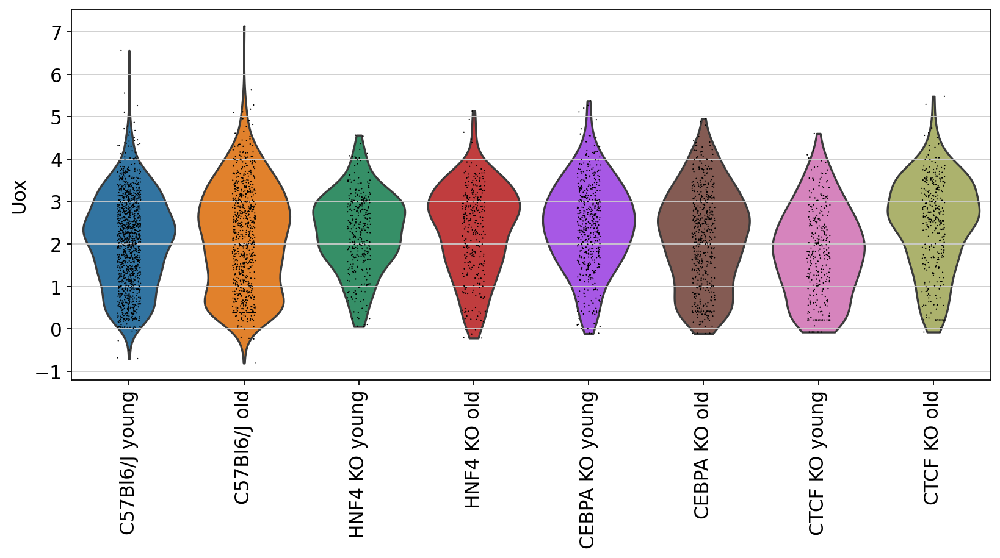

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


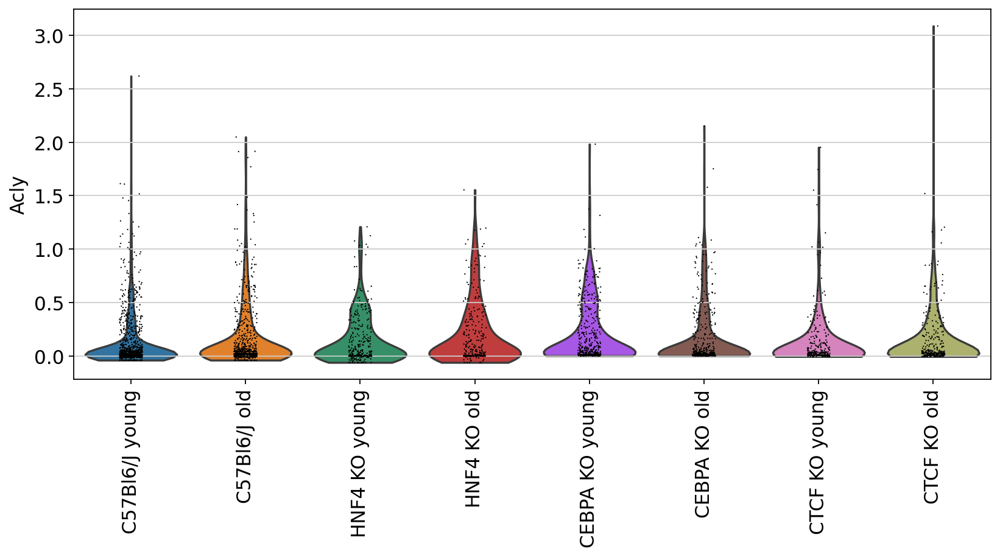

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


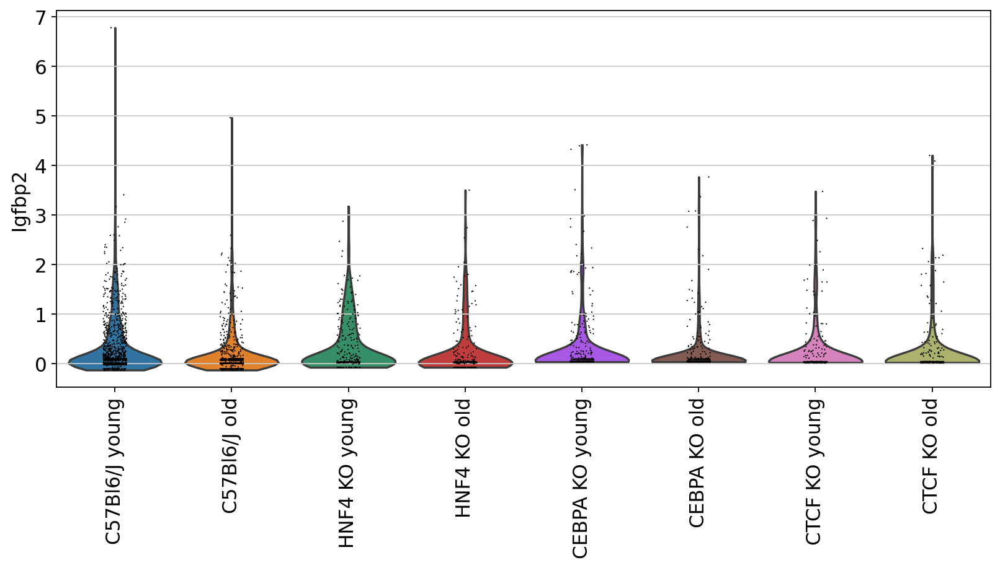

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


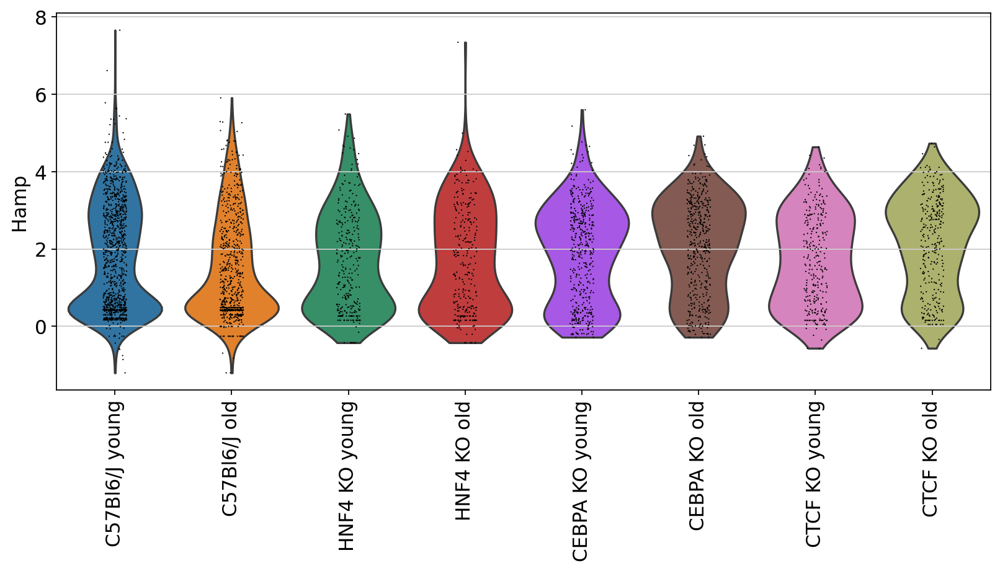

In [100]:
rcParams['figure.figsize']=(10,5)
for gene in metab_marker.index.values:
    sc.pl.violin(adata_hep, use_raw=False, 
                 keys=gene, groupby='strain_age', rotation=90,
                     save=today +'_' + gene +'_metabolism_strain_age.pdf'
                    )

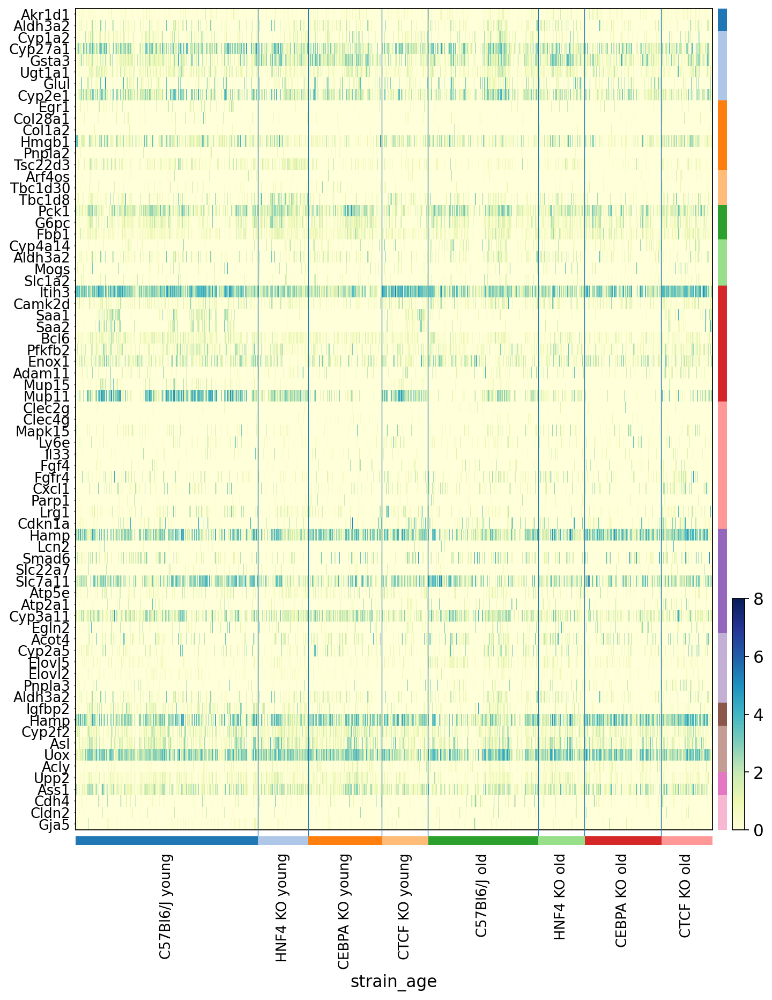

In [138]:
sc.pl.heatmap(adata_hep, 
              gene_symbols='gene_name', 
              groupby='strain_age', swap_axes=True,
              var_names = metab_dict, cmap='YlGnBu',
              show_gene_labels=True, 
              save = today + '_metabolism_strain_age.pdf'
             )

Plot gene scores.

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


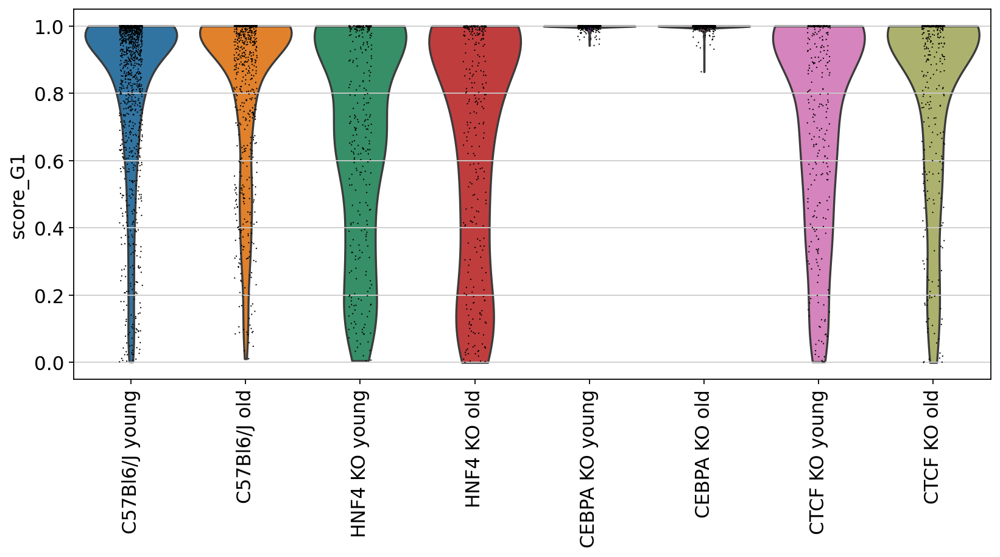

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


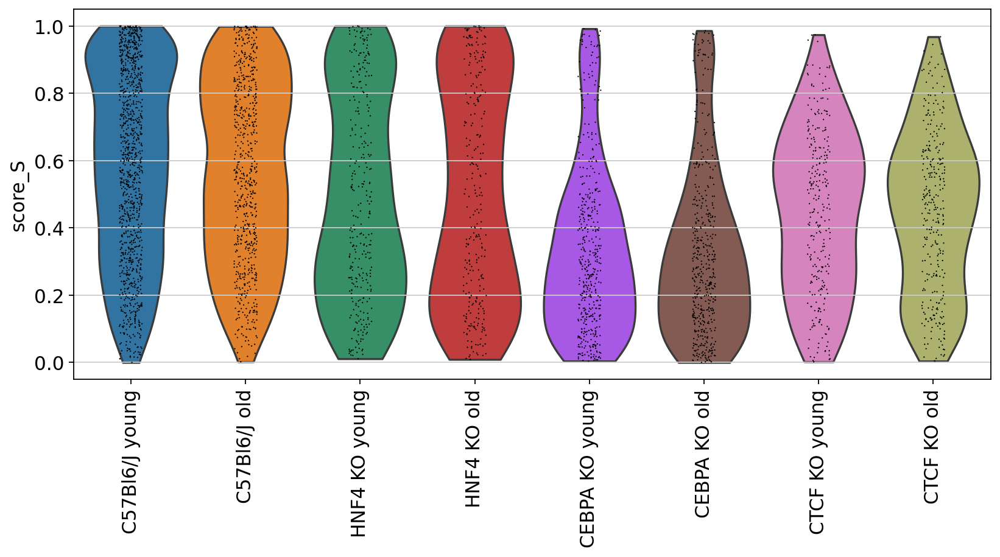

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


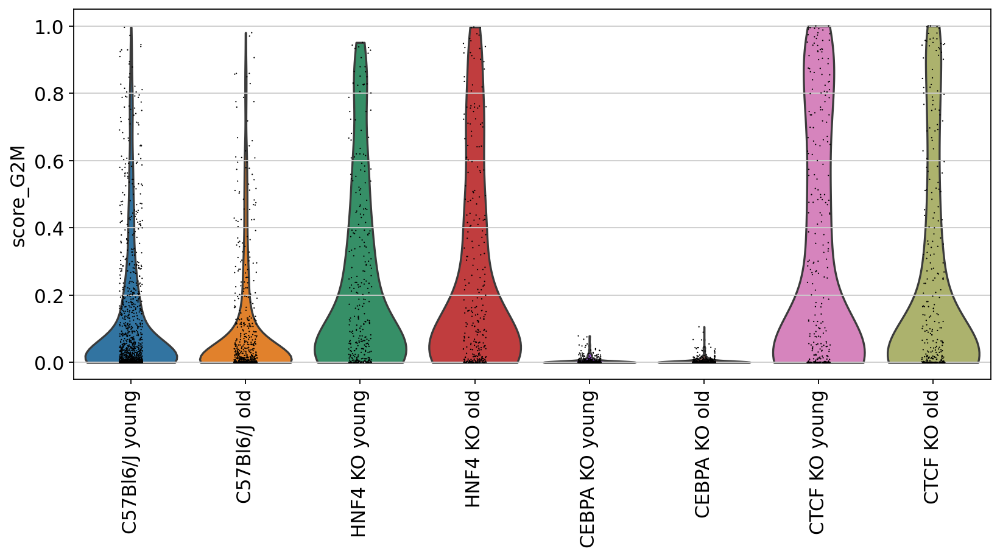

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


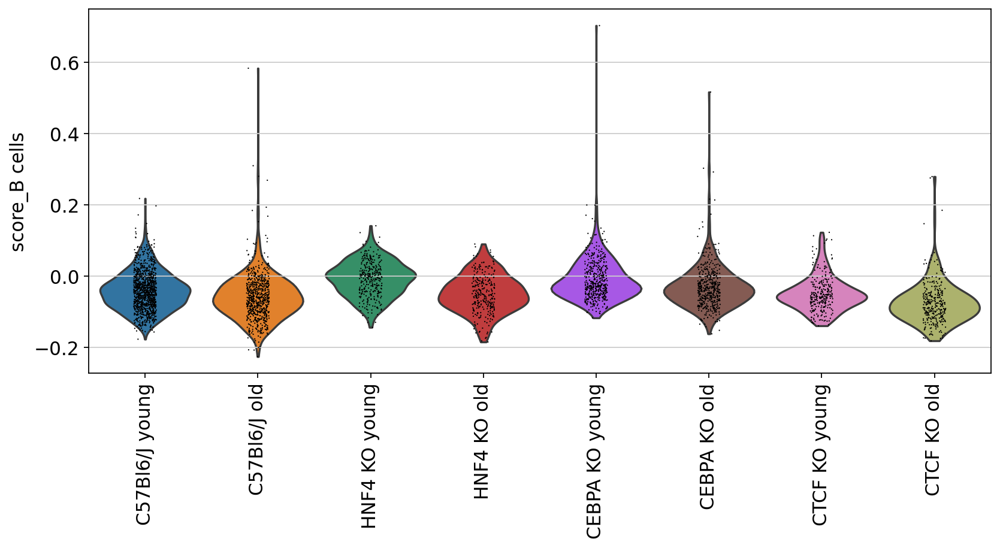

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


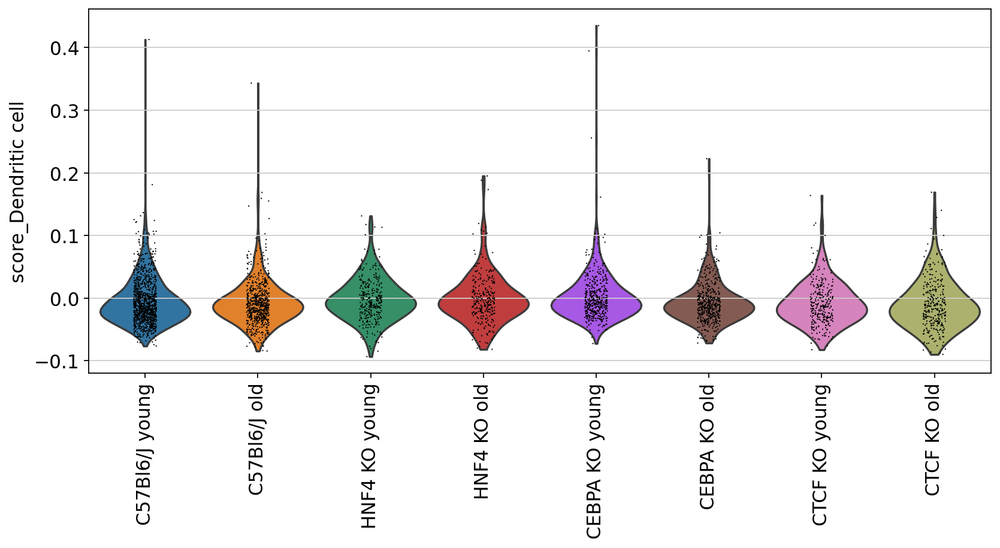

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


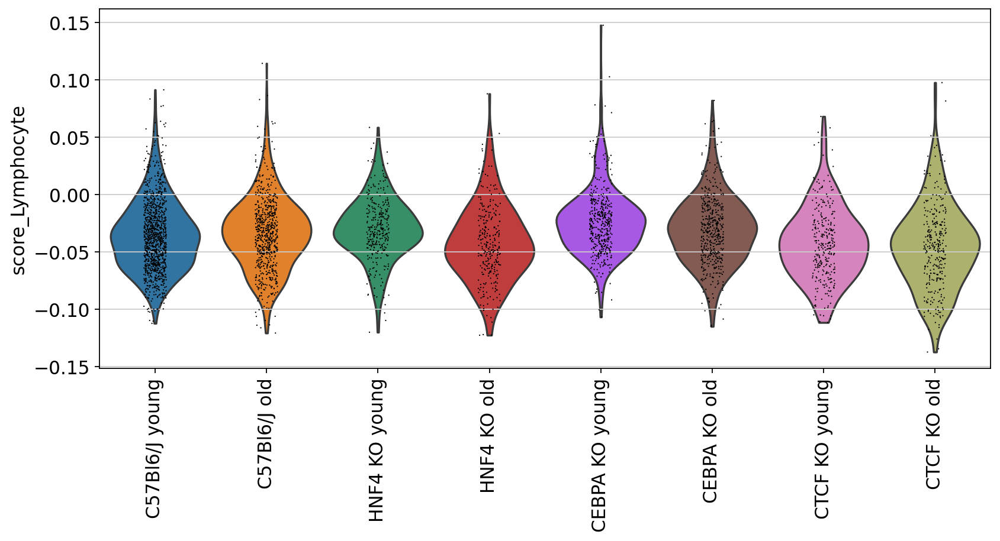

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


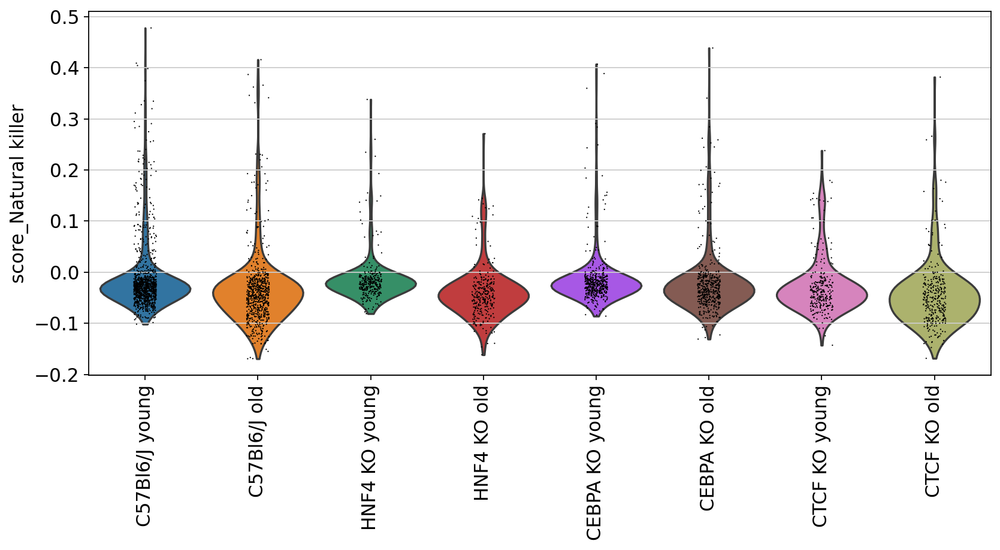

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


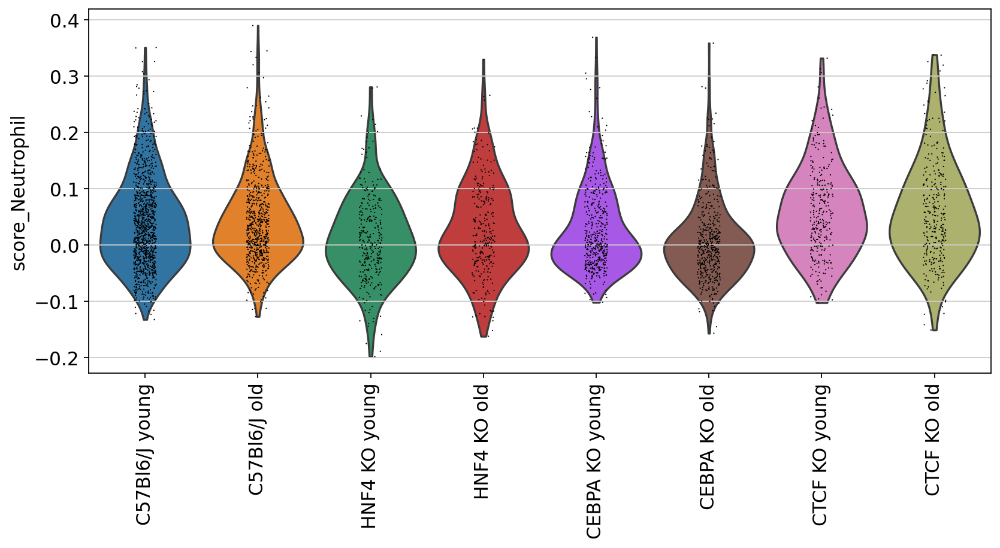

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


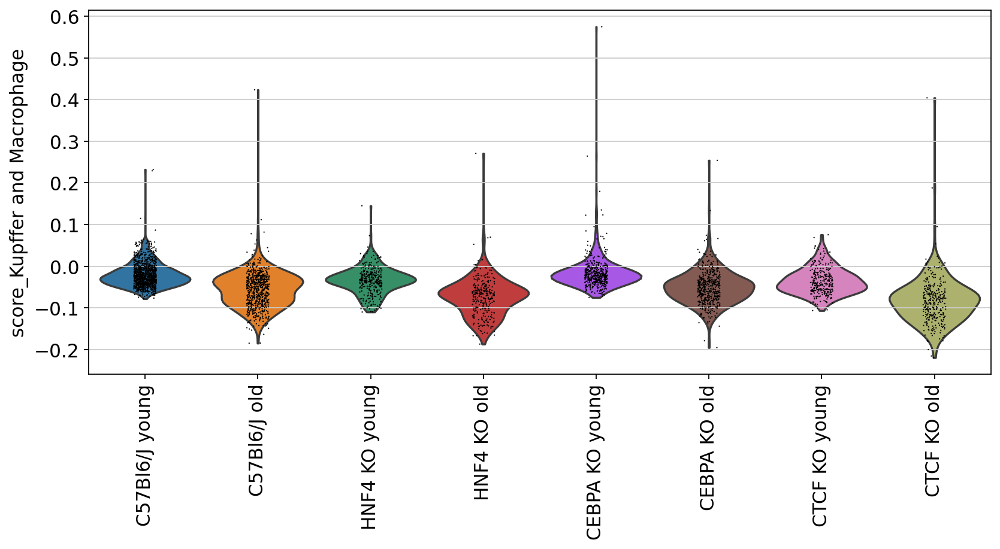

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


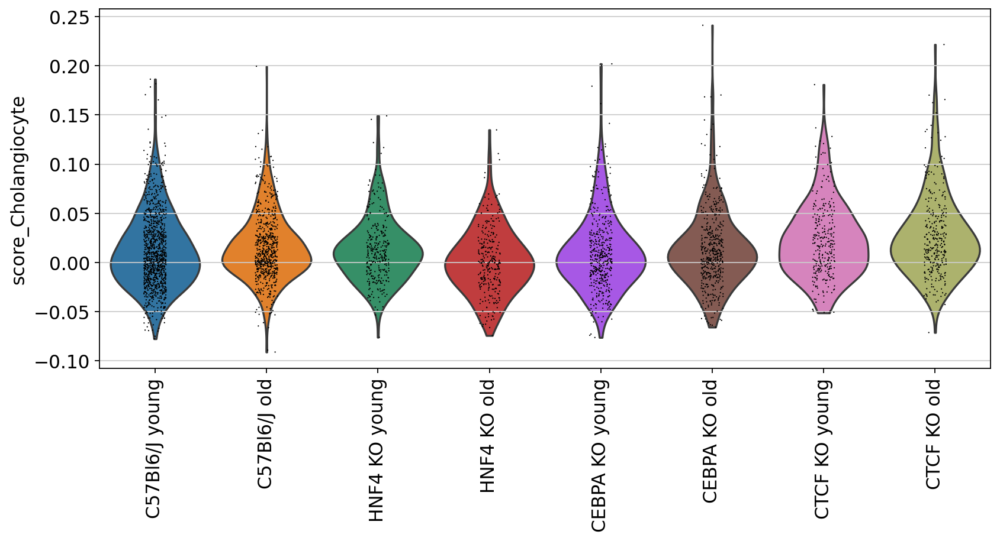

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


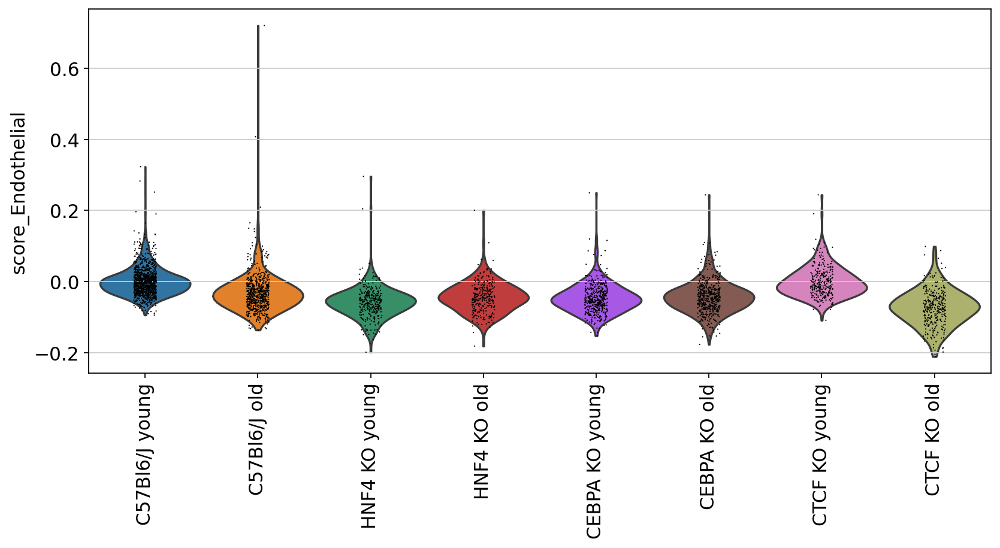

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


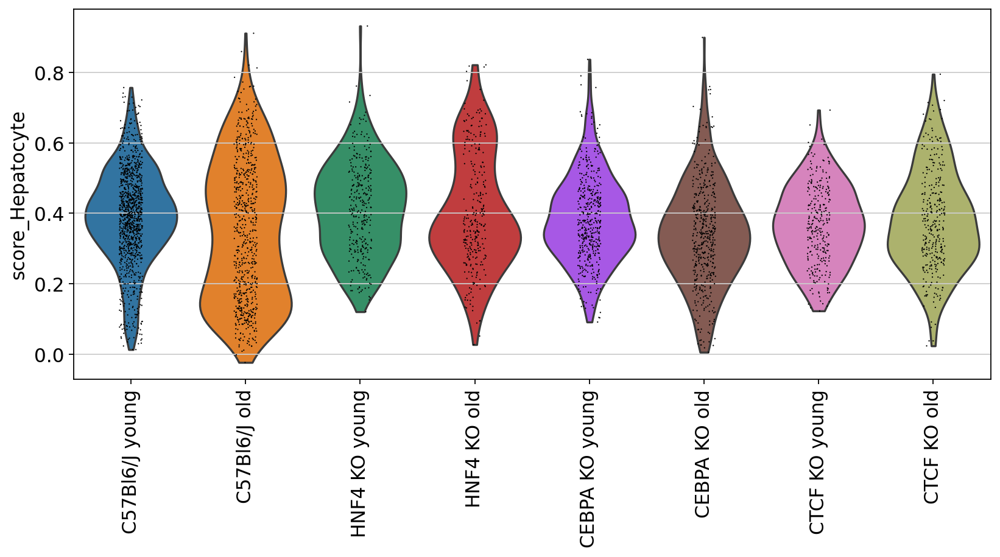

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


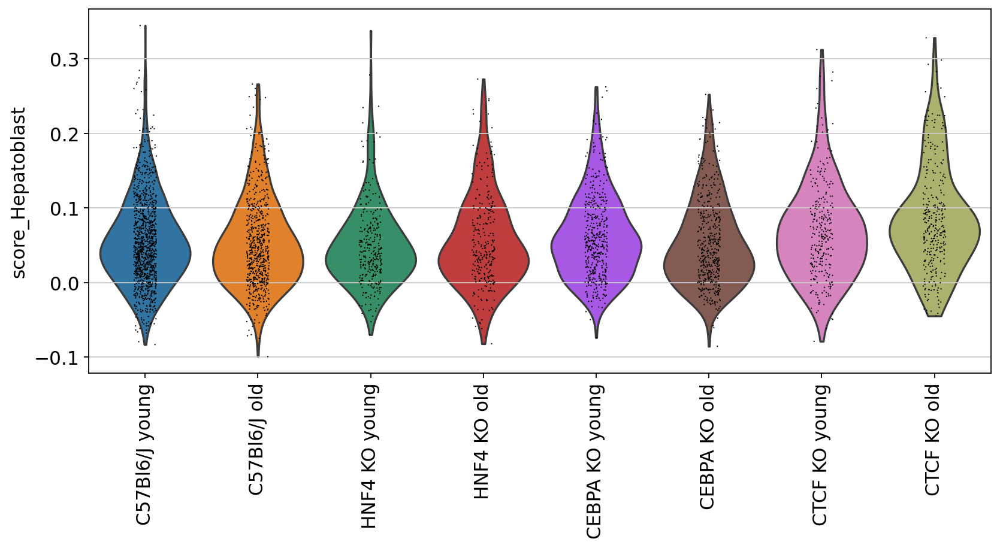

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


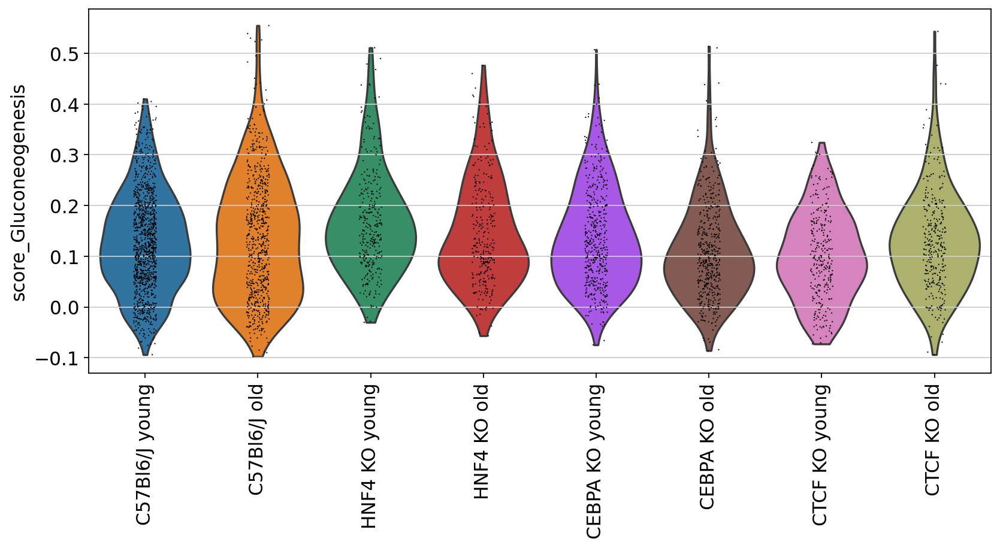

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


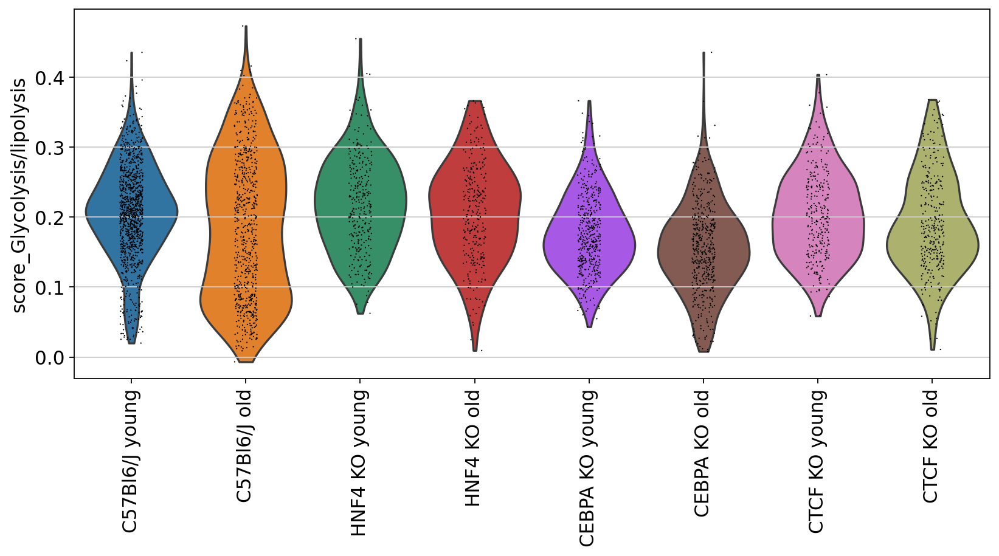

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


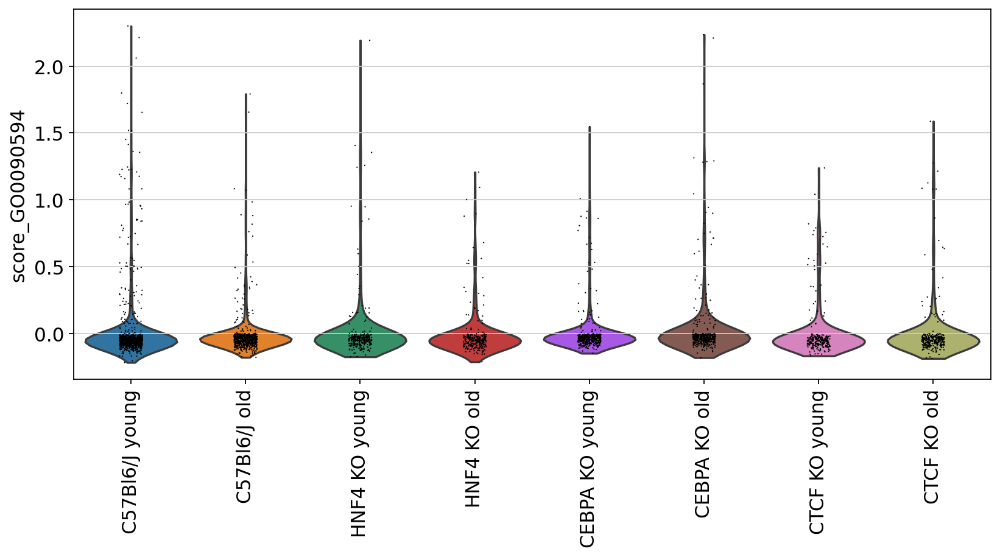

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


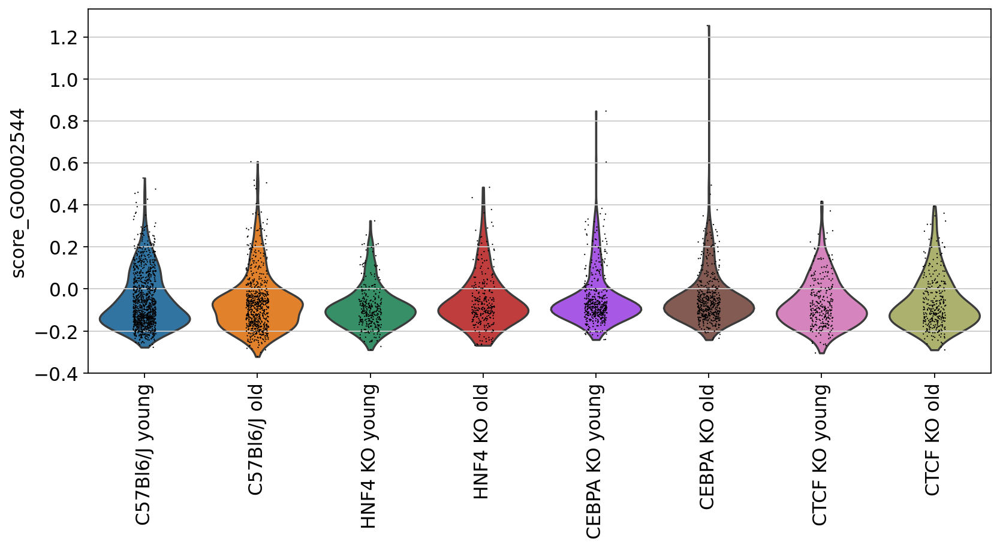

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


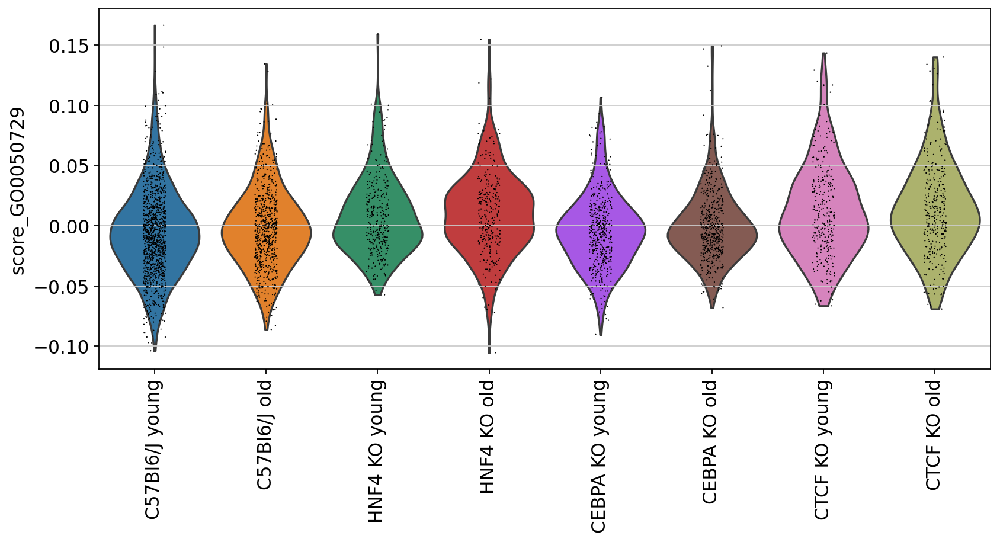

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


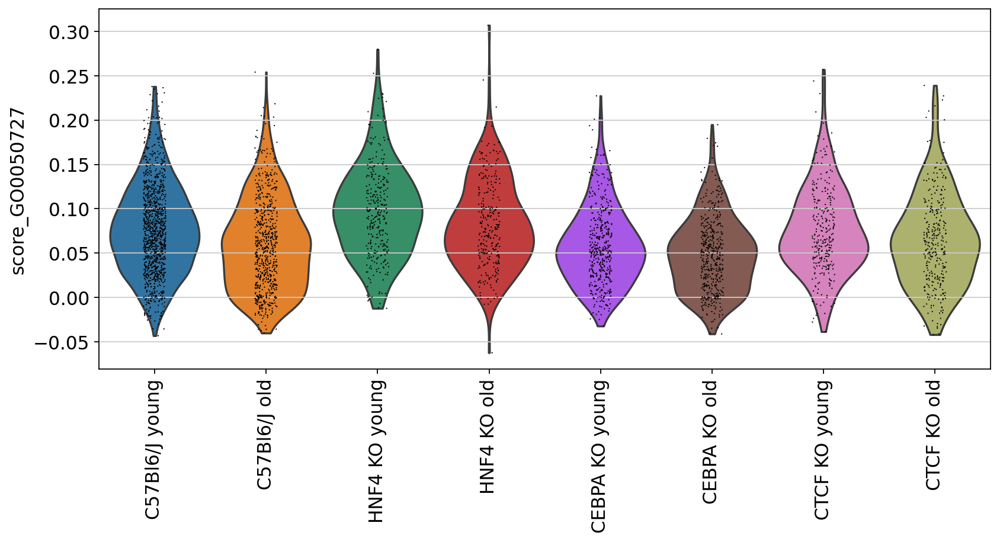

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


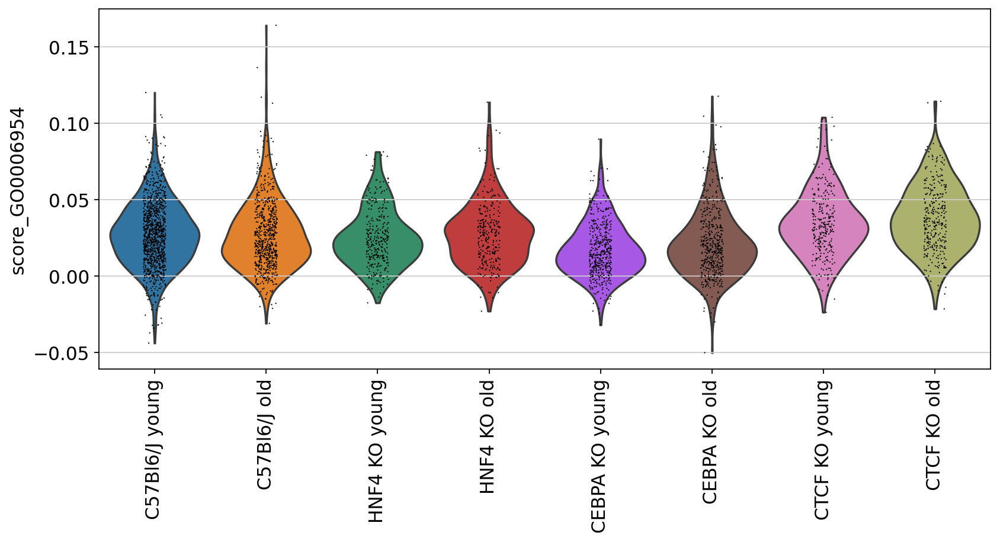

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


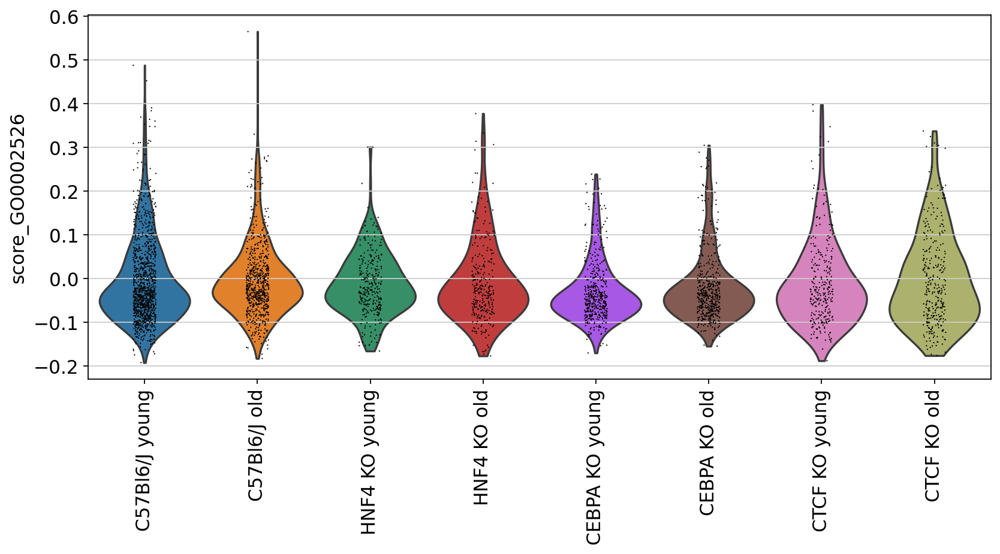

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


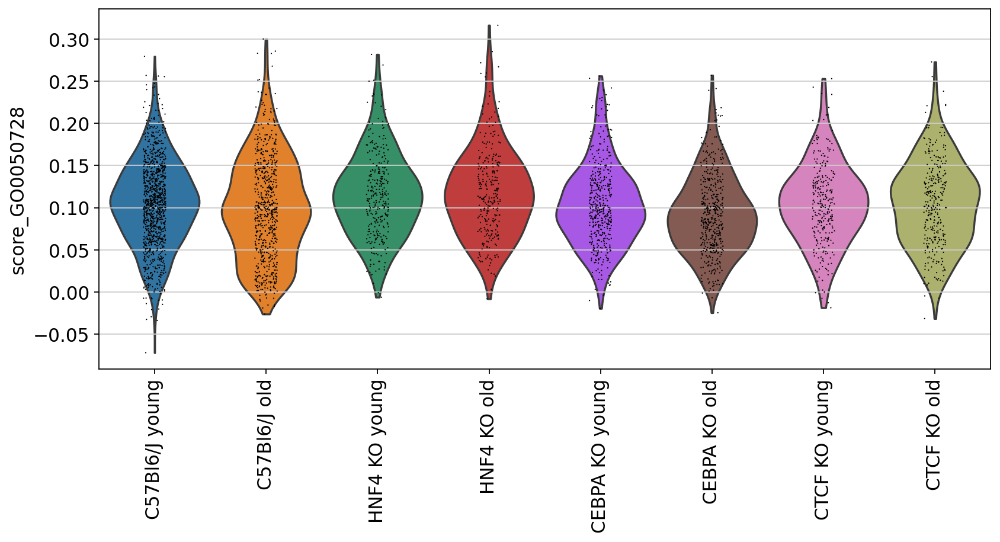

In [50]:
rcParams['figure.figsize']=(10,5)
for score in adata_hep.obs.keys():
    if score.startswith('score_'):
        sc.pl.violin(adata_hep, use_raw=False, 
                     keys=score, groupby='strain_age', rotation=90,
                     save=today +'_' + score.replace('/', '-') +'_strain_age.pdf'
                    )

In [35]:
adata_all

AnnData object with n_obs × n_vars = 6605 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_B cells', 'score_Dendritic cell', 'score_Lymphocyte', 'score_Natural killer', 'score_Neutrophil', 'score_Kupffer and Macrophage', 'score_Cholangiocyte', 'score_Endothelial', 'score_Hepatocyte', 'score_Hepatoblast', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1', 'age_ploidy', 'strain_age_ploidy', 'strain_age'
    var: 'gene_name'
    uns: 'ERCC.dilution_colors', 'age_colors', 'age_grouped_colors', 'cell_t

### Plot hand-picked genes

Plot hand-picked genes (from DE analysis, created by Kelvin).

In [43]:
adata_hep.obs['strain_age'].cat.categories

Index(['C57Bl6/J young', 'C57Bl6/J old', 'HNF4 KO young', 'HNF4 KO old',
       'CEBPA KO young', 'CEBPA KO old', 'CTCF KO young', 'CTCF KO old'],
      dtype='object')

In [139]:
adata_hep.obs['strain_age'] = adata_hep.obs['strain_age'].cat.reorder_categories(['C57Bl6/J young', 'HNF4 KO young', 'CEBPA KO young','CTCF KO young',
                                                                                  'C57Bl6/J old', 'HNF4 KO old', 'CEBPA KO old','CTCF KO old'
                                                                                 ])

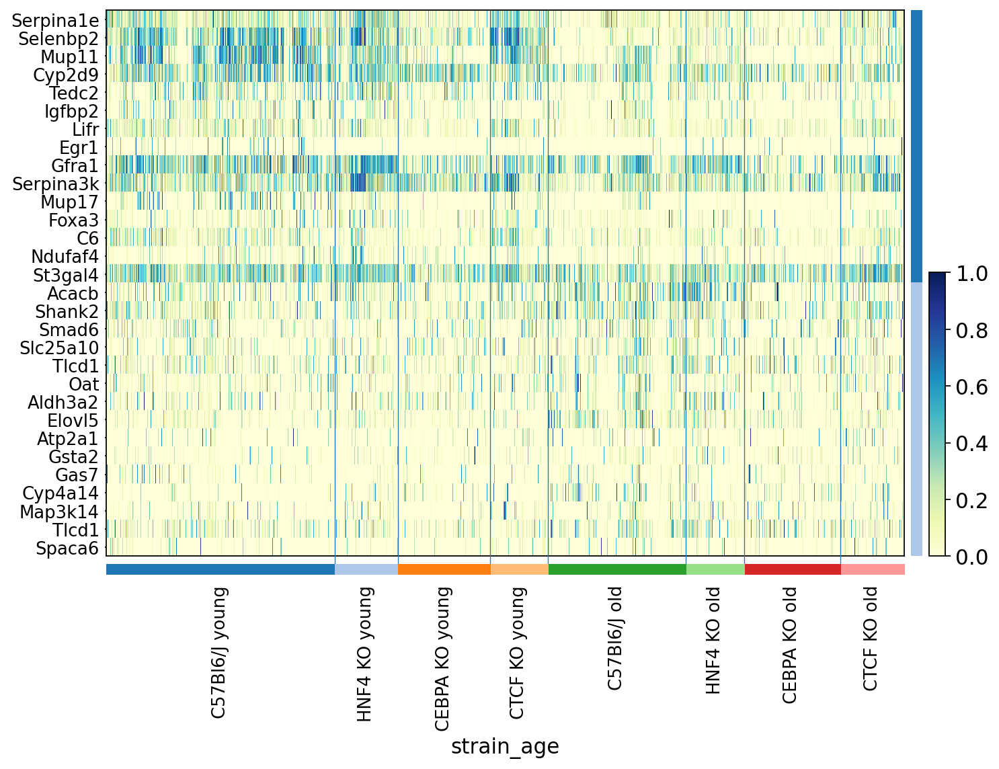

In [165]:

sc.pl.heatmap(adata_hep, figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age', swap_axes=True, 
              var_names = marker_DE_dict, cmap='YlGnBu',
              show_gene_labels=True, standard_scale='var',
              save = today + '_all_strains_age.pdf'
             )



In [44]:
adata_hep.obs['strain_age_ploidy'].cat.categories

Index(['C57Bl6/J young 2n', 'C57Bl6/J young 4n', 'C57Bl6/J old 2n',
       'C57Bl6/J old 4n', 'HNF4 KO young 2n', 'HNF4 KO young 4n',
       'HNF4 KO old 2n', 'HNF4 KO old 4n', 'CEBPA KO young 2n',
       'CEBPA KO young 4n', 'CEBPA KO old 2n', 'CEBPA KO old 4n',
       'CTCF KO young 2n', 'CTCF KO young 4n', 'CTCF KO old 2n',
       'CTCF KO old 4n'],
      dtype='object')

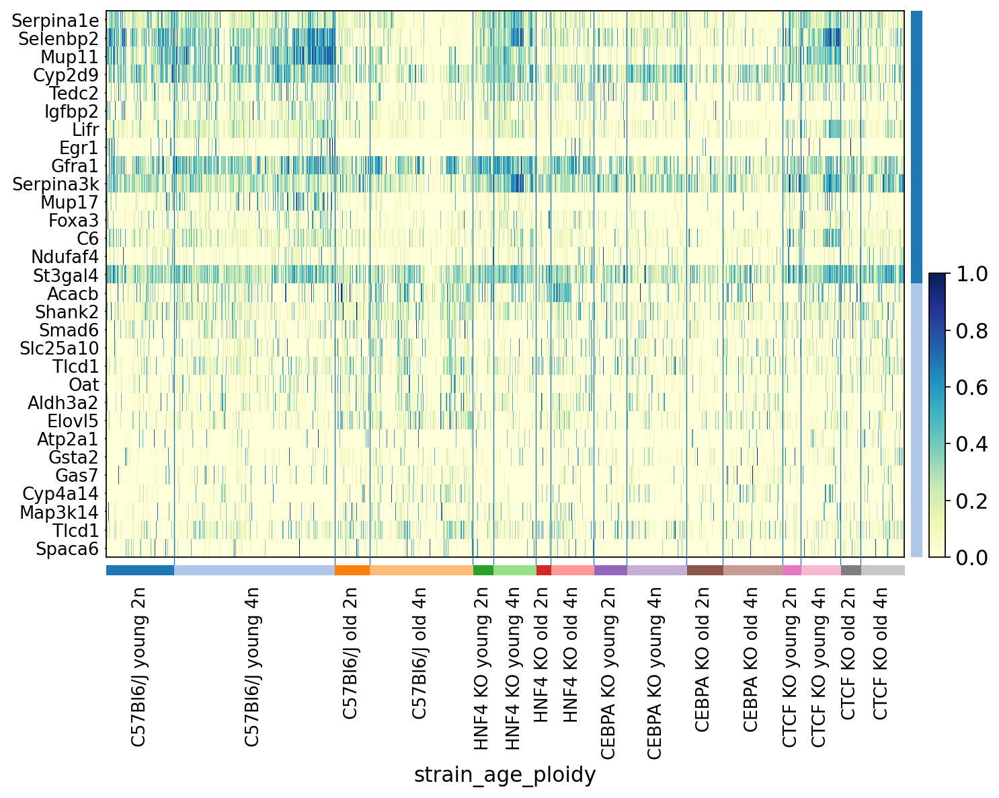

In [45]:

sc.pl.heatmap(adata_hep, figsize=(10,7),
              gene_symbols='gene_name', 
              groupby='strain_age_ploidy', swap_axes=True, 
              var_names = marker_DE_dict, cmap='YlGnBu',
              show_gene_labels=True, standard_scale='var',
              save = today + '_all_strains_age_ploidy.pdf'
             )



## Check cell numbers and dependency on transcript number

Check the overall counts split by age and cell type (incl. ploidy) to determine whether our filtering procedure admitted enough cells from old and young populations.

In [22]:
adata_all

AnnData object with n_obs × n_vars = 6605 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_B cells', 'score_Dendritic cell', 'score_Lymphocyte', 'score_Natural killer', 'score_Neutrophil', 'score_Kupffer and Macrophage', 'score_Cholangiocyte', 'score_Endothelial', 'score_Hepatocyte', 'score_Hepatoblast', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1', 'age_strain_ploidy'
    var: 'gene_name'
    uns: 'ERCC.dilution_colors', 'age_colors', 'age_grouped_colors', 'cell_type1_colors', 'cell_type_col

In [23]:
#ploidy + age + strain
age_strain_ploidy = [adata_all.obs['age_grouped'][idx] + ' ' + adata_all.obs['strain'][idx] + 
                     ' ' + adata_all.obs['ploidy'][idx] for idx in range(adata_all.n_obs)]

In [24]:
adata_all.obs['age_strain_ploidy'] = age_strain_ploidy

Hepatocytes


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, 

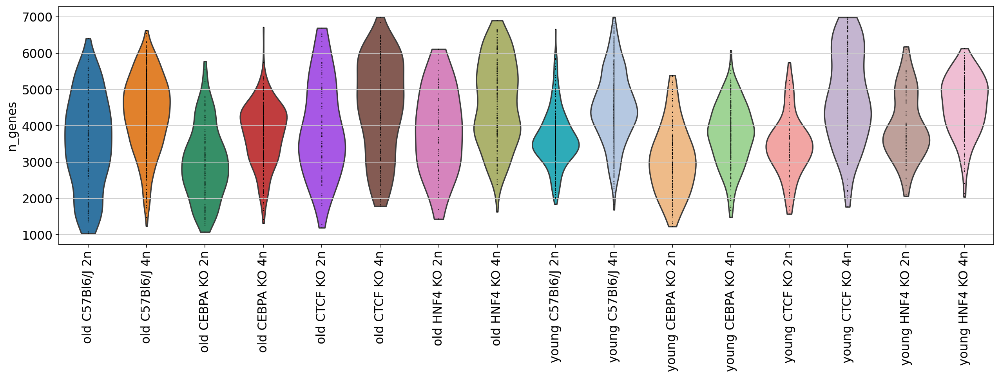

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.


Hepatobiliary cells


... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From ver

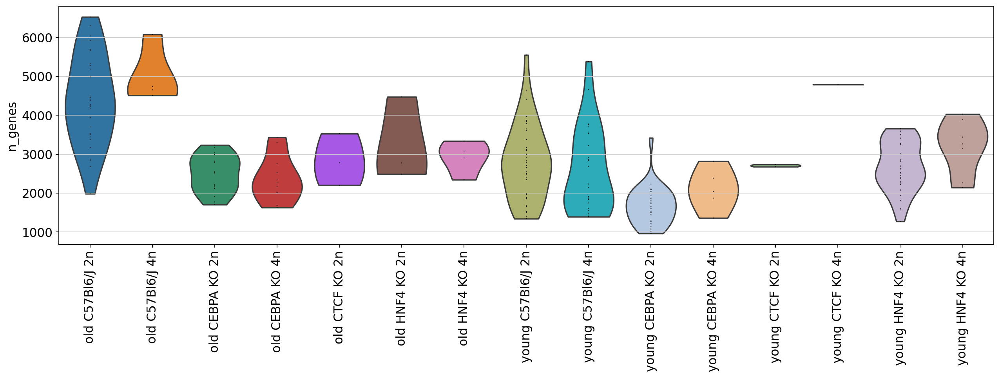

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.


Endothelial cells


... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From ver

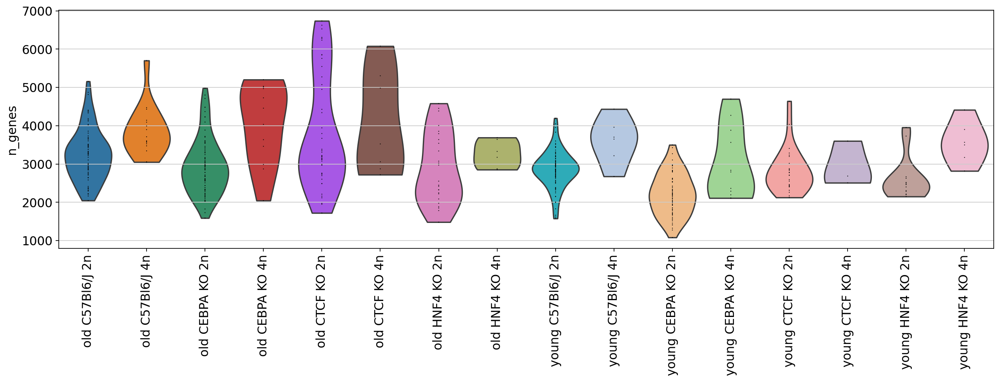

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.


Kupffer and Dendritic cells


... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From ver

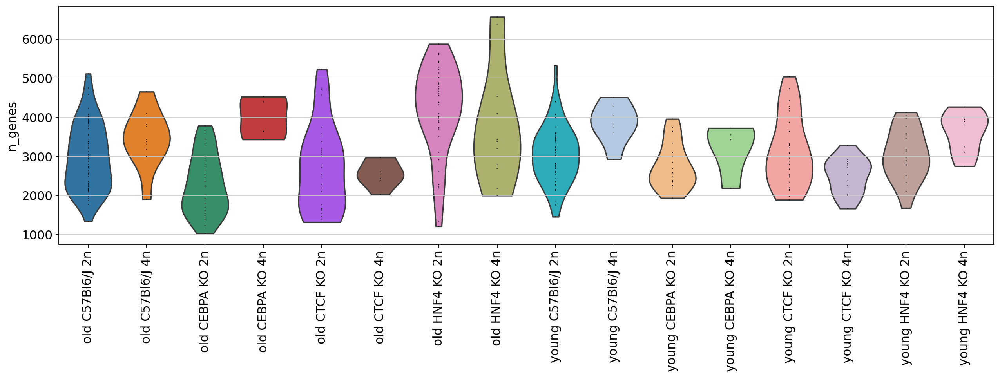

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.


Stellate cells


... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From ver

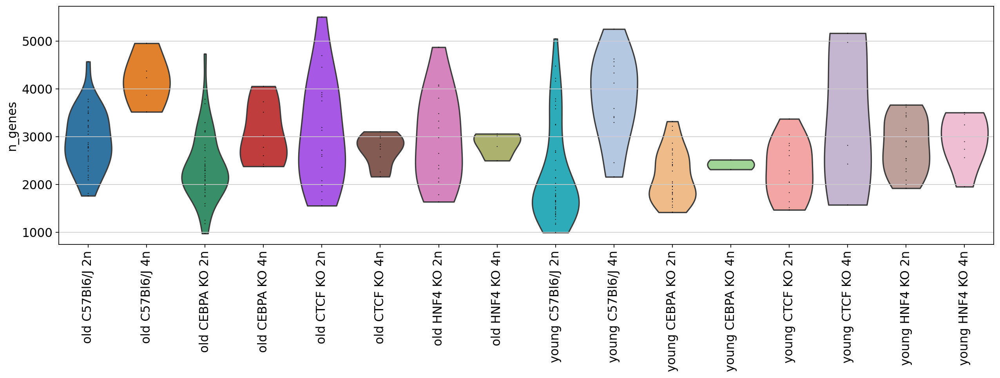

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.


Plasma B-cells


... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From ver

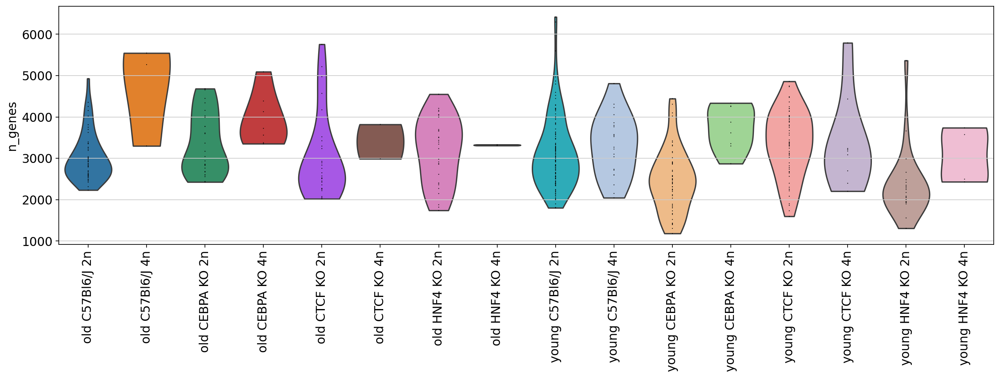

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.


B cells


... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From ver

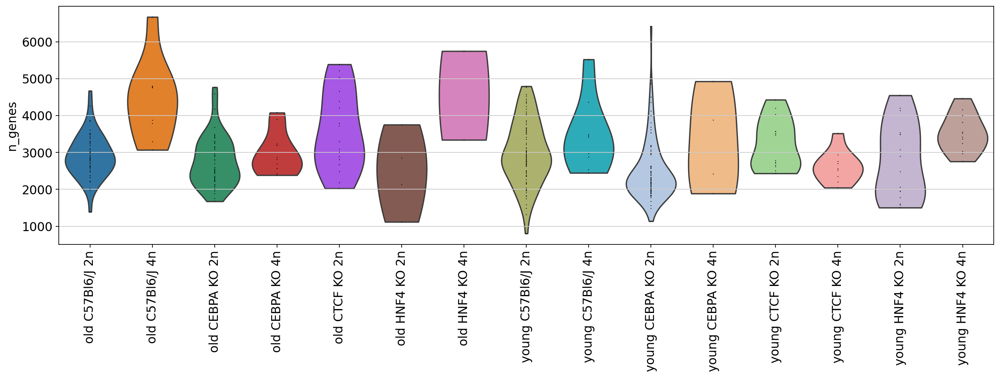

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.


T cells


... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From ver

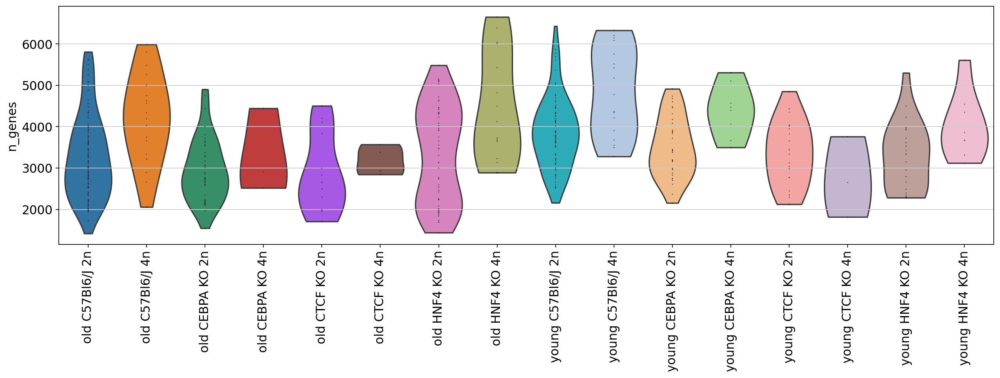

In [25]:
rcParams['figure.figsize']=(15,5)
for ct in adata_all.obs['cell_type1'].cat.categories:
    print(ct)
    sc.pl.violin(adata_all[adata_all.obs['cell_type1']==ct], 
                 keys=['n_genes'], jitter=False,
             groupby='age_strain_ploidy', rotation=90) #, 'age_grouped', 'ploidy'

Hepatocytes


Trying to set attribute `.obs` of view, copying.
... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the

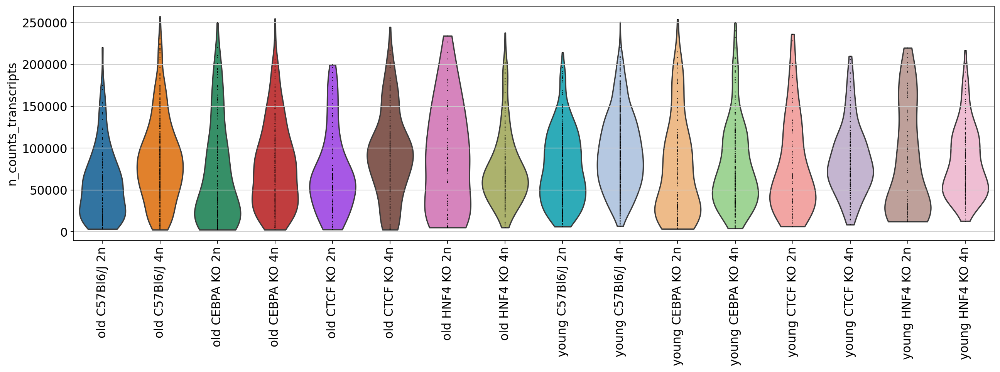

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.


Hepatobiliary cells


... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From ver

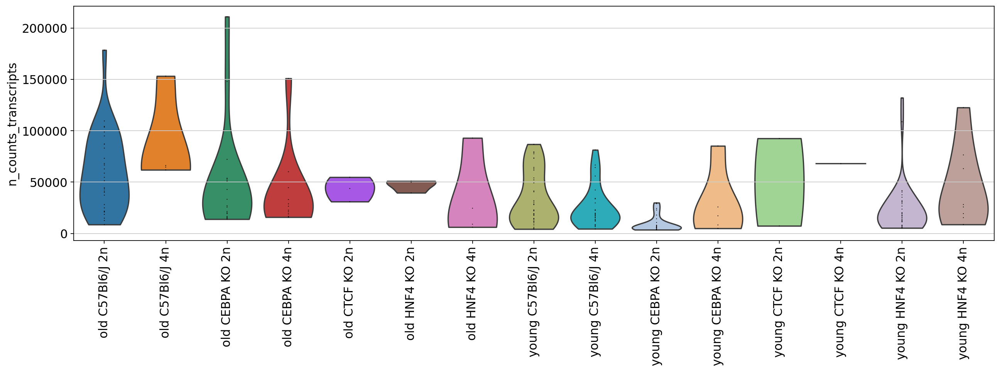

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.


Endothelial cells


... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From ver

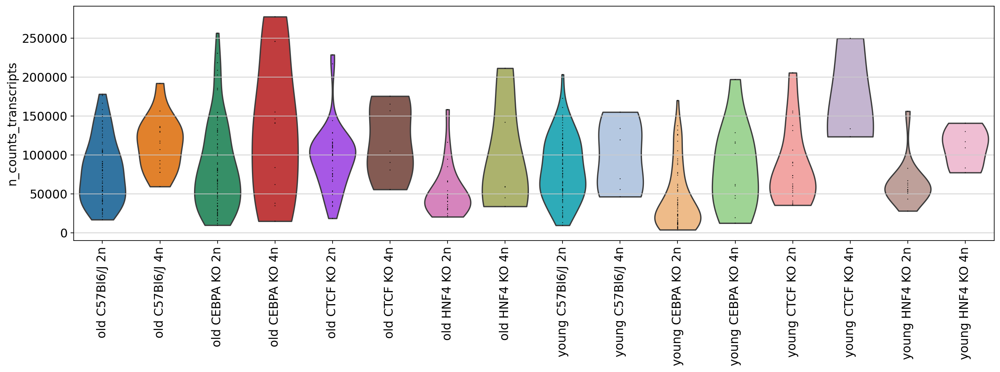

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.


Kupffer and Dendritic cells


... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From ver

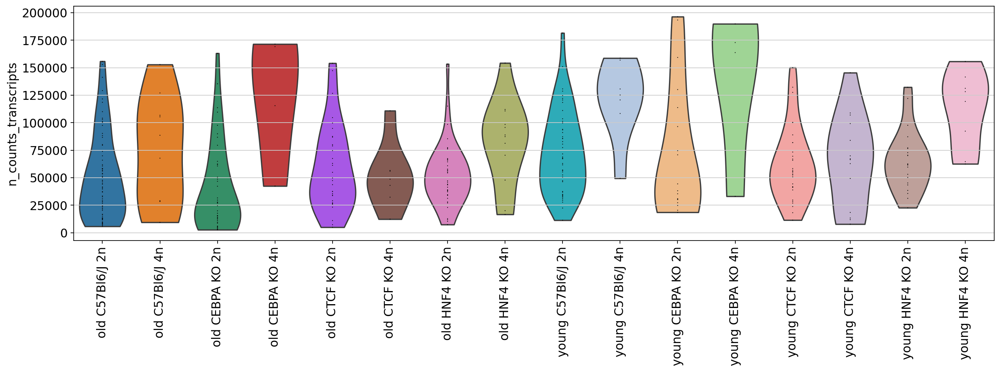

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.


Stellate cells


... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From ver

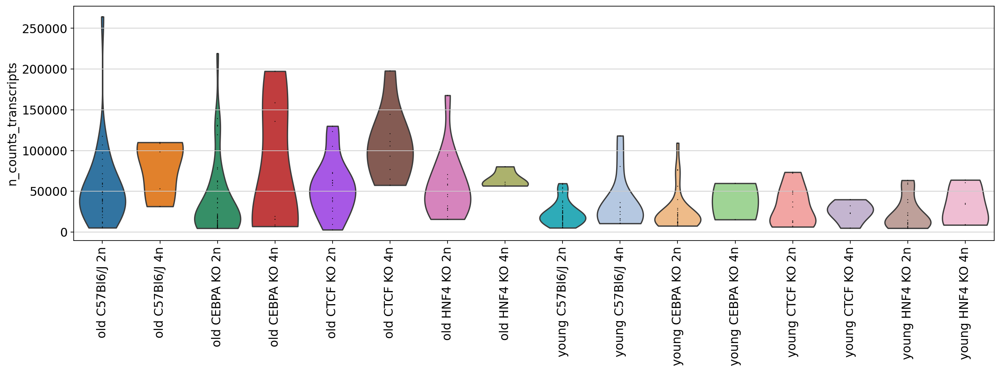

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.


Plasma B-cells


... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From ver

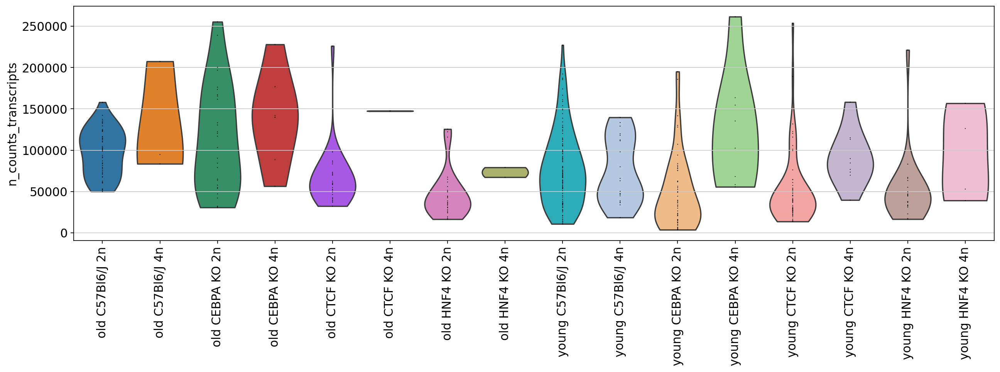

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.


B cells


... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From ver

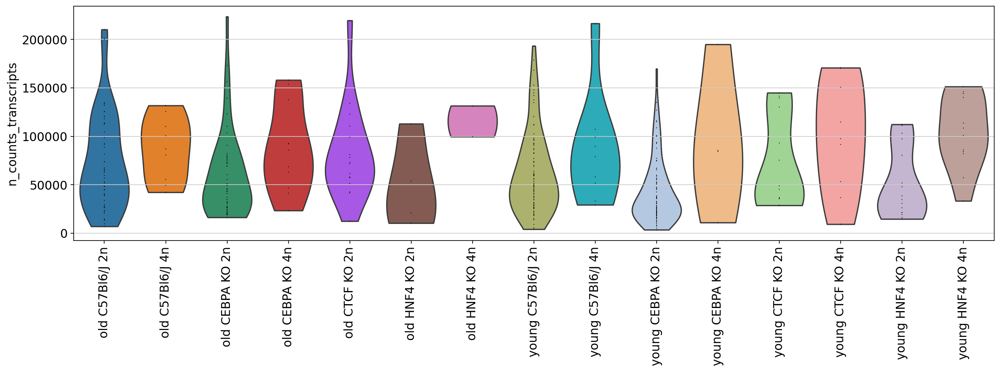

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.


T cells


... storing 'exp.' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'row' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_grouped' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cyclone_phases' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leiden_r1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'leidenr02_02' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'age_strain_ploidy' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From ver

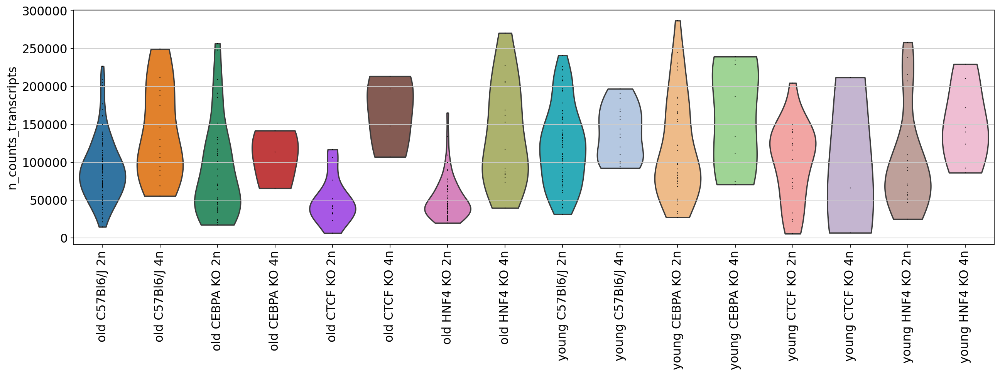

In [27]:
rcParams['figure.figsize']=(15,5)
for ct in adata_all.obs['cell_type1'].cat.categories:
    print(ct)
    sc.pl.violin(adata_all[adata_all.obs['cell_type1']==ct], 
                 keys=['n_counts_transcripts'], jitter=False,
             groupby='age_strain_ploidy', rotation=90) #, 'age_grouped', 'ploidy'

# Visualise relevant gene sets

## Visualise KO target genes

In this step, we visualise relevant target genes for Hnf4a, Cebpa and Ctcf in the wild type population.

Load gene sets.

In [25]:
keys = ['Hnf4a', 'Cebpa', 'Ctcf']
KO_table = dict()
for key in keys:
    KO_table_tmp = list(pd.read_table(table_dir + 'KO target genes.csv', sep=';', 
                                       usecols=[key], squeeze=True).T.dropna())
    valid_genes = [gene  for gene in KO_table_tmp if np.in1d(gene, adata_hep.var['gene_name'])]
    KO_table[key] = valid_genes

Select wild type cells.

In [26]:
adata_hep_wt = adata_hep[adata_hep.obs.strain == 'C57Bl6/J'].copy()

In [27]:
adata_hep_wt

AnnData object with n_obs × n_vars = 1815 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_B cells', 'score_Dendritic cell', 'score_Lymphocyte', 'score_Natural killer', 'score_Neutrophil', 'score_Kupffer and Macrophage', 'score_Cholangiocyte', 'score_Endothelial', 'score_Hepatocyte', 'score_Hepatoblast', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1', 'age_ploidy', 'strain_age_ploidy', 'strain_age'
    var: 'gene_name'
    uns: 'ERCC.dilution_colors', 'cell_type1_colors', 'cell_type_colors', 'c

Compute number of cells that express a gene.

In [28]:
adata_hep_wt.raw.var['n_cells'] = np.sum(adata_hep_wt.raw.X>0, axis=0)

Plot only the target genes that are expressed in at least 15 hepatocytes.

In [138]:
cutoff = 15
for key in keys:
    KO_table_tmp = KO_table[key]
    expressed = [gene for gene in KO_table_tmp if 
                 adata_hep_wt.raw.var['n_cells'][np.where(adata_hep_wt.raw.var['gene_name'] == gene)[0][0]] > cutoff]
    figlen = np.floor(len(expressed)*0.7)
    sc.pl.stacked_violin(adata_hep_wt, groupby='age_ploidy',
                     gene_symbols='gene_name', 
                     var_names = expressed,
                     swap_axes=True, figsize=(4,figlen), 
                         title = key, show=False,
                         save= today + '_WT_KO_genes_cutoff_' +str(cutoff) + '_' + key + '_hepatocytes.pdf'
                    )

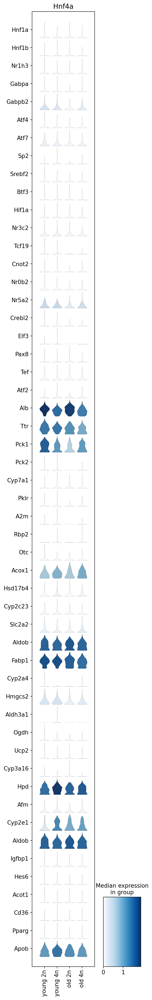

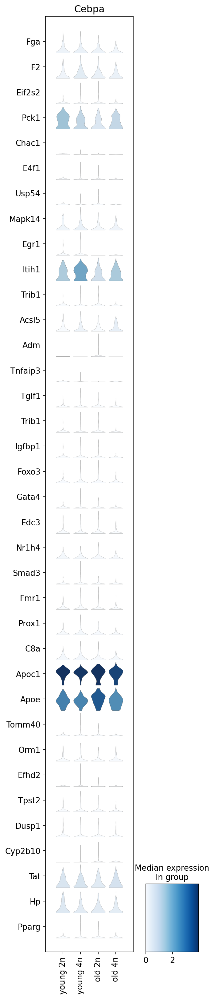

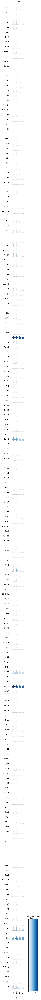

In [117]:
for key in keys:
    figlen = np.floor(len(KO_table[key])*0.7)
    sc.pl.stacked_violin(adata_hep_wt, groupby='age_ploidy',
                     gene_symbols='gene_name', 
                     var_names = KO_table[key],
                     swap_axes=True, figsize=(4,figlen), 
                         title = key,
                         save= today + '_WT_KO_genes_' + key + '_hepatocytes.pdf'
                    )

Plot violin plots for all hepatocytes.

Compute number of cells that express a gene.

In [139]:
adata_hep.raw.var['n_cells'] = np.sum(adata_hep.raw.X>0, axis=0)

In [143]:
cutoff = 15
for key in keys:
    KO_table_tmp = KO_table[key]
    expressed = [gene for gene in KO_table_tmp if 
                 adata_hep.raw.var['n_cells'][np.where(adata_hep.raw.var['gene_name'] == gene)[0][0]] > cutoff]
    figlen = np.floor(len(expressed)*0.7)
    figwidth = len(adata_hep.obs['strain_age_ploidy'].cat.categories)
    sc.pl.stacked_violin(adata_hep, groupby='strain_age_ploidy',
                     gene_symbols='gene_name', 
                     var_names = expressed,
                     swap_axes=True, figsize=(figwidth,figlen), 
                         title = key, show=False,
                         save= today + '_all_KO_genes_cutoff_' +str(cutoff) + '_' + key + '_hepatocytes.pdf'
                    )

## Visualise ageing related genes

Let us focus on wild type hepatocytes and plot ageing related genes.

Read in relevant gene sets.

In [29]:
ageing_table = pd.read_table(table_dir + 'Aging genes_tab1.csv', sep=';', usecols=['Gene name', 'Aging related change'])

In [30]:
ageing_table = ageing_table.drop([0])

Reduce to valid gene names (i.e. present in `var_names`).

In [31]:
ageing_table = ageing_table[np.in1d(ageing_table['Gene name'], adata_hep.var['gene_name'])]

Split ageing table by up and down regulated genes.

In [32]:
ageing = dict()
ageing['up'] = ageing_table['Gene name'][ageing_table['Aging related change']=='UP'].values
ageing['down'] = ageing_table['Gene name'][ageing_table['Aging related change']=='DOWN'].values

Read senescence genes.

In [33]:
senescence_table = pd.read_table(data_dir + 'Aging genes_tab2.csv', sep=';', usecols=['Gene'])

In [34]:
senescence_table.drop_duplicates(keep='first', inplace=True)

In [35]:
senescence_table.head()

,Gene
0,Abi3
1,Abl1
3,Akt3
4,Aldh1a3
5,Aopep


Filter out non-expressed genes.

In [36]:
senescence_table = senescence_table[np.in1d(senescence_table['Gene'], adata_hep.var['gene_name'])]

Read in inflammasome data (SASP).

In [37]:
sasp_table  = pd.read_table(data_dir + 'Aging genes_tab3.csv', sep=';').drop_duplicates(keep='first', inplace=False)

In [38]:
sasp_table.head()

,Inflammasome
0,Vegfa
1,Tnfrsf11b
3,Osm
4,Mif
5,Il7


Filter out non-expressed genes.

In [39]:
sasp_table = sasp_table[np.in1d(sasp_table['Inflammasome'], adata_hep.var['gene_name'])]

Read in Human gene set for SASP and query mouse gene names.

In [40]:
human_sasp_table = pd.read_table(data_dir + 'Aging genes_tab4.csv', sep=';').drop_duplicates(keep='first', inplace=False)

In [41]:
human_sasp_table.head()

,gene_id,gene_name
0,ENSG00000166920,C15ORF48
1,ENSG00000171631,P2RY6
2,ENSG00000163735,CXCL5
3,ENSG00000144802,NFKBIZ
4,ENSG00000171236,LRG1


In [42]:
tmp_genes = human_sasp_table['gene_name']
tmp_mouse = [gene.lower().capitalize() for gene in tmp_genes]

In [43]:
invalid_idx = np.where(np.invert(np.in1d(tmp_mouse, adata_hep.raw.var['gene_name'])))[0]

In [44]:
tmp_mouse_invalid = []
for idx in invalid_idx:
    tmp_mouse_invalid.append(tmp_mouse[idx])

Map "invalid" gene names to valid ones - the remaining ones are either not expressed or do not have a corresponding homologue or orthologue. This is especially problematic with lncRNAs ("AC...."):

In [45]:
gene_dict = {
    'C15orf48': 'AA467197', #Nmes1
    'Ac092675.3' : 'AC092675.1',
    'Ctc-231o11.1' : 'CTC-231O11.1', #lnc RNA
    'Ac002480.3' : 'AC002480.3',
    'Ac147651.4' : 'AC147651.4',
    'C1r' : 'C1ra',
    'Fcgr2a' : 'Fcgr2',
    'C1orf95' : 'Stum',
    'Ppap2b' : 'Plpp3',
    'C1s': 'C1sa',
    'Ctc-378h22.1' : 'CTC-378H22.1',
    'Mt2a' : 'Mt2',
    'Mt1x' : 'Mt1',
    'Cyp3a5' : 'Cyp3a11', #P450 cytochrome superfamily, closest hit
    'Ccrn4l' : 'Noct', #Nocturnin precursor
    'C8orf4' : 'Tcim',
    'Glt25d1' : 'Colgalt1',
    'C9orf150' : 'Lurap1l', 
    'Chst6' : 'Chst5', #homologue
    'Mar 03' : 'Marchf3', #ENSG00000173926 converted into data by excel
    'Fam150b' : 'Alkal2',
    'Obfc2a' : 'Nabp1',
    'Emr2' : 'Adgre2',
    'Serpina3' : 'Serpina3n',
    'Ap001062.7' : 'Tlr7', #Toll-like receptor precursor
    'Mycl1': 'Mycl',
    'Mrgprx4' : 'Mrgprx1', #orthologue
    'C3orf33' : 'E130311K13Rik',
    'Kiaa1199' : 'Cemip',
    'C7orf43': 'Trappc14', #aka BC037034
    'Gemin8p4' : 'Gemin8', #by similarity
    'Cxcr7' : 'Ackr3',
    'Slc9a7p1' : 'Slc9a7',
    'Fam40b' : 'Strip2',
    'C9orf64': '2210016F16Rik',
    'Pppde2': 'Desi1',
    'Kiaa0247': 'Susd6',
    'Cbwd5': 'Cbwd1', #by similarity
    'Fam108c1': '2210412D01Rik', #by similarity
    'Ulbp2': 'Ulbp1',
    'Sqrdl': 'Sqor',
    'C12orf39': 'Spx',
    'Iglv1-51': 'Iglv1'
}

In [46]:
for idx in gene_dict.keys():
    #get index in tmp_mouse:
    didx = np.flatnonzero(np.in1d(tmp_mouse,idx))[0]
    #replace invalid names
    tmp_mouse[didx] = gene_dict[idx]

Keep only valid gene names, though.

In [47]:
valid_idx = np.where(np.in1d(tmp_mouse, adata_hep.raw.var['gene_name']))[0]

In [48]:
human_sasp = []
for idx in valid_idx:
    human_sasp.append(tmp_mouse[idx])

In [49]:
len(human_sasp)

396

In [50]:
len(tmp_mouse)

499

In [51]:
sasp = {'mouse_sasp' : list(sasp_table['Inflammasome'].values),
        'human_sasp' : human_sasp 
       }

Summarize all target genes in one table.

In [91]:
#KO_table
#ageing
#senescence_table
#sasp
all_genes = pd.DataFrame(columns = ['Gene symbol', 'Task'])
#KO target genes
for key in KO_table.keys():
    repeat_string = ['Target ' + key for idx in range(len(KO_table[key]))]
    tmp = pd.DataFrame(data = {'Gene symbol' : KO_table[key], 'Task' : repeat_string})
    all_genes = all_genes.append(tmp, ignore_index=True)

#ageing related genes    
for key in ageing.keys():
    repeat_string = ['Ageing ' + key + ' regulated' for idx in range(len(ageing[key]))]
    tmp = pd.DataFrame(data = {'Gene symbol' : ageing[key], 'Task' : repeat_string})
    all_genes = all_genes.append(tmp, ignore_index=True)

#senescence related genes
repeat_string = ['Senescence' for idx in range(len(senescence_table))]
tmp = pd.DataFrame(data = {'Gene symbol' : senescence_table['Gene'].values, 'Task' : repeat_string})
all_genes = all_genes.append(tmp, ignore_index=True)

#sasp related genes
for key in sasp.keys():
    repeat_string = [key.replace('_', ' ')  for idx in range(len(sasp[key]))]
    tmp = pd.DataFrame(data = {'Gene symbol' : sasp[key], 'Task' : repeat_string})
    all_genes = all_genes.append(tmp, ignore_index=True)

In [93]:
all_genes.Task.value_counts()

human sasp               396
Ageing up regulated      284
Target Ctcf              203
Senescence               115
Ageing down regulated    108
Target Hnf4a              52
mouse sasp                44
Target Cebpa              36
Name: Task, dtype: int64

In [94]:
all_genes.to_csv(data_dir + 'gene_lists-target-ageing-senescence-sasp.csv')

## Plot ageing related genes in WT

In [271]:
cutoff = 15
keys = ageing.keys()
for key in keys:
    KO_table_tmp = ageing[key]
    expressed = [gene for gene in KO_table_tmp if 
                 adata_hep_wt.raw.var['n_cells'][np.where(adata_hep_wt.raw.var['gene_name'] == gene)[0][0]] > cutoff]
    figlen = np.floor(len(expressed)*0.7)
    sc.pl.stacked_violin(adata_hep_wt, groupby='age_ploidy',
                     gene_symbols='gene_name', 
                     var_names = expressed,
                     swap_axes=True, figsize=(4,figlen), 
                         title = key, show=False,
                         save= today + '_WT_aging_genes_' + key + '_cutoff_' +str(cutoff)  + '_hepatocytes.pdf'
                    )

## Plot senescence related genes in WT

In [274]:
cutoff = 15

expressed = [gene for gene in senescence_table['Gene'] if 
                 adata_hep_wt.raw.var['n_cells'][np.where(adata_hep_wt.raw.var['gene_name'] == gene)[0][0]] > cutoff]
figlen = np.floor(len(expressed)*0.7)
sc.pl.stacked_violin(adata_hep_wt, groupby='age_ploidy',
                     gene_symbols='gene_name', 
                     var_names = expressed,
                     swap_axes=True, figsize=(4,figlen), 
                         title = key, show=False,
                         save= today + '_WT_senescence_genes_cutoff_' +str(cutoff)  + '_hepatocytes.pdf'
                    )

{'mainplot_ax': <AxesSubplot:>,
 'color_legend_ax': <AxesSubplot:title={'center':'Median expression\nin group'}>}

Plot senescence markers in endothelial cells.

In [70]:
adata_tmp = adata_all[adata_all.obs['cell_type']=='Endothelial cells'].copy()
#compute number of cells that express the gene
adata_tmp.raw.var['n_cells'] = np.sum(adata_tmp.raw.X>0, axis=0)

In [73]:
cutoff = 15

expressed = [gene for gene in senescence_table['Gene'] if 
                 adata_tmp.raw.var['n_cells'][np.where(adata_tmp.raw.var['gene_name'] == gene)[0][0]] > cutoff]
figlen = np.floor(len(expressed)*0.7)
sc.pl.stacked_violin(adata_tmp, groupby='strain_age',
                     gene_symbols='gene_name', 
                     var_names = expressed,
                     swap_axes=True, figsize=(8,figlen), 
                         title = 'senescence', show=False,
                         save= today + '_all_senescence_genes_cutoff_' +str(cutoff)  + '_Endothelial.pdf'
                    )

{'mainplot_ax': <AxesSubplot:>,
 'color_legend_ax': <AxesSubplot:title={'center':'Median expression\nin group'}>}

## Plot SASP inflammasome related genes in WT

In [51]:
cutoff = 10
keys = sasp.keys()
for key in keys:
    KO_table_tmp = sasp[key]
    expressed = [gene for gene in KO_table_tmp if 
                 adata_hep_wt.raw.var['n_cells'][np.where(adata_hep_wt.raw.var['gene_name'] == gene)[0][0]] > cutoff]
    figlen = np.floor(len(expressed)*0.7)
    sc.pl.stacked_violin(adata_hep_wt, groupby='age_ploidy',
                     gene_symbols='gene_name', 
                     var_names = expressed,
                     swap_axes=True, figsize=(4,figlen), 
                         title = key, show=False,
                         save= today + '_WT_SASP_genes_' + key + '_cutoff_' +str(cutoff)  + '_hepatocytes.pdf'
                    )

### Plot SASP inflammosome info for hepatobiliary, Kupffer, stellate, endothelial cells

In [53]:
adata_all.obs['cell_type1'].cat.categories

Index(['Hepatocytes', 'Hepatobiliary cells', 'Endothelial cells',
       'Kupffer and Dendritic cells', 'Stellate cells', 'Plasma B-cells',
       'B cells', 'T cells'],
      dtype='object')

In [67]:
cutoff = 10
keys = sasp.keys()
cell_types = ['Hepatocytes', 'Hepatobiliary cells', 'Endothelial cells',
       'Kupffer and Dendritic cells', 'Stellate cells']
for cell_type in cell_types:
    adata_tmp = adata_all[adata_all.obs['cell_type1']==cell_type].copy()
    #compute number of cells that express the gene
    adata_tmp.raw.var['n_cells'] = np.sum(adata_tmp.raw.X>0, axis=0)
    for key in keys:
        KO_table_tmp = sasp[key]
        expressed = [gene for gene in KO_table_tmp if 
                     adata_tmp.raw.var['n_cells'][np.where(adata_tmp.raw.var['gene_name'] == gene)[0][0]] > cutoff]
        figlen = np.floor(len(expressed)*0.5)
        sc.pl.stacked_violin(adata_tmp, groupby='strain_age_ploidy',
                     gene_symbols='gene_name', 
                     var_names = expressed,
                     swap_axes=True, figsize=(4,figlen), 
                         title = key, show=False,
                         save= today + '_all_SASP_genes_' + key + '_cutoff_' +str(cutoff)  + '_'+ cell_type.split(' ')[0]+'.pdf'
                    )

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


In [68]:
cutoff = 10
keys = sasp.keys()
cell_types = ['Hepatobiliary cells', 'Endothelial cells',
       'Kupffer and Dendritic cells', 'Stellate cells']
for cell_type in cell_types:
    adata_tmp = adata_all[adata_all.obs['cell_type1']==cell_type].copy()
    #compute number of cells that express the gene
    adata_tmp.raw.var['n_cells'] = np.sum(adata_tmp.raw.X>0, axis=0)
    for key in keys:
        KO_table_tmp = sasp[key]
        expressed = [gene for gene in KO_table_tmp if 
                     adata_tmp.raw.var['n_cells'][np.where(adata_tmp.raw.var['gene_name'] == gene)[0][0]] > cutoff]
        figlen = np.floor(len(expressed)*0.5)
        sc.pl.stacked_violin(adata_tmp, groupby='strain_age',
                     gene_symbols='gene_name', 
                     var_names = expressed,
                     swap_axes=True, figsize=(4,figlen), 
                         title = key, show=False,
                         save= today + '_all_SASP_genes_' + key + '_cutoff_' +str(cutoff)  + '_woploidy_'+ cell_type.split(' ')[0]+'.pdf'
                    )

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


# Visualise relevant and significantly different gene sets

Importantly, we want to examine the relevant genes, which are also significantly different across conditions. For this purpose, we load the results of the differential expression tests (see notebook 03_DE_test.ipynb). 

Load DE test results. We tested with the `rank_genes_groups` function differences in ploidy (2n vs 4n in otherwise matched populations), differences in age (young vs old in otherwise matched populations) and differences in strains (WT vs KO in otherwise matched populations).

# Correlation analysis KO vs WT

In [60]:
adata_hep.obs['strain'].cat.categories

Index(['C57Bl6/J', 'CEBPA KO', 'CTCF KO', 'HNF4 KO'], dtype='object')

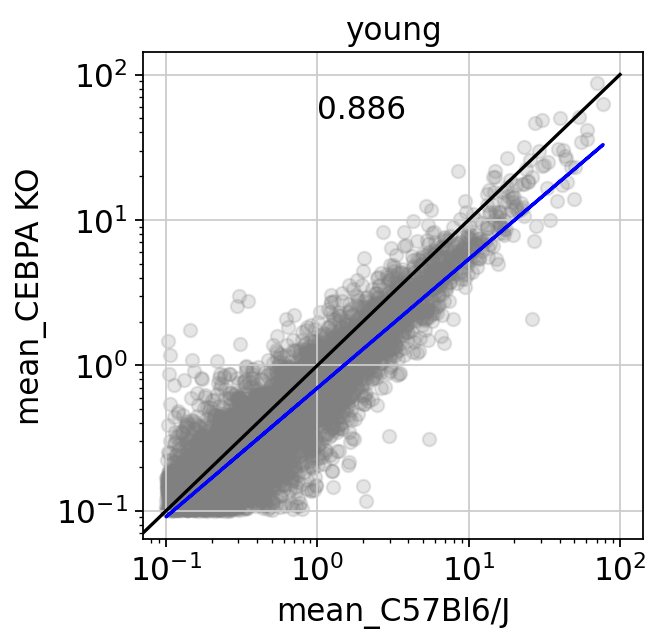

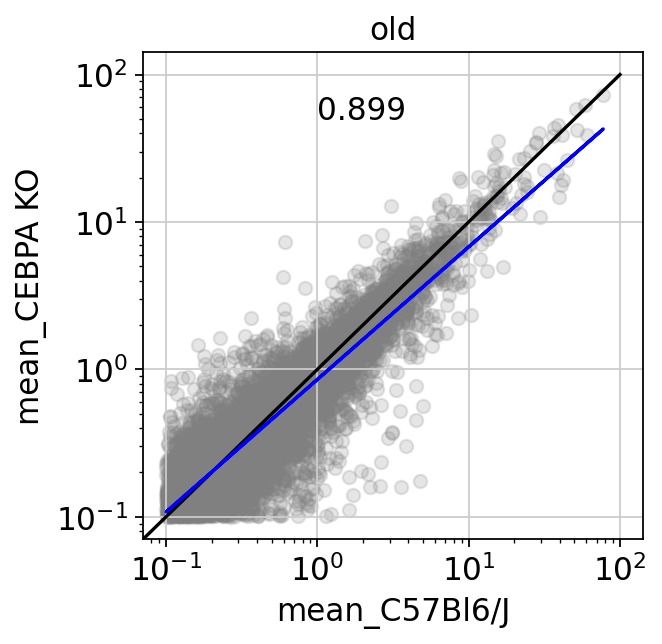

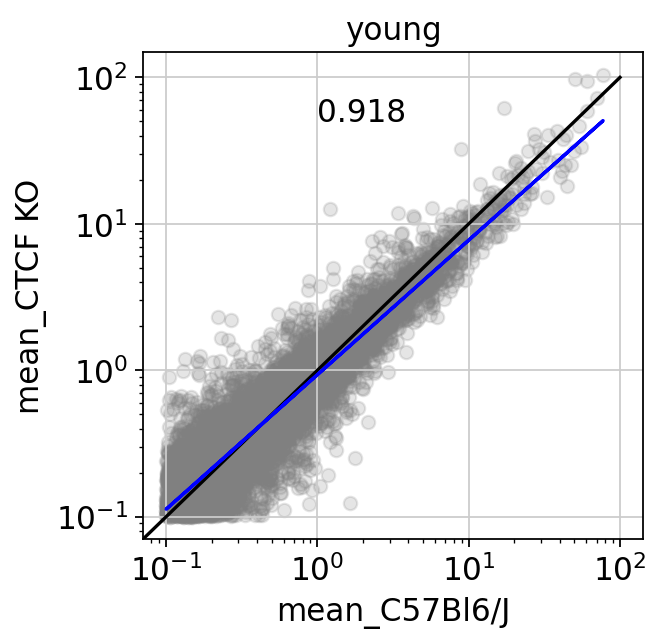

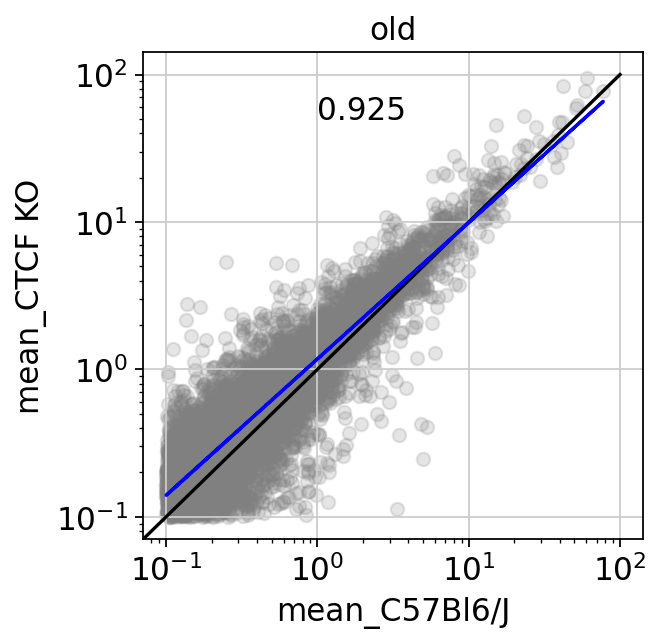

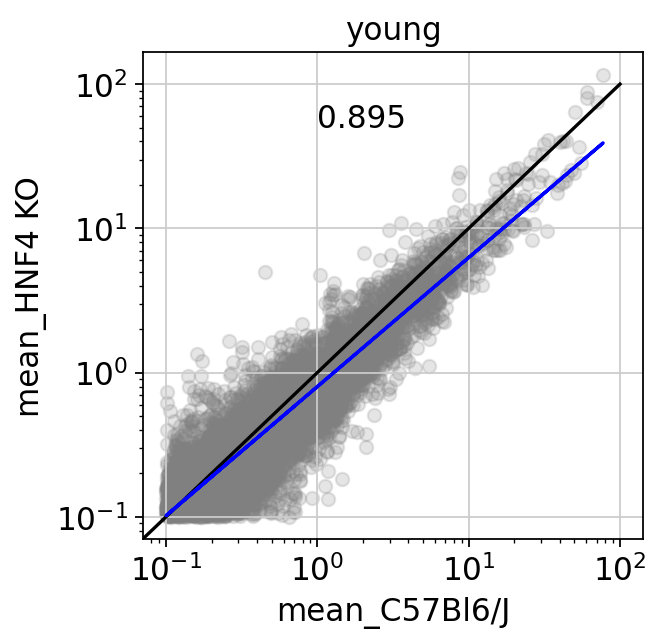

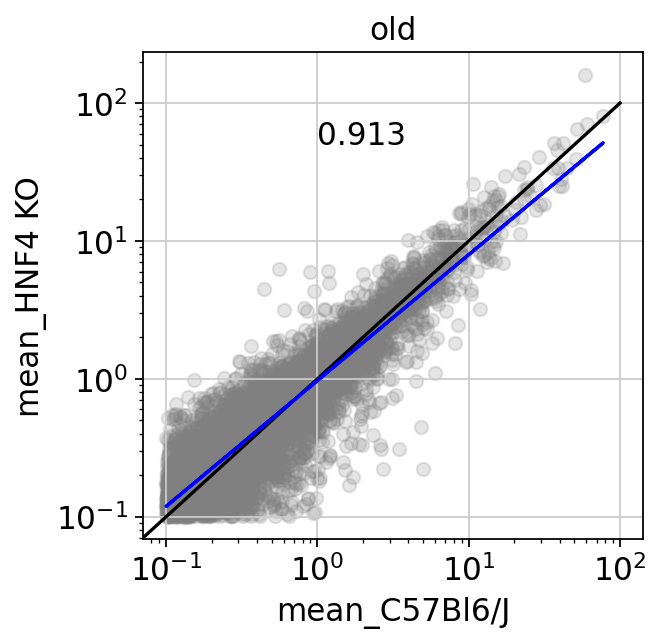

In [61]:
strain_keys =  'CEBPA KO', 'CTCF KO', 'HNF4 KO'
wild_type = 'C57Bl6/J'

for strain_key in strain_keys:
    for age_key in ['young', 'old']:
        adata_tmp = adata_hep[np.logical_and(np.in1d(adata_hep.obs['strain'], [wild_type, strain_key]), 
                              adata_hep.obs['age_grouped']==age_key)].copy()
               
        for idx, elem in enumerate(adata_tmp.obs['strain'].cat.categories):
            adata_tmp.var[elem+"_mean"] = np.mean(adata_tmp[adata_tmp.obs["strain"] == elem,:].layers["norm_counts"], axis=0)
        
        df = pd.DataFrame()
        df["mean_"+ wild_type] = adata_tmp.var[wild_type + "_mean"]
        df["mean_" +strain_key] = adata_tmp.var[strain_key + "_mean"]
        df.index = adata_tmp.var.index
        df1 = df[df["mean_"+ wild_type] > 0.1]
        df1 = df1[df1["mean_"+ wild_type] < 100]
        df2 = df1[df1["mean_" +strain_key] > 0.1]
        df2 = df2[df2["mean_"+ wild_type] < 100]
        
        #do the correlation analysis
        X = df2["mean_"+ wild_type].values.reshape(-1, 1)  # values converts it into a numpy array
        Y = df2["mean_" +strain_key].values.reshape(-1, 1)  # -1 means that calculate the dimension of rows, but have 1 column
        linear_regressor = LinearRegression()  # create object for the class
        linear_regressor.fit(np.log(X), np.log(Y))  # perform linear regression
        Y_pred = np.exp(linear_regressor.predict(np.log(X)))  # make predictions
        
        fig = plt.scatter(x=df2["mean_"+ wild_type], y=df2["mean_" +strain_key], c='grey', alpha=0.2)
        
        plt.xscale("log")
        plt.yscale("log")
        plt.xlabel("mean_"+ wild_type)
        plt.ylabel("mean_"+ strain_key)
        plt.title(age_key)
        ident = [0.0, 100]
        plt.plot(ident,ident, color="k")
        plt.text(1,50, str(np.round(linear_regressor.coef_[0][0], 3)))
        plt.plot(X, Y_pred, color='blue')
        plt.savefig("./figures/"+today + "_KO_" + strain_key.replace('/', '') + '_vs_WT_' + age_key + "_all_hepatocytes.pdf")
        plt.show()
        

# Correlation analysis for 2n and 4n hepatocytes

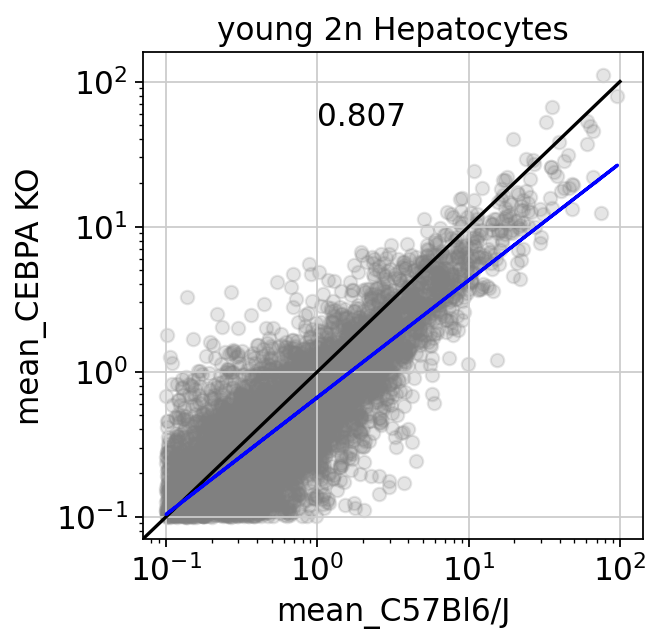

0 C57Bl6/J
1 CEBPA KO


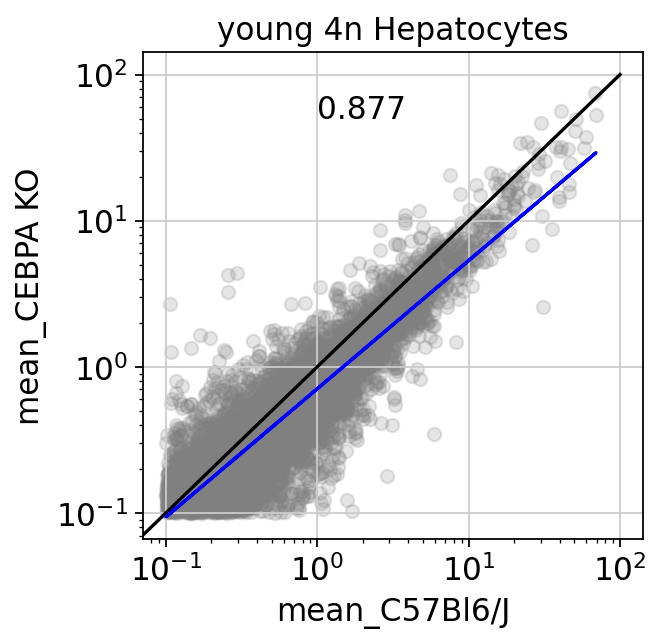

0 C57Bl6/J
1 CEBPA KO


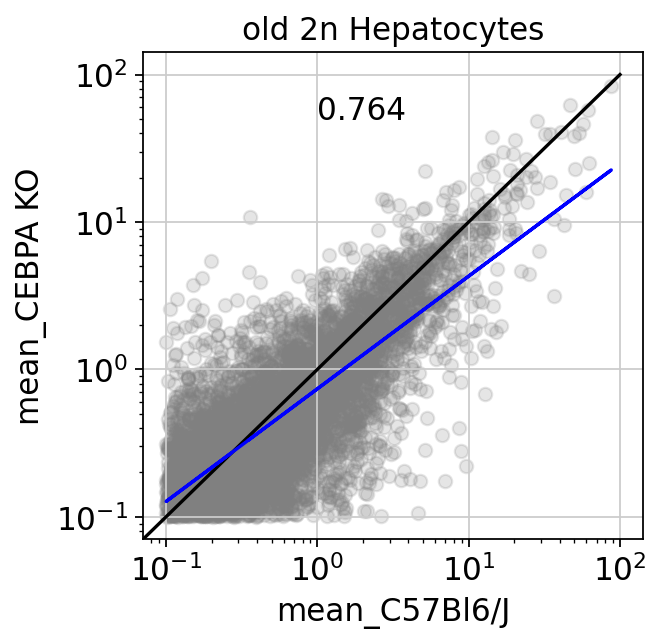

0 C57Bl6/J
1 CEBPA KO


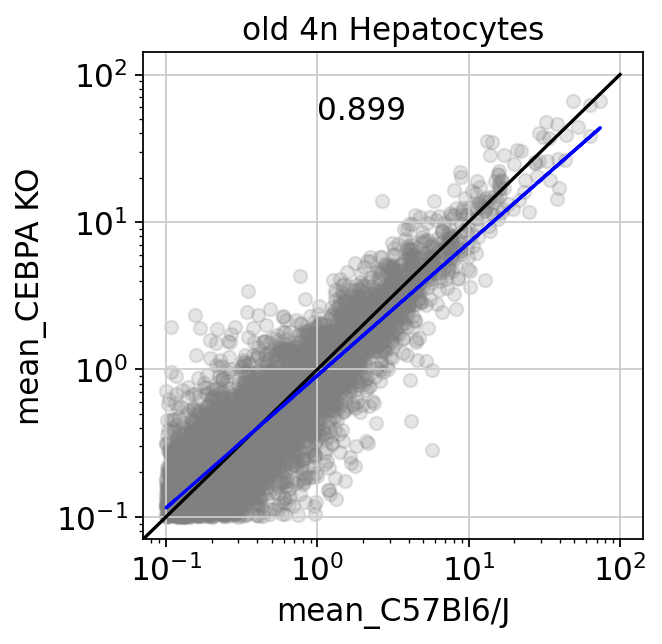

0 C57Bl6/J
1 CEBPA KO


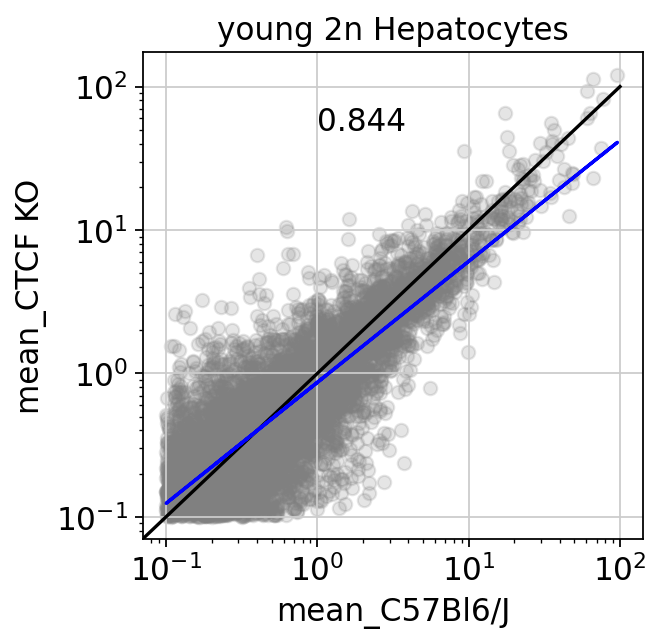

0 C57Bl6/J
1 CTCF KO


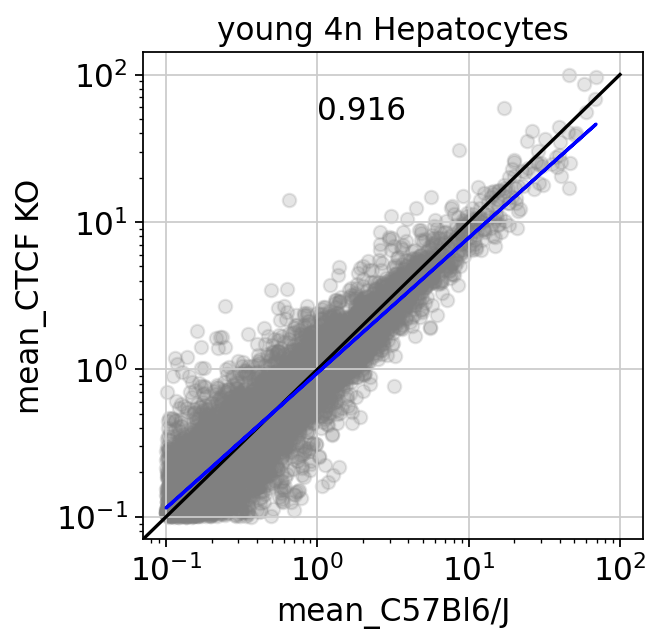

0 C57Bl6/J
1 CTCF KO


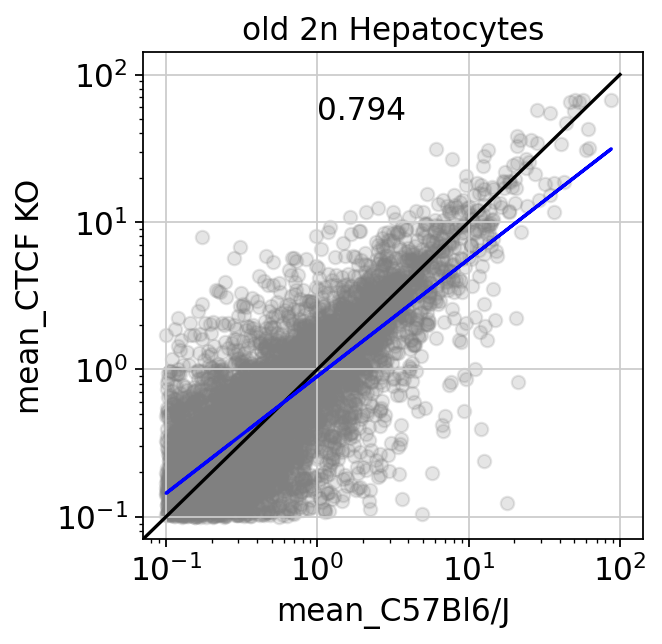

0 C57Bl6/J
1 CTCF KO


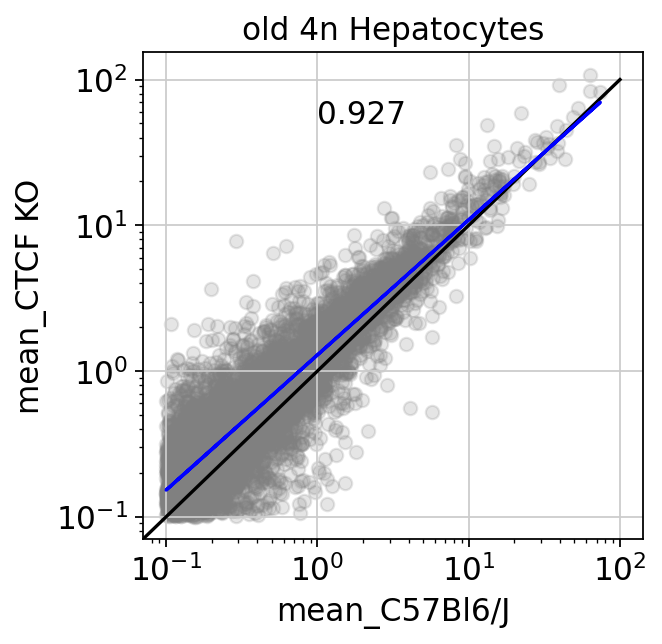

0 C57Bl6/J
1 CTCF KO


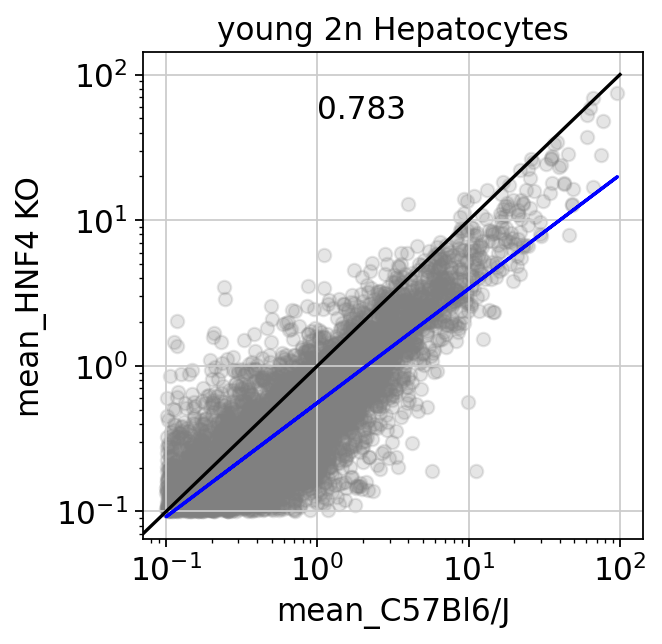

0 C57Bl6/J
1 HNF4 KO


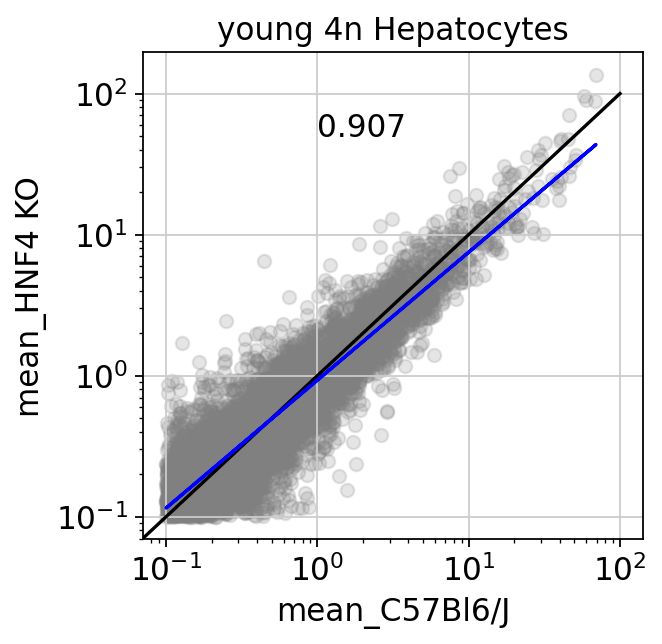

0 C57Bl6/J
1 HNF4 KO


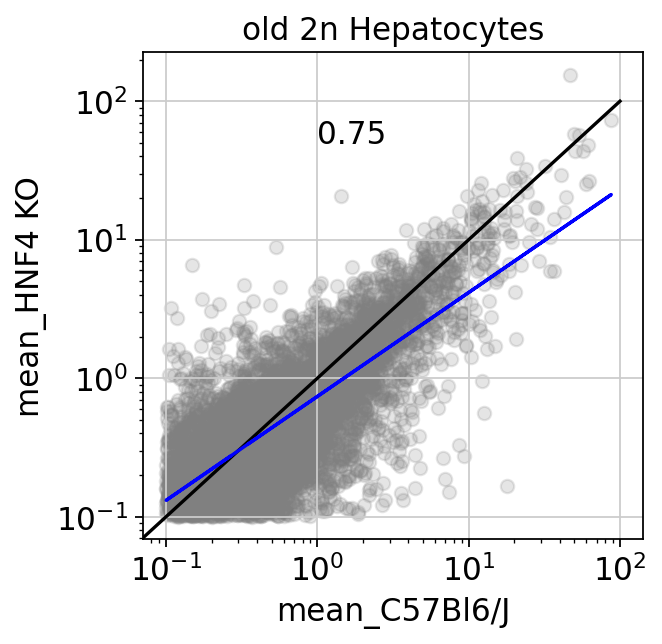

0 C57Bl6/J
1 HNF4 KO


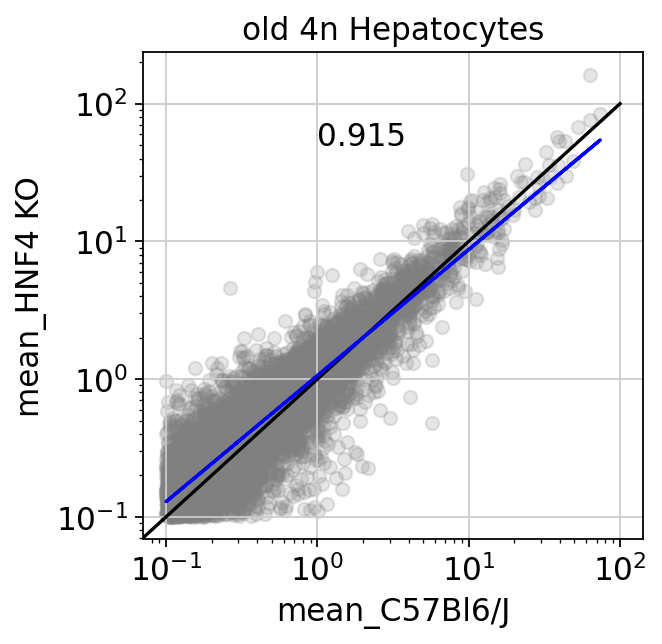

0 C57Bl6/J
1 HNF4 KO


In [62]:
strain_keys =  'CEBPA KO', 'CTCF KO', 'HNF4 KO'
wild_type = 'C57Bl6/J'

for strain_key in strain_keys:
    for age_key in ['young', 'old']:
        for cell_type_key in adata_hep.obs['cell_type'].cat.categories:
            adata_tmp = adata_hep[np.logical_and(np.logical_and(np.in1d(adata_hep.obs['strain'], [wild_type, strain_key]), 
                              adata_hep.obs['age_grouped']==age_key),
                                                adata_hep.obs['cell_type']==cell_type_key)].copy()
               
            for idx, elem in enumerate(adata_tmp.obs['strain'].cat.categories):
                adata_tmp.var[elem+"_mean"] = np.mean(adata_tmp[adata_tmp.obs["strain"] == elem,:].layers["norm_counts"], axis=0)
            
            
            
            #prepare data for mean expression plots
            df = pd.DataFrame()
            df["mean_"+ wild_type] = adata_tmp.var[wild_type + "_mean"]
            df["mean_" +strain_key] = adata_tmp.var[strain_key + "_mean"]
            df.index = adata_tmp.var.index
            df1 = df[df["mean_"+ wild_type] > 0.1]
            df1 = df1[df1["mean_"+ wild_type] < 100]
            df2 = df1[df1["mean_" +strain_key] > 0.1]
            df2 = df2[df2["mean_"+ wild_type] < 100]
        
            #do the correlation analysis
            X = df2["mean_"+ wild_type].values.reshape(-1, 1)  # values converts it into a numpy array
            Y = df2["mean_" +strain_key].values.reshape(-1, 1)  # -1 means that calculate the dimension of rows, but have 1 column
            linear_regressor = LinearRegression()  # create object for the class
            linear_regressor.fit(np.log(X), np.log(Y))  # perform linear regression
            Y_pred = np.exp(linear_regressor.predict(np.log(X)))  # make predictions
        
            fig = plt.scatter(x=df2["mean_"+ wild_type], y=df2["mean_" +strain_key], c='grey', alpha=0.2)
        
            plt.xscale("log")
            plt.yscale("log")
            plt.xlabel("mean_"+ wild_type)
            plt.ylabel("mean_"+ strain_key)
            plt.title(age_key + ' ' + cell_type_key)
            ident = [0.0, 100]
            plt.plot(ident,ident, color="k")
            plt.plot(X, Y_pred, color='blue')
            plt.text(1,50, str(np.round(linear_regressor.coef_[0][0], 3)))
            plt.savefig("./figures/"+today+"_KO_" + strain_key.replace('/', '') + '_vs_WT_' + age_key + "_" + cell_type_key + ".pdf")
            plt.show()
            
            #DE test
            sc.tl.rank_genes_groups(adata_tmp, groupby="strain", n_genes=adata_tmp.n_vars)
            dict_genes = adata_tmp.uns["rank_genes_groups"].copy()
    
            df = {}
            for idx, elem in enumerate(list(dict_genes["names"].dtype.names)):
                print(idx, elem)
                df[elem+"_gene"] = []
                df[elem+"_logfoldchange"] = []
                df[elem+"_pval_adj"] = []
                for j in range(0, len(adata_tmp.var)):
                    df[elem+"_gene"].append(dict_genes["names"][j][idx])
                    df[elem+"_logfoldchange"].append(dict_genes["logfoldchanges"][j][idx])
                    df[elem+"_pval_adj"].append(dict_genes["pvals_adj"][j][idx])

            dataframe = pd.DataFrame(df)        
            for idx, elem in enumerate(list(dict_genes["names"].dtype.names)):
                adata_tmp.var[elem+"_mean"] = np.mean(adata_tmp[adata_tmp.obs["strain"] == elem,:].layers["norm_counts"], axis=0)
                adata_tmp.var[elem+"_n_cells"] = np.sum(adata_tmp[adata_tmp.obs["strain"] == elem,:].layers["norm_counts"] > 0, axis=0)
                dataframe.index = dataframe[elem+"_gene"]
                adata_tmp.var[elem+"_log2FC"] = dataframe[elem+"_logfoldchange"]
                adata_tmp.var[elem+"_pvals_adj"] = dataframe[elem+"_pval_adj"]
            
            #save to file
            #adata_tmp.var.to_csv(data_dir + "DE_test_KO_" + strain_key.replace('/', '') + '_vs_WT_' + 
            #                     age_key + "_" + cell_type_key + "_gene_expression_"+today+"_filter25.csv")
    
        

End of the notebook.